In [4]:
import cv2
import os
import numpy as np

# --- CONFIGURATION ---
DATA_DIR = r"C:\Users\12272\527project\data\data\facesnew"
IMG_SIZE = (100, 100)
OUTPUT_FILENAME = "face_model_data.npz"

def preprocess(img):
    """Must match your PYNQ logic exactly"""
    g = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) if img.ndim == 3 else img
    g = cv2.resize(g, IMG_SIZE, interpolation=cv2.INTER_AREA)
    g = cv2.equalizeHist(g)
    g = cv2.normalize(g, None, 0, 255, cv2.NORM_MINMAX)
    return g

print("1. Loading and Preprocessing Images...")
train_imgs = []
train_lbls = []
label_dict = {} # To store "0": "peidong", "1": "unknown", etc.

lbl_idx = 0
# Ensure consistent ordering
for person_name in sorted(os.listdir(DATA_DIR)):
    dir_path = os.path.join(DATA_DIR, person_name)
    if not os.path.isdir(dir_path): continue
    
    label_dict[lbl_idx] = person_name
    print(f"   - Processing: {person_name} (ID={lbl_idx})")
    
    for fname in os.listdir(dir_path):
        if fname.lower().endswith(('.jpg', '.png', '.jpeg')):
            path = os.path.join(dir_path, fname)
            img = cv2.imread(path)
            if img is not None:
                processed = preprocess(img)
                train_imgs.append(processed)
                train_lbls.append(lbl_idx)
    lbl_idx += 1

print(f"2. Training FisherFace Model on PC (Input count: {len(train_imgs)})...")
model = cv2.face.FisherFaceRecognizer_create()
model.train(train_imgs, np.array(train_lbls))

# --- CRITICAL: EXTRACT MATRICES FOR PYNQ ---
# We extract the math results so PYNQ doesn't have to train again
mean_vec = model.getMean().reshape(-1).astype(np.float32)
eigen_vecs = model.getEigenVectors().astype(np.float32)

# Create the projection database (The reference points for classification)
print("3. Creating Projection Database...")
train_proj_db = []
for raw_face in train_imgs:
    flat_face = raw_face.reshape(-1).astype(np.float32)
    # Y = (X - mu) * W
    projection = np.dot(eigen_vecs.T, flat_face - mean_vec)
    train_proj_db.append(projection)

train_proj_db = np.array(train_proj_db, dtype=np.float32)
train_lbls_db = np.array(train_lbls, dtype=np.int32)

print(f"4. Saving to {OUTPUT_FILENAME}...")
# We save the dictionary as a numpy object inside the file
np.savez_compressed(
    OUTPUT_FILENAME,
    mean_vec=mean_vec,
    eigen_vecs=eigen_vecs,
    train_proj_db=train_proj_db,
    train_lbls_db=train_lbls_db,
    label_names=label_dict 
)

print("Done! Upload 'face_model_data.npz' to your PYNQ board.")

1. Loading and Preprocessing Images...
   - Processing: 993 (ID=0)
   - Processing: 993earphone (ID=1)
   - Processing: peidong (ID=2)
   - Processing: unknown (ID=3)
   - Processing: zhuoer (ID=4)
2. Training FisherFace Model on PC (Input count: 988)...
3. Creating Projection Database...
4. Saving to face_model_data.npz...
Done! Upload 'face_model_data.npz' to your PYNQ board.


In [5]:
import os
print(os.getcwd())

C:\Users\12272\527project


In [5]:
pip show numpy


Name: numpy
Version: 1.21.5
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: BSD
Location: c:\users\12272\anaconda3\envs\pynq_env\lib\site-packages
Requires: 
Required-by: opencv-contrib-python
Note: you may need to restart the kernel to use updated packages.


In [2]:
import cv2
import os
import numpy as np

# --- CONFIGURATION ---
DATA_DIR = r"C:\Users\12272\527project\data\data\facesnew"
IMG_SIZE = (100, 100)
OUTPUT_FILENAME = "TEST.npz"

def preprocess(img):
    """Must match your PYNQ logic exactly"""
    g = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) if img.ndim == 3 else img
    g = cv2.resize(g, IMG_SIZE, interpolation=cv2.INTER_AREA)
    g = cv2.equalizeHist(g)
    g = cv2.normalize(g, None, 0, 255, cv2.NORM_MINMAX)
    return g

# --- VERIFICATION ---
print(f"Using Numpy Version: {np.__version__}")
if np.__version__ != "1.21.5":
    print("WARNING: You are NOT using Numpy 1.21.5. Did you switch the Kernel?")
else:
    print("SUCCESS: Environment is correct (Numpy 1.21.5).")

print("\n1. Loading and Preprocessing Images...")
train_imgs = []
train_lbls = []
label_dict = {} 

lbl_idx = 0
# Ensure consistent ordering
if os.path.exists(DATA_DIR):
    for person_name in sorted(os.listdir(DATA_DIR)):
        dir_path = os.path.join(DATA_DIR, person_name)
        if not os.path.isdir(dir_path): continue
        
        label_dict[lbl_idx] = person_name
        print(f"   - Processing: {person_name} (ID={lbl_idx})")
        
        for fname in os.listdir(dir_path):
            if fname.lower().endswith(('.jpg', '.png', '.jpeg')):
                path = os.path.join(dir_path, fname)
                img = cv2.imread(path)
                if img is not None:
                    processed = preprocess(img)
                    train_imgs.append(processed)
                    train_lbls.append(lbl_idx)
        lbl_idx += 1

    print(f"\n2. Training FisherFace Model (Input count: {len(train_imgs)})...")
    
    if len(train_imgs) == 0:
        print("ERROR: No images found. Check your DATA_DIR path.")
    else:
        model = cv2.face.FisherFaceRecognizer_create()
        model.train(train_imgs, np.array(train_lbls))

        # --- EXTRACT MATRICES FOR PYNQ ---
        mean_vec = model.getMean().reshape(-1).astype(np.float32)
        eigen_vecs = model.getEigenVectors().astype(np.float32)

        print("3. Creating Projection Database...")
        train_proj_db = []
        for raw_face in train_imgs:
            flat_face = raw_face.reshape(-1).astype(np.float32)
            # Y = (X - mu) * W
            projection = np.dot(eigen_vecs.T, flat_face - mean_vec)
            train_proj_db.append(projection)

        train_proj_db = np.array(train_proj_db, dtype=np.float32)
        train_lbls_db = np.array(train_lbls, dtype=np.int32)

        print(f"4. Saving to {OUTPUT_FILENAME}...")
        np.savez_compressed(
            OUTPUT_FILENAME,
            mean_vec=mean_vec,
            eigen_vecs=eigen_vecs,
            train_proj_db=train_proj_db,
            train_lbls_db=train_lbls_db,
            label_names=label_dict 
        )

        print("\nDONE! Upload 'face_model_data2.npz' to your PYNQ board.")

else:
    print(f"ERROR: The directory {DATA_DIR} does not exist.")

Using Numpy Version: 1.21.5
SUCCESS: Environment is correct (Numpy 1.21.5).

1. Loading and Preprocessing Images...
   - Processing: 1 (ID=0)
   - Processing: 2 (ID=1)
   - Processing: 993 (ID=2)
   - Processing: peidong (ID=3)
   - Processing: unknown (ID=4)

2. Training FisherFace Model (Input count: 1074)...
3. Creating Projection Database...
4. Saving to TEST.npz...

DONE! Upload 'face_model_data2.npz' to your PYNQ board.


C:\Users\12272\AppData\Local\Temp\ipykernel_40888\4115687651.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('RdYlBu_r')


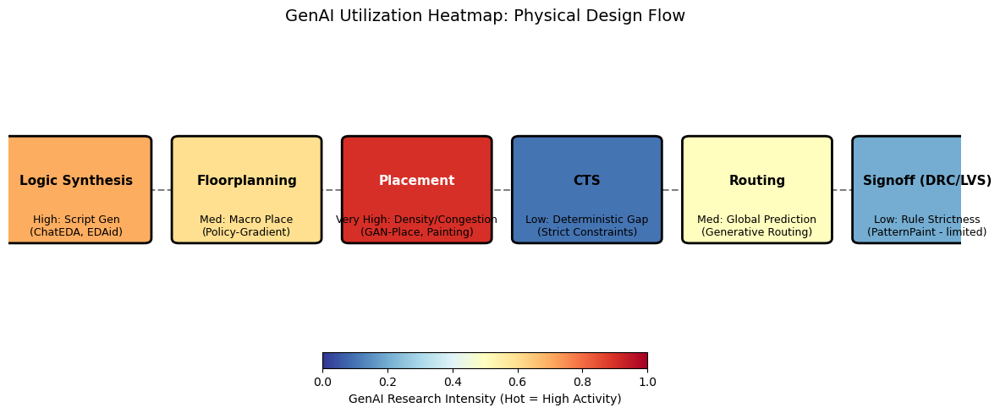

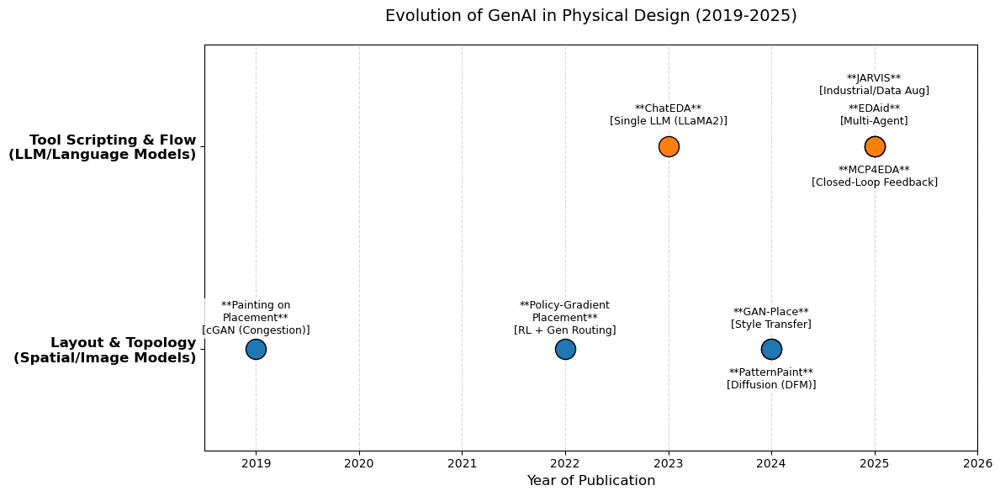

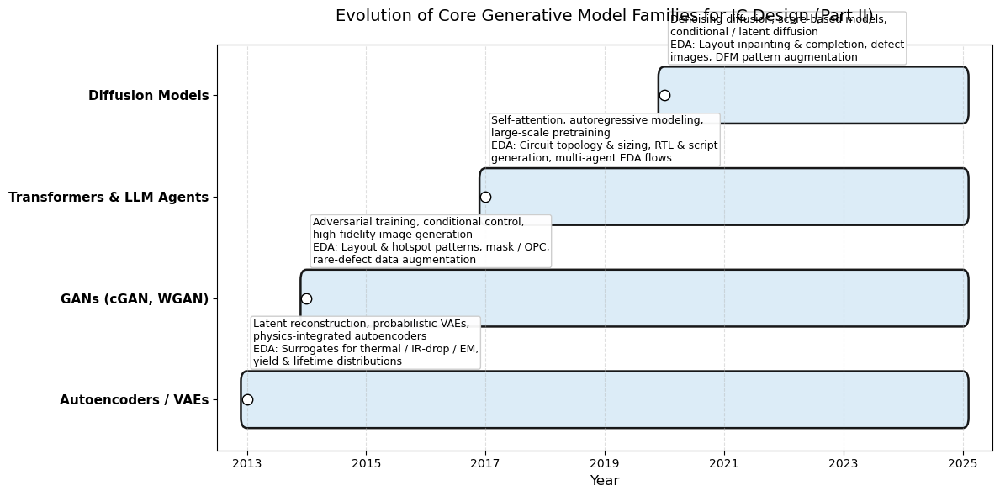

In [6]:
# GPT
import matplotlib.pyplot as plt
import matplotlib.patches as patches

plt.style.use("default")

def draw_genai_background_timeline():
    """
    Timeline of core generative model families that underpin the survey (Part II).

    X-axis: year of introduction / adoption.
    Y-axis: model families (Autoencoders, GANs, Diffusion, Transformers/LLMs).
    Each family is drawn as a horizontal bar starting at its first appearance,
    with brief annotations for: core ML idea + typical EDA artifacts.
    """

    # ---- Core data (feel free to tweak years / text) ----
    families = [
        {
            "name": "Autoencoders / VAEs",
            "y": 1,
            "start": 2013,
            "ml_note": "Latent reconstruction, probabilistic VAEs,\nphysics‑integrated autoencoders",
            "eda_note": "Surrogates for thermal / IR‑drop / EM,\nyield & lifetime distributions"
        },
        {
            "name": "GANs (cGAN, WGAN)",
            "y": 2,
            "start": 2014,
            "ml_note": "Adversarial training, conditional control,\nhigh‑fidelity image generation",
            "eda_note": "Layout & hotspot patterns, mask / OPC,\nrare‑defect data augmentation"
        },
        {
            "name": "Transformers & LLM Agents",
            "y": 3,
            "start": 2017,
            "ml_note": "Self‑attention, autoregressive modeling,\nlarge‑scale pretraining",
            "eda_note": "Circuit topology & sizing, RTL & script\ngeneration, multi‑agent EDA flows"
        },
        {
            "name": "Diffusion Models",
            "y": 4,
            "start": 2020,
            "ml_note": "Denoising diffusion, score‑based models,\nconditional / latent diffusion",
            "eda_note": "Layout inpainting & completion, defect\nimages, DFM pattern augmentation"
        },
    ]

    year_min, year_max = 2012.5, 2025.5

    fig, ax = plt.subplots(figsize=(12, 6))

    # Axes limits and labels
    ax.set_xlim(year_min, year_max)
    ax.set_ylim(0.5, 4.5)

    ax.set_yticks([f["y"] for f in families])
    ax.set_yticklabels([f["name"] for f in families], fontsize=11, fontweight="bold")

    ax.set_xlabel("Year", fontsize=12)
    ax.set_title("Evolution of Core Generative Model Families for IC Design (Part II)",
                 fontsize=14, pad=20)

    # Vertical grid for years
    ax.grid(axis="x", linestyle="--", alpha=0.4, zorder=0)

    # Draw horizontal bars and starting markers
    for fam in families:
        y = fam["y"]
        start = fam["start"]

        # Bar from start year to present
        bar = patches.FancyBboxPatch(
            (start, y - 0.18),                    # (x, y) lower-left
            year_max - start - 0.5,              # width
            0.36,                                # height
            boxstyle="round,pad=0.1",
            linewidth=1.8,
            edgecolor="black",
            facecolor="#d9eaf7",                 # soft fill; adjust if desired
            alpha=0.9,
            zorder=1,
        )
        ax.add_patch(bar)

        # Starting marker
        ax.scatter(start, y, s=80, edgecolor="black", facecolor="white", zorder=2)

        # Text block with ML + EDA notes (slightly above the bar)
        ax.text(
            start + 0.1, y + 0.32,
            f"{fam['ml_note']}\nEDA: {fam['eda_note']}",
            ha="left", va="bottom",
            fontsize=9,
            bbox=dict(boxstyle="round,pad=0.2",
                      facecolor="white", edgecolor="0.8", alpha=0.95),
        )

    # Ticks every 2 years for readability
    ax.set_xticks(range(2013, 2026, 2))

    # Tight layout for publication
    plt.tight_layout()
    plt.show()


# Generate the figure
if __name__ == "__main__":
    draw_genai_background_timeline()


Saved: genai_timeline.png and genai_timeline.pdf in current directory


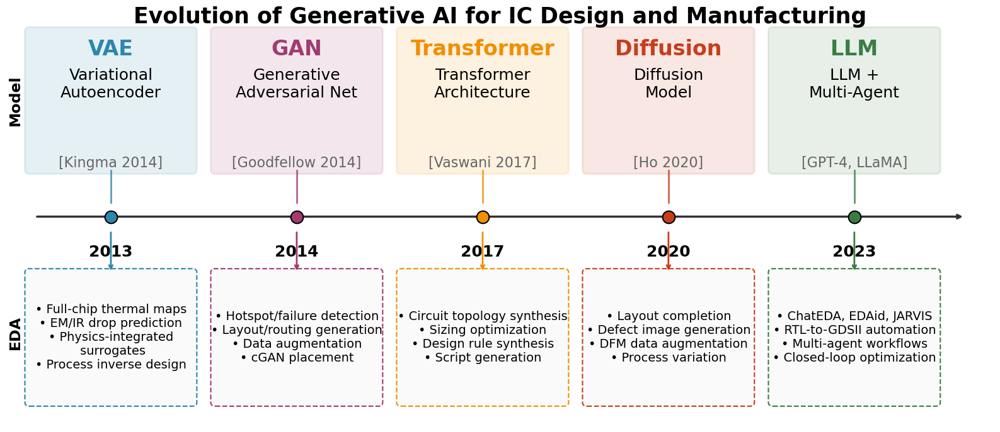

In [25]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import os

plt.rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10
plt.rcParams['axes.linewidth'] = 1.2

def draw_genai_timeline():

    fig, ax = plt.subplots(figsize=(16, 7))

    models = [
        {"pos": 1.8, "year": 2013, "name": "VAE", "color": "#2E86AB",
         "full": "Variational\nAutoencoder",
         "eda_apps": ["Full-chip thermal maps", "EM/IR drop prediction", 
                      "Physics-integrated\n surrogates", "Process inverse design"],
         "refs": "[Kingma 2014]"},
        {"pos": 5.0, "year": 2014, "name": "GAN", "color": "#A23B72",
         "full": "Generative\nAdversarial Net",
         "eda_apps": ["Hotspot/failure detection", "Layout/routing generation",
                      "Data augmentation", "cGAN placement"],
         "refs": "[Goodfellow 2014]"},
        {"pos": 8.2, "year": 2017, "name": "Transformer", "color": "#F18F01",
         "full": "Transformer\nArchitecture", 
         "eda_apps": ["Circuit topology synthesis", "Sizing optimization",
                      "Design rule synthesis", "Script generation"],
         "refs": "[Vaswani 2017]"},
        {"pos": 11.4, "year": 2020, "name": "Diffusion", "color": "#C73E1D",
         "full": "Diffusion\nModel",
         "eda_apps": ["Layout completion", "Defect image generation",
                      "DFM data augmentation", "Process variation"],
         "refs": "[Ho 2020]"},
        {"pos": 14.6, "year": 2023, "name": "LLM", "color": "#3A7D44",
         "full": "LLM +\nMulti-Agent",
         "eda_apps": ["ChatEDA, EDAid, JARVIS", "RTL-to-GDSII automation",
                      "Multi-agent workflows", "Closed-loop optimization"],
         "refs": "[GPT-4, LLaMA]"},
    ]
    
    ax.set_xlim(0, 17)
    ax.set_ylim(-0.5, 8.5)
    ax.axis('off')
    
    # Timeline arrow
    ax.annotate('', xy=(16.5, 4), xytext=(0.5, 4),
               arrowprops=dict(arrowstyle='->', color='#333333', lw=2.5))
    
    # Section labels
    ax.text(0.3, 6.5, "Model\n", ha='center', va='center', fontsize=17, 
            fontweight='bold', rotation=90)
    ax.text(0.3, 1.5, "EDA\n", ha='center', va='center', fontsize=17,
            fontweight='bold', rotation=90)

    for i, model in enumerate(models):
        x = model["pos"]
        color = model["color"]
        
        # Year marker on timeline
        ax.scatter(x, 4, s=200, c=color, edgecolors='black', linewidth=1.5, zorder=10)
        ax.text(x, 3.4, str(model["year"]), ha='center', va='top', fontsize=18, fontweight='bold')
        
        rect = patches.FancyBboxPatch((x - 1.4, 5.0), 2.8, 3.0,
                                       boxstyle="round,pad=0.08", linewidth=2,
                                       edgecolor=color, facecolor=color, alpha=0.12)
        ax.add_patch(rect)
        
        ax.text(x, 7.6, model["name"], ha='center', va='center', fontsize=24, 
                fontweight='bold', color=color)
        ax.text(x, 6.85, model["full"], ha='center', va='center', fontsize=18)
        ax.text(x, 5.15, model["refs"], ha='center', va='center', fontsize=16, color='#666666')
        
        ax.plot([x, x], [4.3, 5.0], color=color, linewidth=2, alpha=0.8)

        rect_lower = patches.FancyBboxPatch((x - 1.4, 0.0), 2.8, 2.8,
                                            boxstyle="round,pad=0.08", linewidth=1.5,
                                            edgecolor=color, facecolor='#FAFAFA', linestyle='--')
        ax.add_patch(rect_lower)

        apps_text = "\n".join([f"• {app}" for app in model["eda_apps"]])
        ax.text(x, 1.4, apps_text, ha='center', va='center', fontsize=14)

        ax.annotate('', xy=(x, 2.8), xytext=(x, 3.7),
                   arrowprops=dict(arrowstyle='->', color=color, lw=2))

    ax.text(8.5, 8.3, "Evolution of Generative AI for IC Design and Manufacturing", 
            ha='center', va='center', fontsize=25, fontweight='bold')
    
    plt.tight_layout()

    plt.savefig('genai_timeline.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.savefig('genai_timeline.pdf', bbox_inches='tight',
                facecolor='white', edgecolor='none')
    print("Saved: genai_timeline.png and genai_timeline.pdf in current directory")
    plt.show()

if __name__ == "__main__":
    draw_genai_timeline()

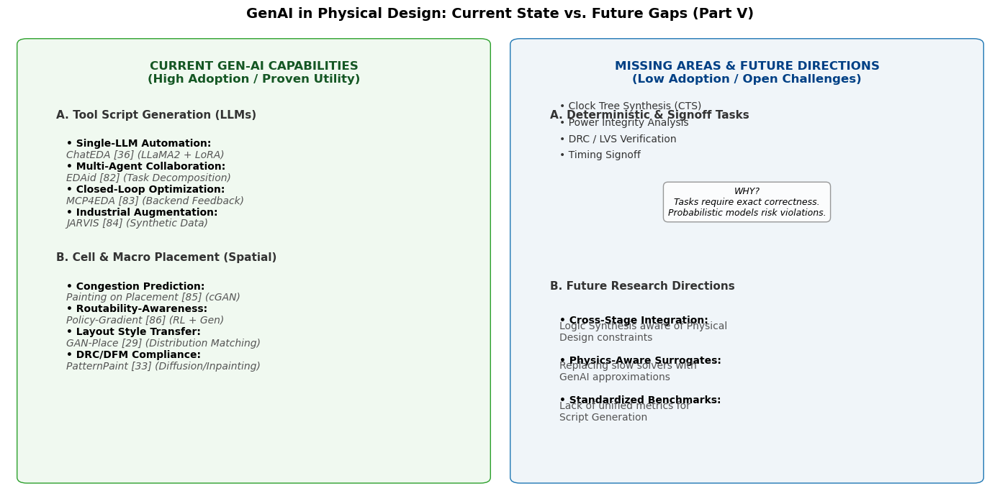

In [28]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.lines as mlines

# Set professional style
plt.style.use('default')

def draw_option_1_capability_gap_matrix():
    """
    Option 1: A structured comparison table (Left: Current Capabilities, Right: Gaps/Future).
    FIXED: Uses FancyBboxPatch instead of Rectangle to support rounded corners.
    """
    fig, ax = plt.subplots(figsize=(14, 7))
    ax.set_xlim(0, 10)
    ax.set_ylim(0, 8)
    ax.axis('off')

    # --- Background Zones ---
    # Left Zone (Current Capabilities) - Light Green Tint
    # FIXED: Changed patches.Rectangle to patches.FancyBboxPatch
    rect_left = patches.FancyBboxPatch((0.2, 0.2), 4.6, 7.6, 
                                       boxstyle="round,pad=0.1", 
                                       linewidth=1, edgecolor='#2ca02c', facecolor='#f0f9f0')
    ax.add_patch(rect_left)
    
    # Right Zone (Gaps/Future) - Light Grey/Blue Tint
    # FIXED: Changed patches.Rectangle to patches.FancyBboxPatch
    rect_right = patches.FancyBboxPatch((5.2, 0.2), 4.6, 7.6, 
                                        boxstyle="round,pad=0.1", 
                                        linewidth=1, edgecolor='#1f77b4', facecolor='#f0f5f9')
    ax.add_patch(rect_right)

    # --- Headers ---
    ax.text(2.5, 7.3, "CURRENT GEN-AI CAPABILITIES\n(High Adoption / Proven Utility)", 
            ha='center', va='center', fontsize=12, fontweight='bold', color='#155724')
    ax.text(7.5, 7.3, "MISSING AREAS & FUTURE DIRECTIONS\n(Low Adoption / Open Challenges)", 
            ha='center', va='center', fontsize=12, fontweight='bold', color='#004085')

    # --- Content: Current Capabilities (Left) ---
    # Section 1: Tool Scripting
    ax.text(0.5, 6.5, "A. Tool Script Generation (LLMs)", fontsize=11, fontweight='bold', color='#333')
    script_points = [
        ("• Single-LLM Automation", "ChatEDA [36] (LLaMA2 + LoRA)"),
        ("• Multi-Agent Collaboration", "EDAid [82] (Task Decomposition)"),
        ("• Closed-Loop Optimization", "MCP4EDA [83] (Backend Feedback)"),
        ("• Industrial Augmentation", "JARVIS [84] (Synthetic Data)")
    ]
    for i, (title, ref) in enumerate(script_points):
        ax.text(0.6, 6.0 - (i*0.4), f"{title}:", fontsize=10, fontweight='bold')
        ax.text(0.6, 5.8 - (i*0.4), ref, fontsize=10, style='italic', color='#555')

    # Section 2: Placement
    ax.text(0.5, 4.0, "B. Cell & Macro Placement (Spatial)", fontsize=11, fontweight='bold', color='#333')
    place_points = [
        ("• Congestion Prediction", "Painting on Placement [85] (cGAN)"),
        ("• Routability-Awareness", "Policy-Gradient [86] (RL + Gen)"),
        ("• Layout Style Transfer", "GAN-Place [29] (Distribution Matching)"),
        ("• DRC/DFM Compliance", "PatternPaint [33] (Diffusion/Inpainting)")
    ]
    for i, (title, ref) in enumerate(place_points):
        ax.text(0.6, 3.5 - (i*0.4), f"{title}:", fontsize=10, fontweight='bold')
        ax.text(0.6, 3.3 - (i*0.4), ref, fontsize=10, style='italic', color='#555')

    # --- Content: Gaps (Right) ---
    # Section 1: The "Cold" Zones
    ax.text(5.5, 6.5, "A. Deterministic & Signoff Tasks", fontsize=11, fontweight='bold', color='#333')
    gap_points = [
        "• Clock Tree Synthesis (CTS)",
        "• Power Integrity Analysis",
        "• DRC / LVS Verification",
        "• Timing Signoff"
    ]
    ax.text(5.6, 5.8, "\n".join(gap_points), fontsize=10, linespacing=1.8, color='#333')
    
    # The "Why" Bubble
    ax.text(7.5, 4.8, "WHY?\nTasks require exact correctness.\nProbabilistic models risk violations.", 
            ha='center', fontsize=9, style='italic', bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray', boxstyle='round,pad=0.5'))

    # Section 2: Future Trends
    ax.text(5.5, 3.5, "B. Future Research Directions", fontsize=11, fontweight='bold', color='#333')
    future_points = [
        ("• Cross-Stage Integration", "Logic Synthesis aware of Physical\nDesign constraints"),
        ("• Physics-Aware Surrogates", "Replacing slow solvers with\nGenAI approximations"),
        ("• Standardized Benchmarks", "Lack of unified metrics for\nScript Generation")
    ]
    for i, (title, desc) in enumerate(future_points):
        ax.text(5.6, 2.9 - (i*0.7), f"{title}:", fontsize=10, fontweight='bold')
        ax.text(5.6, 2.6 - (i*0.7), desc, fontsize=10, color='#555')

    plt.title("GenAI in Physical Design: Current State vs. Future Gaps (Part V)", fontsize=14, fontweight='bold', pad=15)
    plt.tight_layout()
    plt.show()

# You can run this corrected function now
draw_option_1_capability_gap_matrix()

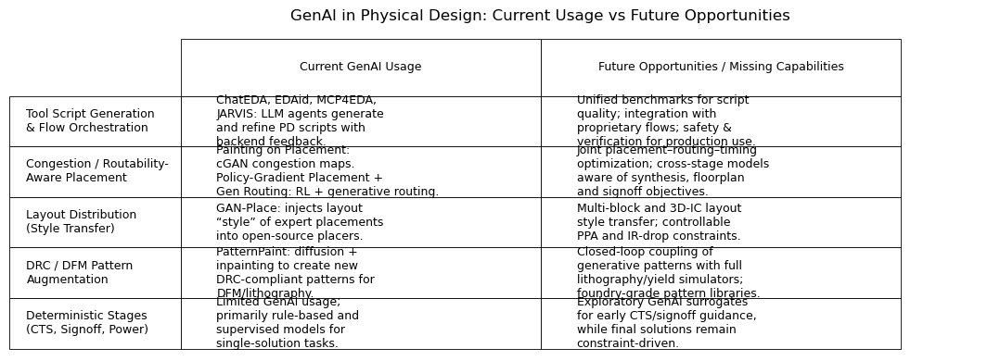

In [29]:
import matplotlib.pyplot as plt

plt.style.use("default")

def plot_pd_usage_vs_future_table():
    fig, ax = plt.subplots(figsize=(11, 4))
    ax.axis('off')

    # Row labels and concise descriptions (manually wrapped with '\n')
    rows = [
        "Tool Script Generation\n& Flow Orchestration",
        "Congestion / Routability-\nAware Placement",
        "Layout Distribution\n(Style Transfer)",
        "DRC / DFM Pattern\nAugmentation",
        "Deterministic Stages\n(CTS, Signoff, Power)"
    ]

    current_use = [
        "ChatEDA, EDAid, MCP4EDA,\nJARVIS: LLM agents generate\nand refine PD scripts with\nbackend feedback.",
        "Painting on Placement:\ncGAN congestion maps.\nPolicy-Gradient Placement +\nGen Routing: RL + generative routing.",
        "GAN-Place: injects layout\n“style” of expert placements\ninto open-source placers.",
        "PatternPaint: diffusion +\ninpainting to create new\nDRC-compliant patterns for\nDFM/lithography.",
        "Limited GenAI usage;\nprimarily rule-based and\nsupervised models for\nsingle-solution tasks."
    ]

    future_use = [
        "Unified benchmarks for script\nquality; integration with\nproprietary flows; safety &\nverification for production use.",
        "Joint placement–routing–timing\noptimization; cross-stage models\naware of synthesis, floorplan\nand signoff objectives.",
        "Multi-block and 3D-IC layout\nstyle transfer; controllable\nPPA and IR-drop constraints.",
        "Closed-loop coupling of\ngenerative patterns with full\nlithography/yield simulators;\nfoundry-grade pattern libraries.",
        "Exploratory GenAI surrogates\nfor early CTS/signoff guidance,\nwhile final solutions remain\nconstraint-driven."
    ]

    cell_text = list(zip(current_use, future_use))
    col_labels = ["Current GenAI Usage", "Future Opportunities / Missing Capabilities"]

    table = ax.table(
        cellText=cell_text,
        rowLabels=rows,
        colLabels=col_labels,
        loc='center',
        cellLoc='left'
    )

    table.auto_set_font_size(False)
    table.set_fontsize(9)

    # Adjust column widths
    for (row, col), cell in table.get_celld().items():
        cell.set_linewidth(0.6)
        if row == 0:
            cell.set_height(0.18)
        else:
            cell.set_height(0.16)
        if col == -1:  # row labels
            cell.set_width(0.20)
            cell.set_fontsize(9)
        else:
            cell.set_width(0.40)

    plt.title("GenAI in Physical Design: Current Usage vs Future Opportunities",
              fontsize=12, pad=12)
    plt.tight_layout()
    plt.show()

# Call function
plot_pd_usage_vs_future_table()


Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


Saved Sunburst_GenAI_Usage.pdf and .png


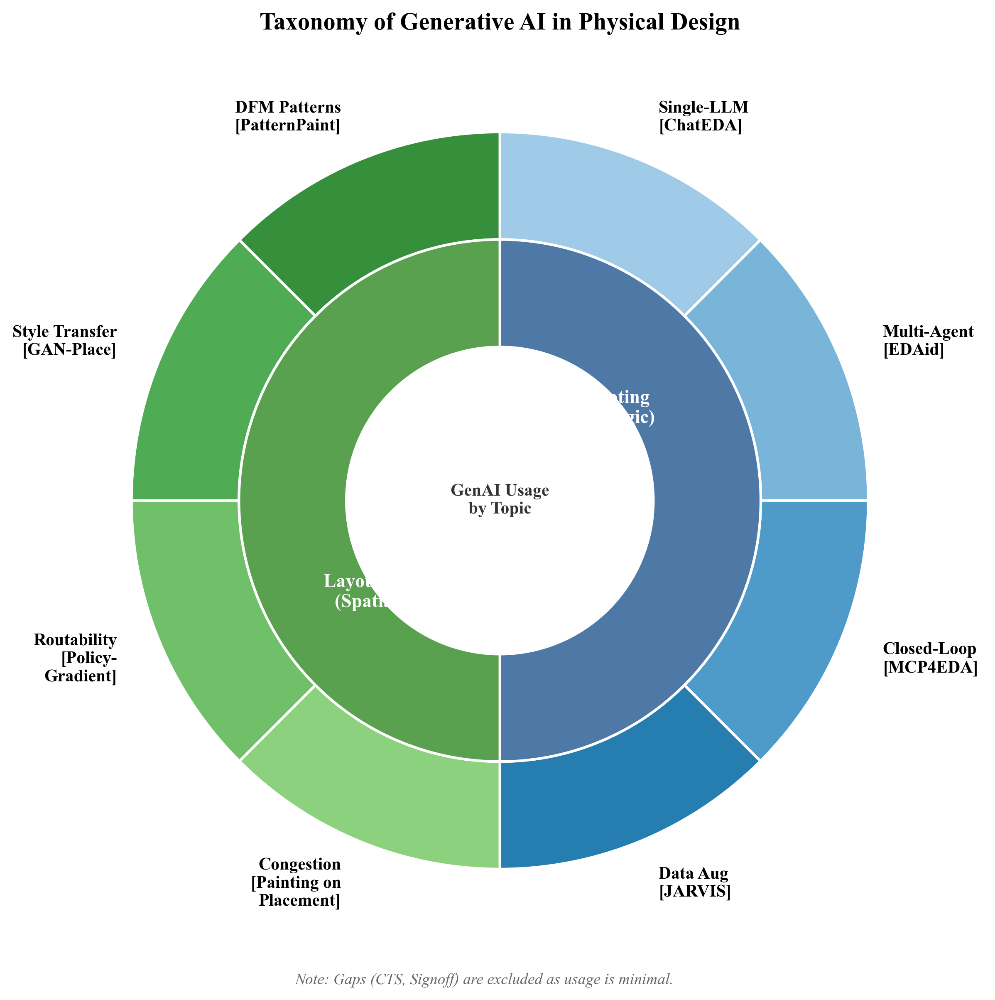

In [5]:
import matplotlib.pyplot as plt
import numpy as np

# --- PUBLICATION STYLE SETTINGS ---
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman', 'DejaVu Serif'],
    'font.size': 11,
    'figure.dpi': 300,
    'savefig.bbox': 'tight'
})

def draw_sunburst_part_v():
    """
    Creates a professional Sunburst/Nested Donut chart for Part V of the review paper.
    Visualizes the hierarchy of GenAI usage in Physical Design based on the 
    brainstorming tree: Domain -> Method -> Paper.
    """
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.axis('equal')

    # --- DATA HIERARCHY (Based on Step 2 Tree) ---
    
    # BRANCH 1: Tool Scripting (Code/Logic)
    # Color Palette: Professional Blues
    branch1_name = "Tool Scripting\n(Code & Logic)"
    branch1_color = '#4e79a7' # Main Muted Blue
    branch1_subs = [
        # (Size, Method Label, Paper Label, Color Shade)
        (1, "Single-LLM", "ChatEDA", '#a0cbe8'),      # Light Blue
        (1, "Multi-Agent", "EDAid", '#78b5d9'),       # Med-Light Blue
        (1, "Closed-Loop", "MCP4EDA", '#4e9bc9'),     # Med Blue
        (1, "Data Aug", "JARVIS", '#267daf')          # Darker Blue
    ]

    # BRANCH 2: Layout & Placement (Spatial/Image)
    # Color Palette: Professional Greens
    branch2_name = "Layout & Placement\n(Spatial & Image)"
    branch2_color = '#59a14f' # Main Muted Green
    branch2_subs = [
        # (Size, Method Label, Paper Label, Color Shade)
        (1, "Congestion", "Painting on\nPlacement", '#8cd17d'), # Light Green
        (1, "Routability", "Policy-\nGradient", '#6fc068'),     # Med-Light Green
        (1, "Style Transfer", "GAN-Place", '#4fac54'),          # Med Green
        (1, "DFM Patterns", "PatternPaint", '#368f3a')          # Darker Green
    ]

    # --- PREPARE PLOTTING DATA ---
    
    # Inner Ring (The Branches)
    size_inner = [len(branch1_subs), len(branch2_subs)]
    colors_inner = [branch1_color, branch2_color]
    labels_inner = [branch1_name, branch2_name]

    # Outer Ring (The Methods & Papers)
    # Flattening the list
    all_subs = branch1_subs + branch2_subs
    size_outer = [x[0] for x in all_subs]
    colors_outer = [x[3] for x in all_subs]
    # We combine Method + Paper for the label to be concise
    labels_outer = [f"{x[1]}\n[{x[2]}]" for x in all_subs]

    # --- PLOTTING ---
    
    # Ring 1: Outer (Methods & Papers)
    # Radius 1.2 -> 0.85
    wedges_out, texts_out = ax.pie(size_outer, radius=1.2, colors=colors_outer, 
                                   startangle=90, counterclock=False,
                                   wedgeprops=dict(width=0.35, edgecolor='white', linewidth=1.5))

    # Ring 2: Inner (Branches)
    # Radius 0.85 -> 0.5 (Donut hole size 0.5)
    wedges_in, texts_in = ax.pie(size_inner, radius=0.85, colors=colors_inner, 
                                 startangle=90, counterclock=False,
                                 wedgeprops=dict(width=0.35, edgecolor='white', linewidth=1.5))

    # --- ANNOTATIONS ---
    
    # Inner Labels (Branches)
    # Manually place them for perfect centering
    ax.text(0.3, 0.3, branch1_name, ha='center', va='center', fontsize=11, fontweight='bold', color='white')
    ax.text(-0.3, -0.3, branch2_name, ha='center', va='center', fontsize=11, fontweight='bold', color='white')

    # Outer Labels (Methods/Papers)
    for i, p in enumerate(wedges_out):
        ang = (p.theta2 - p.theta1)/2. + p.theta1
        # Push text slightly out (1.35x radius)
        y = np.sin(np.deg2rad(ang)) * 1.35
        x = np.cos(np.deg2rad(ang)) * 1.35
        
        # Smart alignment based on side
        ha_val = "left" if x > 0 else "right"
        
        # Add the label
        ax.text(x, y, labels_outer[i], ha=ha_val, va='center', 
                fontsize=10, fontweight='bold', color='black',
                bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.85))
        
        # Optional: Add faint lines connecting label to wedge if needed
        # (Skipped here to keep it clean, but can be added if text is far)

    # Center Title (Inside the Donut Hole)
    # Adding a white circle to ensure clean background
    center_circle = plt.Circle((0,0), 0.5, fc='white')
    ax.add_artist(center_circle)
    ax.text(0, 0, "GenAI Usage\nby Topic", ha='center', va='center', fontsize=10, fontweight='bold', color='#333')

    # Main Title
    plt.title("Taxonomy of Generative AI in Physical Design", fontsize=14, fontweight='bold', y=1.1)
    
    # Gap Note (The "Missing" Data)
    plt.figtext(0.5, 0.01, "Note: Gaps (CTS, Signoff) are excluded as usage is minimal.", 
                ha="center", fontsize=9, style='italic', color='#666')

    # Save
    plt.savefig("Sunburst_GenAI_Usage.pdf", format='pdf', bbox_inches='tight')
    plt.savefig("Sunburst_GenAI_Usage.png", format='png', dpi=300, bbox_inches='tight')
    print("Saved Sunburst_GenAI_Usage.pdf and .png")
    plt.show()

# Run the function
draw_sunburst_part_v()

Generating Sunburst with Gaps (No branches = No GenAI usage)

1. Color version...
Saved: fig_sunburst_gaps.pdf/.png


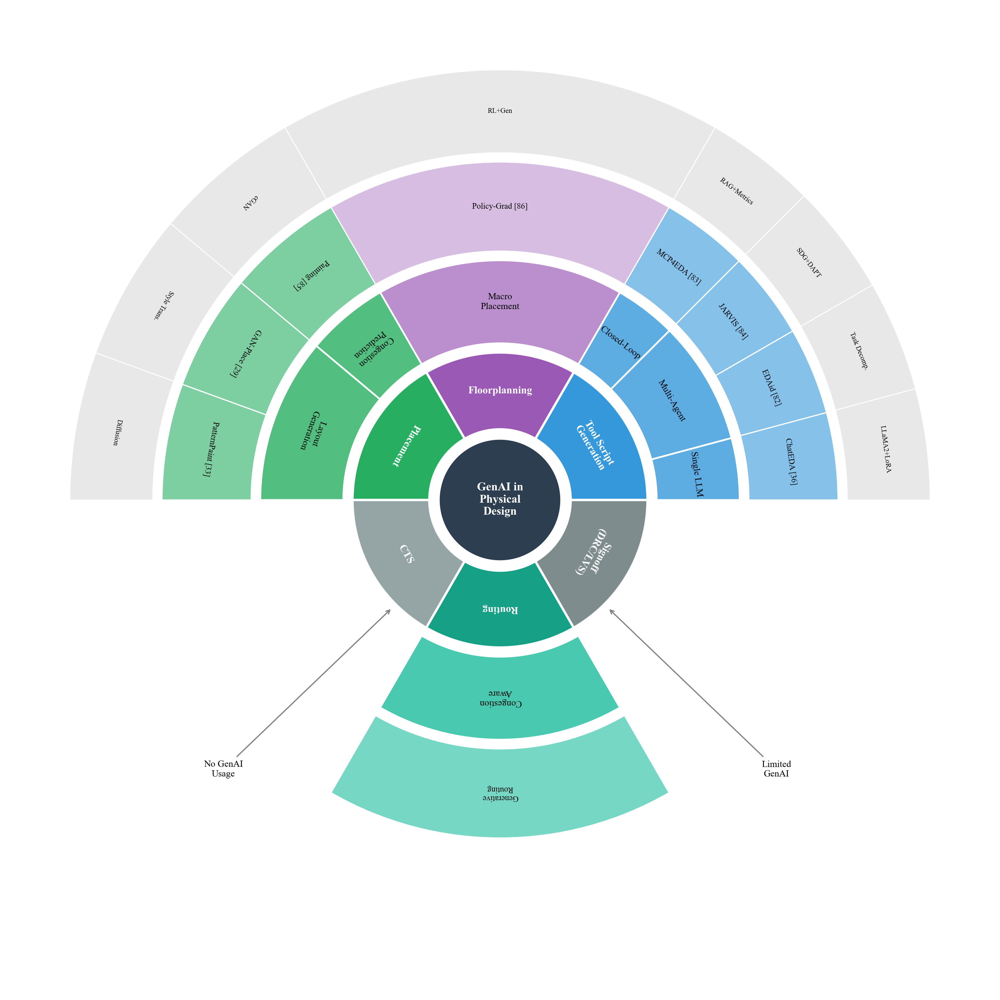


2. B&W version...
Saved: fig_sunburst_gaps_bw.pdf/.png


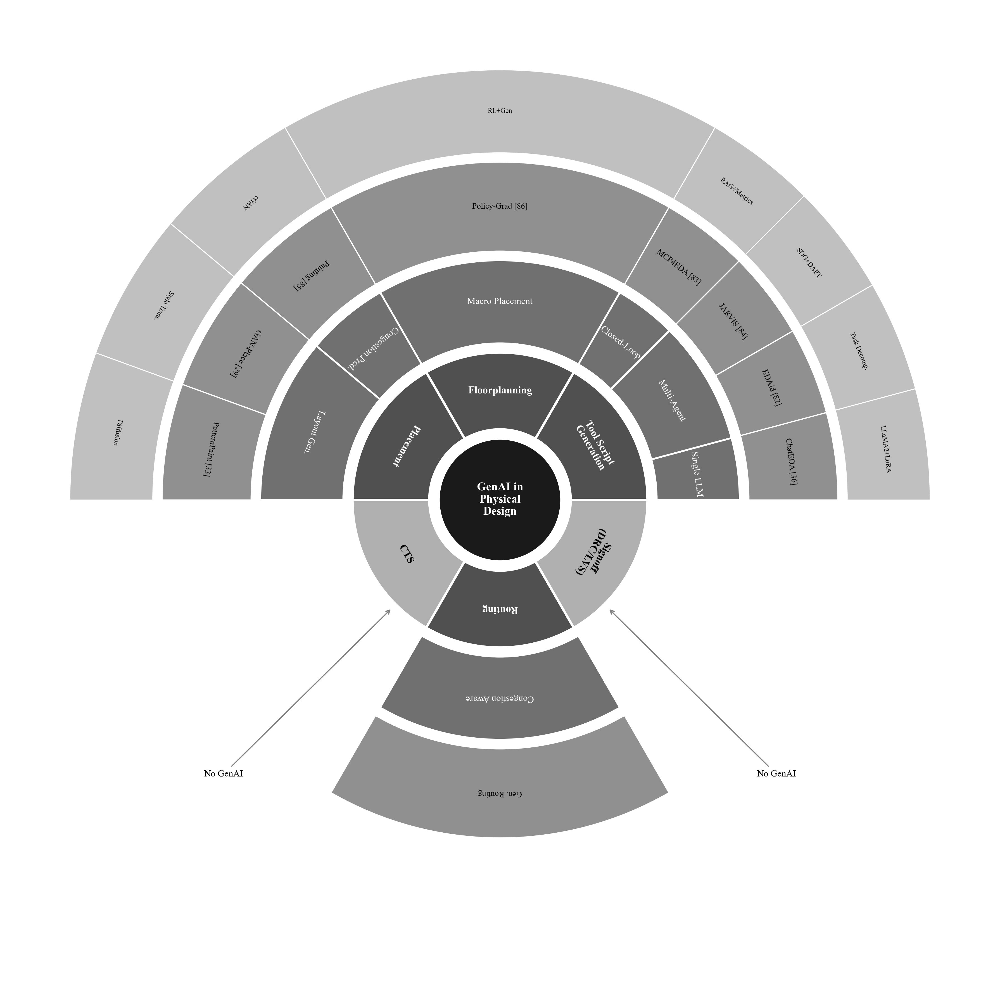


Done!


In [9]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

# =============================================================================
# ACADEMIC STYLE
# =============================================================================
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_sunburst_with_gaps():
    """
    Sunburst chart showing ALL Physical Design stages.
    - Stages WITH GenAI usage: have branches extending outward
    - Stages WITHOUT GenAI usage: only inner ring, no branches (visual gap)
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII
    # =========================================================================
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48   # Ring 1: PD Stages
    r2_in, r2_out = 0.51, 0.78   # Ring 2: Subcategories
    r3_in, r3_out = 0.81, 1.10   # Ring 3: Methods
    r4_in, r4_out = 1.13, 1.40   # Ring 4: Details
    
    # =========================================================================
    # COLORS - Each PD stage gets a unique color
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        # Tool Script - Blue
        'script': '#3498DB',
        'script_l1': '#5DADE2',
        'script_l2': '#85C1E9',
        'script_l3': '#AED6F1',
        # Placement - Green
        'place': '#27AE60',
        'place_l1': '#52BE80',
        'place_l2': '#7DCEA0',
        'place_l3': '#A9DFBF',
        # CTS - Gray (no usage)
        'cts': '#95A5A6',
        # Routing - Teal
        'routing': '#16A085',
        'routing_l1': '#48C9B0',
        'routing_l2': '#76D7C4',
        # Signoff - Gray (limited usage)
        'signoff': '#7F8C8D',
        # Floorplan - Purple
        'floorplan': '#9B59B6',
        'floorplan_l1': '#BB8FCE',
    }
    
    # =========================================================================
    # DATA: All Physical Design Stages
    # Stages with 'subcats' = have GenAI usage (branches extend)
    # Stages without 'subcats' = no GenAI usage (no branches)
    # =========================================================================
    
    # Equal angular division for 6 stages
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0,
            'end': stage_angle,
            'color': colors['script'],
            'has_usage': True,
            'subcats': [
                {
                    'name': 'Single LLM',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Multi-Agent',
                    'count': 2,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'EDAid [82]', 'detail': 'Task Decomp.', 'color': colors['script_l2']},
                        {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Closed-Loop',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics', 'color': colors['script_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle,
            'end': stage_angle * 2,
            'color': colors['floorplan'],
            'has_usage': True,
            'subcats': [
                {
                    'name': 'Macro\nPlacement',
                    'count': 1,
                    'color': colors['floorplan_l1'],
                    'methods': [
                        {'name': 'Policy-Grad [86]', 'detail': 'RL+Gen', 'color': '#D7BDE2'}
                    ]
                },
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 2,
            'end': stage_angle * 3,
            'color': colors['place'],
            'has_usage': True,
            'subcats': [
                {
                    'name': 'Congestion\nPrediction',
                    'count': 1,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'Painting [85]', 'detail': 'cGAN', 'color': colors['place_l2']}
                    ]
                },
                {
                    'name': 'Layout\nGeneration',
                    'count': 2,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'GAN-Place [29]', 'detail': 'Style Trans.', 'color': colors['place_l2']},
                        {'name': 'PatternPaint [33]', 'detail': 'Diffusion', 'color': colors['place_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3,
            'end': stage_angle * 4,
            'color': colors['cts'],
            'has_usage': False,  # NO GenAI usage - will show empty
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4,
            'end': stage_angle * 5,
            'color': colors['routing'],
            'has_usage': True,
            'subcats': [
                {
                    'name': 'Congestion\nAware',
                    'count': 1,
                    'color': colors['routing_l1'],
                    'methods': [
                        {'name': 'Generative\nRouting', 'detail': '', 'color': colors['routing_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 5,
            'end': 360,
            'color': colors['signoff'],
            'has_usage': False,  # NO GenAI usage - will show empty
            'subcats': []
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # =========================================================================
    # DRAW RINGS
    # =========================================================================
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        
        # ----- RING 1: PD Stage (always drawn) -----
        wedge1 = patches.Wedge(
            (0, 0), r1_out, stage_start, stage_end,
            width=r1_out - r1_in,
            facecolor=stage['color'],
            edgecolor='white', linewidth=2
        )
        ax.add_patch(wedge1)
        
        # Label for Ring 1
        mid_angle_rad = np.radians((stage_start + stage_end) / 2)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        
        text_angle = (stage_start + stage_end) / 2
        if 90 < text_angle < 270:
            text_angle += 180
        
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color='white',
                rotation=text_angle - 90)
        
        # ----- ONLY draw outer rings if stage has GenAI usage -----
        if not stage['has_usage'] or not stage['subcats']:
            continue  # Skip to next stage - no branches for this one
        
        # Calculate subcategory angles proportionally
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # ----- RING 2: Subcategory -----
            wedge2 = patches.Wedge(
                (0, 0), r2_out, sub_start, sub_end,
                width=r2_out - r2_in,
                facecolor=subcat['color'],
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            # Label for Ring 2
            mid_angle_rad = np.radians((sub_start + sub_end) / 2)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            
            text_angle = (sub_start + sub_end) / 2
            if 90 < text_angle < 270:
                text_angle += 180
            
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='black', rotation=text_angle - 90)
            
            # ----- RING 3: Methods -----
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge(
                    (0, 0), r3_out, m_start, m_end,
                    width=r3_out - r3_in,
                    facecolor=method['color'],
                    edgecolor='white', linewidth=1
                )
                ax.add_patch(wedge3)
                
                # Label for Ring 3
                mid_angle_rad = np.radians((m_start + m_end) / 2)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                
                text_angle = (m_start + m_end) / 2
                if 90 < text_angle < 270:
                    text_angle += 180
                
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_angle - 90)
                
                # ----- RING 4: Detail (if exists) -----
                if method['detail']:
                    # Lighter shade for details
                    detail_color = method['color']
                    # Make it lighter
                    
                    wedge4 = patches.Wedge(
                        (0, 0), r4_out, m_start, m_end,
                        width=r4_out - r4_in,
                        facecolor='#E8E8E8',
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge4)
                    
                    mid_angle_rad = np.radians((m_start + m_end) / 2)
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_angle - 90)
            
            current_angle = sub_end
    
    # =========================================================================
    # Add annotation for empty stages
    # =========================================================================
    # Arrow pointing to CTS
    ax.annotate('No GenAI\nUsage', 
                xy=(-0.35, -0.35), xytext=(-0.9, -0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    # Arrow pointing to Signoff
    ax.annotate('Limited\nGenAI', 
                xy=(0.35, -0.35), xytext=(0.9, -0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_gaps.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_gaps.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_gaps.pdf/.png")
    plt.show()


def draw_sunburst_gaps_bw():
    """
    Black & white version showing gaps.
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # Ring radii
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48
    r2_in, r2_out = 0.51, 0.78
    r3_in, r3_out = 0.81, 1.10
    r4_in, r4_out = 1.13, 1.40
    
    # Grayscale
    grays = {
        'center': '#1a1a1a',
        'used': '#505050',      # Stages with usage - darker
        'unused': '#B0B0B0',    # Stages without usage - lighter
        'l1': '#707070',
        'l2': '#909090',
        'l3': '#C0C0C0',
    }
    
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0, 'end': stage_angle,
            'color': grays['used'],
            'has_usage': True,
            'subcats': [
                {'name': 'Single LLM', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA'}]},
                {'name': 'Multi-Agent', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'EDAid [82]', 'detail': 'Task Decomp.'},
                            {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT'}]},
                {'name': 'Closed-Loop', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics'}]},
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle, 'end': stage_angle * 2,
            'color': grays['used'],
            'has_usage': True,
            'subcats': [
                {'name': 'Macro Placement', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Policy-Grad [86]', 'detail': 'RL+Gen'}]},
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 2, 'end': stage_angle * 3,
            'color': grays['used'],
            'has_usage': True,
            'subcats': [
                {'name': 'Congestion Pred.', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Painting [85]', 'detail': 'cGAN'}]},
                {'name': 'Layout Gen.', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'GAN-Place [29]', 'detail': 'Style Trans.'},
                            {'name': 'PatternPaint [33]', 'detail': 'Diffusion'}]},
            ]
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3, 'end': stage_angle * 4,
            'color': grays['unused'],
            'has_usage': False,
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4, 'end': stage_angle * 5,
            'color': grays['used'],
            'has_usage': True,
            'subcats': [
                {'name': 'Congestion Aware', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Gen. Routing', 'detail': ''}]},
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 5, 'end': 360,
            'color': grays['unused'],
            'has_usage': False,
            'subcats': []
        },
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # Draw rings
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        
        # Ring 1
        wedge1 = patches.Wedge((0, 0), r1_out, stage_start, stage_end,
                                width=r1_out - r1_in, facecolor=stage['color'],
                                edgecolor='white', linewidth=2)
        ax.add_patch(wedge1)
        
        mid_angle_rad = np.radians((stage_start + stage_end) / 2)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        text_angle = (stage_start + stage_end) / 2
        if 90 < text_angle < 270:
            text_angle += 180
        
        text_color = 'white' if stage['has_usage'] else 'black'
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color=text_color,
                rotation=text_angle - 90)
        
        if not stage['has_usage'] or not stage['subcats']:
            continue
        
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # Ring 2
            wedge2 = patches.Wedge((0, 0), r2_out, sub_start, sub_end,
                                    width=r2_out - r2_in, facecolor=subcat['color'],
                                    edgecolor='white', linewidth=1.5)
            ax.add_patch(wedge2)
            
            mid_angle_rad = np.radians((sub_start + sub_end) / 2)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            text_angle = (sub_start + sub_end) / 2
            if 90 < text_angle < 270:
                text_angle += 180
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='white', rotation=text_angle - 90)
            
            # Ring 3
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge((0, 0), r3_out, m_start, m_end,
                                        width=r3_out - r3_in, facecolor=grays['l2'],
                                        edgecolor='white', linewidth=1)
                ax.add_patch(wedge3)
                
                mid_angle_rad = np.radians((m_start + m_end) / 2)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                text_angle = (m_start + m_end) / 2
                if 90 < text_angle < 270:
                    text_angle += 180
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_angle - 90)
                
                # Ring 4
                if method['detail']:
                    wedge4 = patches.Wedge((0, 0), r4_out, m_start, m_end,
                                            width=r4_out - r4_in, facecolor=grays['l3'],
                                            edgecolor='white', linewidth=0.8)
                    ax.add_patch(wedge4)
                    
                    mid_angle_rad = np.radians((m_start + m_end) / 2)
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_angle - 90)
            
            current_angle = sub_end
    
    # Annotations
    ax.annotate('No GenAI', xy=(-0.35, -0.35), xytext=(-0.9, -0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    ax.annotate('No GenAI', xy=(0.35, -0.35), xytext=(0.9, -0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_gaps_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_gaps_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_gaps_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*60)
    print("Generating Sunburst with Gaps (No branches = No GenAI usage)")
    print("="*60)
    
    print("\n1. Color version...")
    draw_sunburst_with_gaps()
    
    print("\n2. B&W version...")
    draw_sunburst_gaps_bw()
    
    print("\nDone!")

Sunburst V2: Swapped Signoff/Placement, Reversed Routing text

1. Color version...
Saved: fig_sunburst_v2.pdf/.png


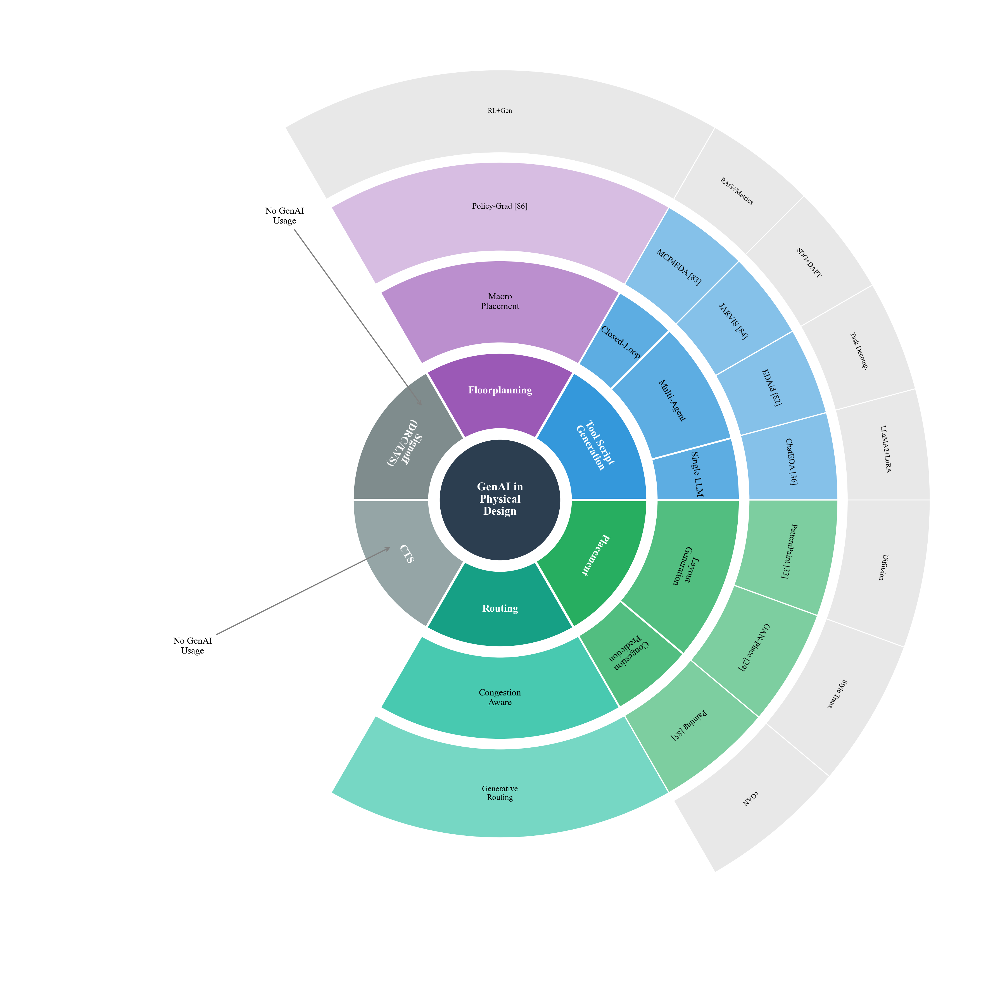


2. B&W version...
Saved: fig_sunburst_v2_bw.pdf/.png


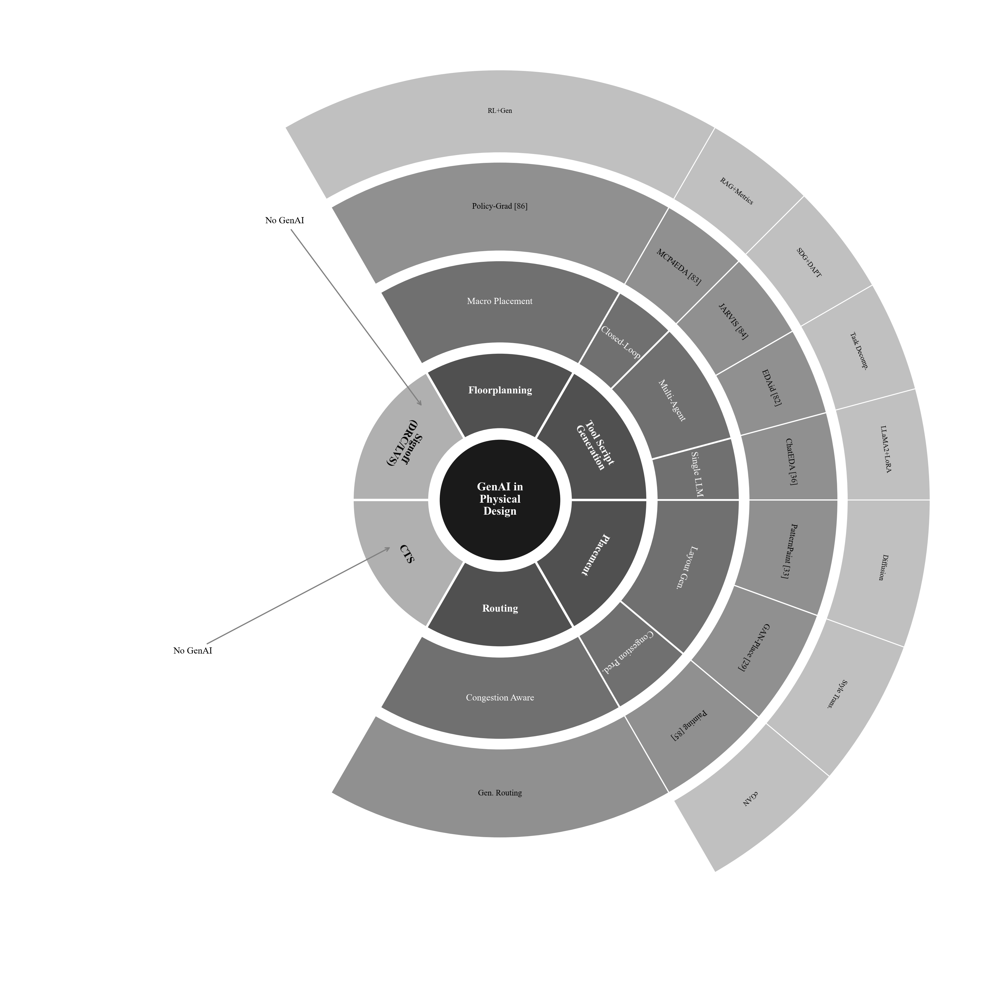


Done!


In [10]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

# =============================================================================
# ACADEMIC STYLE
# =============================================================================
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_sunburst_with_gaps():
    """
    Sunburst chart showing ALL Physical Design stages.
    - Swapped: Signoff and Placement positions
    - Reversed text orientation in Routing section
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII
    # =========================================================================
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48   # Ring 1: PD Stages
    r2_in, r2_out = 0.51, 0.78   # Ring 2: Subcategories
    r3_in, r3_out = 0.81, 1.10   # Ring 3: Methods
    r4_in, r4_out = 1.13, 1.40   # Ring 4: Details
    
    # =========================================================================
    # COLORS
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        # Tool Script - Blue
        'script': '#3498DB',
        'script_l1': '#5DADE2',
        'script_l2': '#85C1E9',
        'script_l3': '#AED6F1',
        # Placement - Green
        'place': '#27AE60',
        'place_l1': '#52BE80',
        'place_l2': '#7DCEA0',
        'place_l3': '#A9DFBF',
        # CTS - Gray (no usage)
        'cts': '#95A5A6',
        # Routing - Teal
        'routing': '#16A085',
        'routing_l1': '#48C9B0',
        'routing_l2': '#76D7C4',
        # Signoff - Gray (limited usage)
        'signoff': '#7F8C8D',
        # Floorplan - Purple
        'floorplan': '#9B59B6',
        'floorplan_l1': '#BB8FCE',
    }
    
    # =========================================================================
    # DATA: All Physical Design Stages
    # ORDER: Tool Script, Floorplanning, Signoff(swapped), CTS, Routing, Placement(swapped)
    # =========================================================================
    
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0,
            'end': stage_angle,
            'color': colors['script'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {
                    'name': 'Single LLM',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Multi-Agent',
                    'count': 2,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'EDAid [82]', 'detail': 'Task Decomp.', 'color': colors['script_l2']},
                        {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Closed-Loop',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics', 'color': colors['script_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle,
            'end': stage_angle * 2,
            'color': colors['floorplan'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {
                    'name': 'Macro\nPlacement',
                    'count': 1,
                    'color': colors['floorplan_l1'],
                    'methods': [
                        {'name': 'Policy-Grad [86]', 'detail': 'RL+Gen', 'color': '#D7BDE2'}
                    ]
                },
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 2,
            'end': stage_angle * 3,
            'color': colors['signoff'],
            'has_usage': False,  # NO GenAI usage
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3,
            'end': stage_angle * 4,
            'color': colors['cts'],
            'has_usage': False,  # NO GenAI usage
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4,
            'end': stage_angle * 5,
            'color': colors['routing'],
            'has_usage': True,
            'reverse_text': True,  # REVERSE TEXT ORIENTATION
            'subcats': [
                {
                    'name': 'Congestion\nAware',
                    'count': 1,
                    'color': colors['routing_l1'],
                    'methods': [
                        {'name': 'Generative\nRouting', 'detail': '', 'color': colors['routing_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 5,
            'end': 360,
            'color': colors['place'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {
                    'name': 'Congestion\nPrediction',
                    'count': 1,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'Painting [85]', 'detail': 'cGAN', 'color': colors['place_l2']}
                    ]
                },
                {
                    'name': 'Layout\nGeneration',
                    'count': 2,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'GAN-Place [29]', 'detail': 'Style Trans.', 'color': colors['place_l2']},
                        {'name': 'PatternPaint [33]', 'detail': 'Diffusion', 'color': colors['place_l2']}
                    ]
                },
            ]
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # =========================================================================
    # Helper function for text rotation
    # =========================================================================
    def get_text_angle(angle, reverse=False):
        """Calculate text rotation angle, with optional reversal."""
        text_angle = angle
        if reverse:
            # Reverse the normal logic
            if not (90 < angle < 270):
                text_angle += 180
        else:
            # Normal logic
            if 90 < angle < 270:
                text_angle += 180
        return text_angle - 90
    
    # =========================================================================
    # DRAW RINGS
    # =========================================================================
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        reverse = stage['reverse_text']
        
        # ----- RING 1: PD Stage (always drawn) -----
        wedge1 = patches.Wedge(
            (0, 0), r1_out, stage_start, stage_end,
            width=r1_out - r1_in,
            facecolor=stage['color'],
            edgecolor='white', linewidth=2
        )
        ax.add_patch(wedge1)
        
        # Label for Ring 1
        mid_angle = (stage_start + stage_end) / 2
        mid_angle_rad = np.radians(mid_angle)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        
        text_rotation = get_text_angle(mid_angle, reverse)
        
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color='white',
                rotation=text_rotation)
        
        # ----- ONLY draw outer rings if stage has GenAI usage -----
        if not stage['has_usage'] or not stage['subcats']:
            continue
        
        # Calculate subcategory angles proportionally
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # ----- RING 2: Subcategory -----
            wedge2 = patches.Wedge(
                (0, 0), r2_out, sub_start, sub_end,
                width=r2_out - r2_in,
                facecolor=subcat['color'],
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            # Label for Ring 2
            mid_angle = (sub_start + sub_end) / 2
            mid_angle_rad = np.radians(mid_angle)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            
            text_rotation = get_text_angle(mid_angle, reverse)
            
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='black', rotation=text_rotation)
            
            # ----- RING 3: Methods -----
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge(
                    (0, 0), r3_out, m_start, m_end,
                    width=r3_out - r3_in,
                    facecolor=method['color'],
                    edgecolor='white', linewidth=1
                )
                ax.add_patch(wedge3)
                
                # Label for Ring 3
                mid_angle = (m_start + m_end) / 2
                mid_angle_rad = np.radians(mid_angle)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                
                text_rotation = get_text_angle(mid_angle, reverse)
                
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_rotation)
                
                # ----- RING 4: Detail (if exists) -----
                if method['detail']:
                    wedge4 = patches.Wedge(
                        (0, 0), r4_out, m_start, m_end,
                        width=r4_out - r4_in,
                        facecolor='#E8E8E8',
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge4)
                    
                    mid_angle_rad = np.radians(mid_angle)
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_rotation)
            
            current_angle = sub_end
    
    # =========================================================================
    # Add annotation for empty stages
    # =========================================================================
    # Arrow pointing to Signoff (now at position 2)
    ax.annotate('No GenAI\nUsage', 
                xy=(-0.25, 0.30), xytext=(-0.7, 0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    # Arrow pointing to CTS (position 3)
    ax.annotate('No GenAI\nUsage', 
                xy=(-0.35, -0.15), xytext=(-1.0, -0.5),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_v2.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_v2.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_v2.pdf/.png")
    plt.show()


def draw_sunburst_v2_bw():
    """
    Black & white version with swapped positions and reversed routing text.
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # Ring radii
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48
    r2_in, r2_out = 0.51, 0.78
    r3_in, r3_out = 0.81, 1.10
    r4_in, r4_out = 1.13, 1.40
    
    # Grayscale
    grays = {
        'center': '#1a1a1a',
        'used': '#505050',
        'unused': '#B0B0B0',
        'l1': '#707070',
        'l2': '#909090',
        'l3': '#C0C0C0',
    }
    
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0, 'end': stage_angle,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {'name': 'Single LLM', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA'}]},
                {'name': 'Multi-Agent', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'EDAid [82]', 'detail': 'Task Decomp.'},
                            {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT'}]},
                {'name': 'Closed-Loop', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics'}]},
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle, 'end': stage_angle * 2,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {'name': 'Macro Placement', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Policy-Grad [86]', 'detail': 'RL+Gen'}]},
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 2, 'end': stage_angle * 3,
            'color': grays['unused'],
            'has_usage': False,
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3, 'end': stage_angle * 4,
            'color': grays['unused'],
            'has_usage': False,
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4, 'end': stage_angle * 5,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': True,  # REVERSE
            'subcats': [
                {'name': 'Congestion Aware', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Gen. Routing', 'detail': ''}]},
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 5, 'end': 360,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {'name': 'Congestion Pred.', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Painting [85]', 'detail': 'cGAN'}]},
                {'name': 'Layout Gen.', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'GAN-Place [29]', 'detail': 'Style Trans.'},
                            {'name': 'PatternPaint [33]', 'detail': 'Diffusion'}]},
            ]
        },
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    def get_text_angle(angle, reverse=False):
        text_angle = angle
        if reverse:
            if not (90 < angle < 270):
                text_angle += 180
        else:
            if 90 < angle < 270:
                text_angle += 180
        return text_angle - 90
    
    # Draw rings
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        reverse = stage['reverse_text']
        
        # Ring 1
        wedge1 = patches.Wedge((0, 0), r1_out, stage_start, stage_end,
                                width=r1_out - r1_in, facecolor=stage['color'],
                                edgecolor='white', linewidth=2)
        ax.add_patch(wedge1)
        
        mid_angle = (stage_start + stage_end) / 2
        mid_angle_rad = np.radians(mid_angle)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        text_rotation = get_text_angle(mid_angle, reverse)
        
        text_color = 'white' if stage['has_usage'] else 'black'
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color=text_color,
                rotation=text_rotation)
        
        if not stage['has_usage'] or not stage['subcats']:
            continue
        
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # Ring 2
            wedge2 = patches.Wedge((0, 0), r2_out, sub_start, sub_end,
                                    width=r2_out - r2_in, facecolor=subcat['color'],
                                    edgecolor='white', linewidth=1.5)
            ax.add_patch(wedge2)
            
            mid_angle = (sub_start + sub_end) / 2
            mid_angle_rad = np.radians(mid_angle)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            text_rotation = get_text_angle(mid_angle, reverse)
            
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='white', rotation=text_rotation)
            
            # Ring 3
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge((0, 0), r3_out, m_start, m_end,
                                        width=r3_out - r3_in, facecolor=grays['l2'],
                                        edgecolor='white', linewidth=1)
                ax.add_patch(wedge3)
                
                mid_angle = (m_start + m_end) / 2
                mid_angle_rad = np.radians(mid_angle)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                text_rotation = get_text_angle(mid_angle, reverse)
                
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_rotation)
                
                # Ring 4
                if method['detail']:
                    wedge4 = patches.Wedge((0, 0), r4_out, m_start, m_end,
                                            width=r4_out - r4_in, facecolor=grays['l3'],
                                            edgecolor='white', linewidth=0.8)
                    ax.add_patch(wedge4)
                    
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_rotation)
            
            current_angle = sub_end
    
    # Annotations
    ax.annotate('No GenAI', xy=(-0.25, 0.30), xytext=(-0.7, 0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    ax.annotate('No GenAI', xy=(-0.35, -0.15), xytext=(-1.0, -0.5),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_v2_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_v2_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_v2_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*60)
    print("Sunburst V2: Swapped Signoff/Placement, Reversed Routing text")
    print("="*60)
    
    print("\n1. Color version...")
    draw_sunburst_with_gaps()
    
    print("\n2. B&W version...")
    draw_sunburst_v2_bw()
    
    print("\nDone!")

Sunburst V2: Swapped Signoff/Placement, Reversed Routing text

1. Color version...
Saved: fig_sunburst_v2.pdf/.png


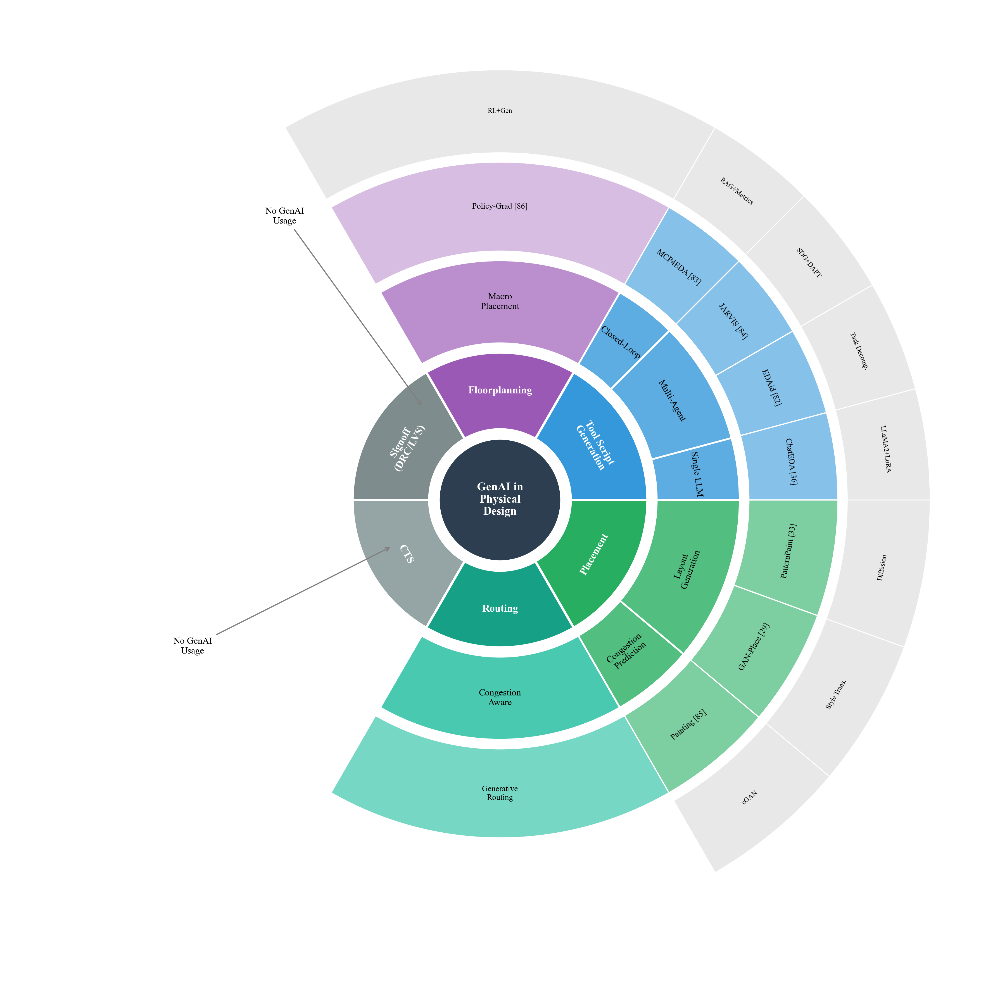


2. B&W version...
Saved: fig_sunburst_v2_bw.pdf/.png


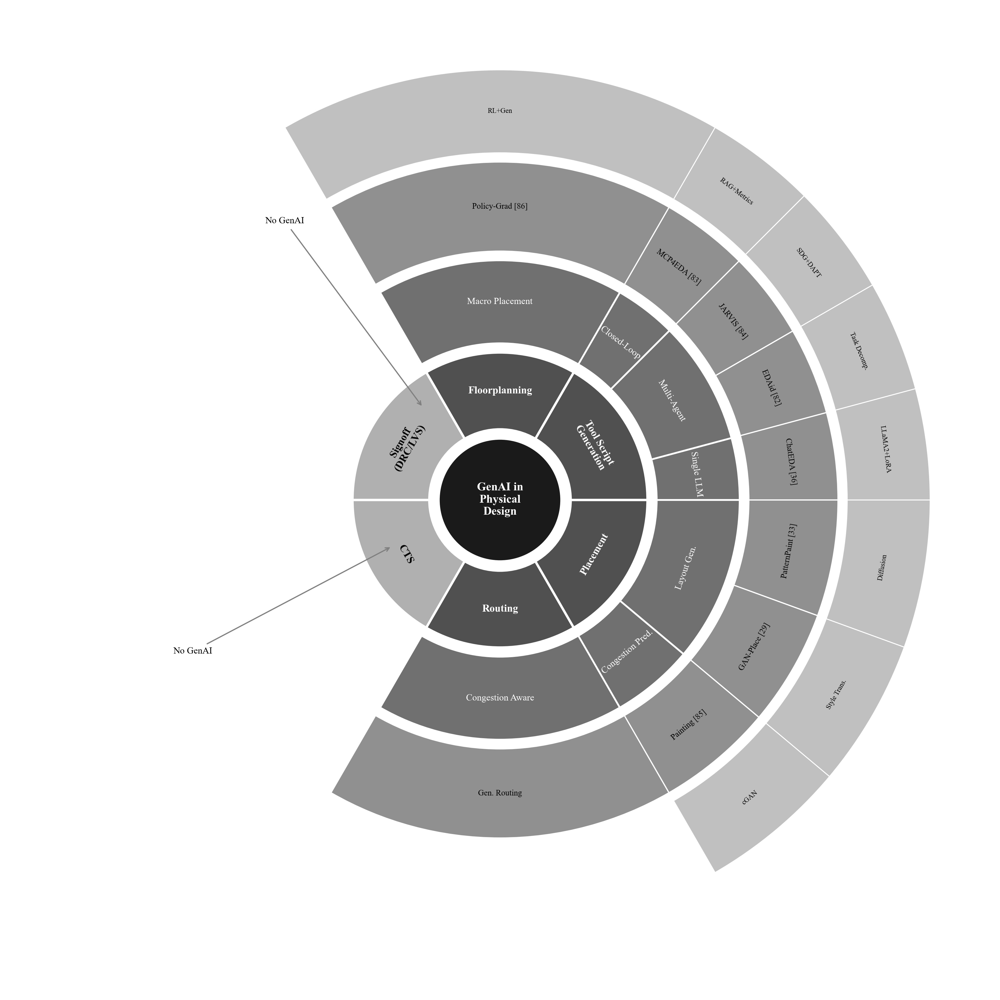


Done!


In [11]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

# =============================================================================
# ACADEMIC STYLE
# =============================================================================
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_sunburst_with_gaps():
    """
    Sunburst chart showing ALL Physical Design stages.
    - Swapped: Signoff and Placement positions
    - Reversed text orientation in Routing section
    - MODIFIED: Reversed text orientation for Signoff and Placement
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII
    # =========================================================================
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48   # Ring 1: PD Stages
    r2_in, r2_out = 0.51, 0.78   # Ring 2: Subcategories
    r3_in, r3_out = 0.81, 1.10   # Ring 3: Methods
    r4_in, r4_out = 1.13, 1.40   # Ring 4: Details
    
    # =========================================================================
    # COLORS
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        # Tool Script - Blue
        'script': '#3498DB',
        'script_l1': '#5DADE2',
        'script_l2': '#85C1E9',
        'script_l3': '#AED6F1',
        # Placement - Green
        'place': '#27AE60',
        'place_l1': '#52BE80',
        'place_l2': '#7DCEA0',
        'place_l3': '#A9DFBF',
        # CTS - Gray (no usage)
        'cts': '#95A5A6',
        # Routing - Teal
        'routing': '#16A085',
        'routing_l1': '#48C9B0',
        'routing_l2': '#76D7C4',
        # Signoff - Gray (limited usage)
        'signoff': '#7F8C8D',
        # Floorplan - Purple
        'floorplan': '#9B59B6',
        'floorplan_l1': '#BB8FCE',
    }
    
    # =========================================================================
    # DATA: All Physical Design Stages
    # ORDER: Tool Script, Floorplanning, Signoff(swapped), CTS, Routing, Placement(swapped)
    # =========================================================================
    
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0,
            'end': stage_angle,
            'color': colors['script'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {
                    'name': 'Single LLM',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Multi-Agent',
                    'count': 2,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'EDAid [82]', 'detail': 'Task Decomp.', 'color': colors['script_l2']},
                        {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT', 'color': colors['script_l2']}
                    ]
                },
                {
                    'name': 'Closed-Loop',
                    'count': 1,
                    'color': colors['script_l1'],
                    'methods': [
                        {'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics', 'color': colors['script_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle,
            'end': stage_angle * 2,
            'color': colors['floorplan'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {
                    'name': 'Macro\nPlacement',
                    'count': 1,
                    'color': colors['floorplan_l1'],
                    'methods': [
                        {'name': 'Policy-Grad [86]', 'detail': 'RL+Gen', 'color': '#D7BDE2'}
                    ]
                },
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 2,
            'end': stage_angle * 3,
            'color': colors['signoff'],
            'has_usage': False,  # NO GenAI usage
            'reverse_text': True, # <--- MODIFIED: Changed to True
            'subcats': []
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3,
            'end': stage_angle * 4,
            'color': colors['cts'],
            'has_usage': False,  # NO GenAI usage
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4,
            'end': stage_angle * 5,
            'color': colors['routing'],
            'has_usage': True,
            'reverse_text': True,  # REVERSE TEXT ORIENTATION
            'subcats': [
                {
                    'name': 'Congestion\nAware',
                    'count': 1,
                    'color': colors['routing_l1'],
                    'methods': [
                        {'name': 'Generative\nRouting', 'detail': '', 'color': colors['routing_l2']}
                    ]
                },
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 5,
            'end': 360,
            'color': colors['place'],
            'has_usage': True,
            'reverse_text': True, # <--- MODIFIED: Changed to True
            'subcats': [
                {
                    'name': 'Congestion\nPrediction',
                    'count': 1,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'Painting [85]', 'detail': 'cGAN', 'color': colors['place_l2']}
                    ]
                },
                {
                    'name': 'Layout\nGeneration',
                    'count': 2,
                    'color': colors['place_l1'],
                    'methods': [
                        {'name': 'GAN-Place [29]', 'detail': 'Style Trans.', 'color': colors['place_l2']},
                        {'name': 'PatternPaint [33]', 'detail': 'Diffusion', 'color': colors['place_l2']}
                    ]
                },
            ]
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                        edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # =========================================================================
    # Helper function for text rotation
    # =========================================================================
    def get_text_angle(angle, reverse=False):
        """Calculate text rotation angle, with optional reversal."""
        text_angle = angle
        if reverse:
            # Reverse the normal logic
            if not (90 < angle < 270):
                text_angle += 180
        else:
            # Normal logic
            if 90 < angle < 270:
                text_angle += 180
        return text_angle - 90
    
    # =========================================================================
    # DRAW RINGS
    # =========================================================================
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        reverse = stage['reverse_text']
        
        # ----- RING 1: PD Stage (always drawn) -----
        wedge1 = patches.Wedge(
            (0, 0), r1_out, stage_start, stage_end,
            width=r1_out - r1_in,
            facecolor=stage['color'],
            edgecolor='white', linewidth=2
        )
        ax.add_patch(wedge1)
        
        # Label for Ring 1
        mid_angle = (stage_start + stage_end) / 2
        mid_angle_rad = np.radians(mid_angle)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        
        text_rotation = get_text_angle(mid_angle, reverse)
        
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color='white',
                rotation=text_rotation)
        
        # ----- ONLY draw outer rings if stage has GenAI usage -----
        if not stage['has_usage'] or not stage['subcats']:
            continue
        
        # Calculate subcategory angles proportionally
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # ----- RING 2: Subcategory -----
            wedge2 = patches.Wedge(
                (0, 0), r2_out, sub_start, sub_end,
                width=r2_out - r2_in,
                facecolor=subcat['color'],
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            # Label for Ring 2
            mid_angle = (sub_start + sub_end) / 2
            mid_angle_rad = np.radians(mid_angle)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            
            text_rotation = get_text_angle(mid_angle, reverse)
            
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='black', rotation=text_rotation)
            
            # ----- RING 3: Methods -----
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge(
                    (0, 0), r3_out, m_start, m_end,
                    width=r3_out - r3_in,
                    facecolor=method['color'],
                    edgecolor='white', linewidth=1
                )
                ax.add_patch(wedge3)
                
                # Label for Ring 3
                mid_angle = (m_start + m_end) / 2
                mid_angle_rad = np.radians(mid_angle)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                
                text_rotation = get_text_angle(mid_angle, reverse)
                
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_rotation)
                
                # ----- RING 4: Detail (if exists) -----
                if method['detail']:
                    wedge4 = patches.Wedge(
                        (0, 0), r4_out, m_start, m_end,
                        width=r4_out - r4_in,
                        facecolor='#E8E8E8',
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge4)
                    
                    mid_angle_rad = np.radians(mid_angle)
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_rotation)
            
            current_angle = sub_end
    
    # =========================================================================
    # Add annotation for empty stages
    # =========================================================================
    # Arrow pointing to Signoff (now at position 2)
    ax.annotate('No GenAI\nUsage', 
                xy=(-0.25, 0.30), xytext=(-0.7, 0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    # Arrow pointing to CTS (position 3)
    ax.annotate('No GenAI\nUsage', 
                xy=(-0.35, -0.15), xytext=(-1.0, -0.5),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_v2.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_v2.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_v2.pdf/.png")
    plt.show()


def draw_sunburst_v2_bw():
    """
    Black & white version with swapped positions and reversed routing text.
    - MODIFIED: Reversed text for Signoff and Placement
    """
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # Ring radii
    r_center = 0.20
    r1_in, r1_out = 0.23, 0.48
    r2_in, r2_out = 0.51, 0.78
    r3_in, r3_out = 0.81, 1.10
    r4_in, r4_out = 1.13, 1.40
    
    # Grayscale
    grays = {
        'center': '#1a1a1a',
        'used': '#505050',
        'unused': '#B0B0B0',
        'l1': '#707070',
        'l2': '#909090',
        'l3': '#C0C0C0',
    }
    
    stage_angle = 360 / 6
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'start': 0, 'end': stage_angle,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {'name': 'Single LLM', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'ChatEDA [36]', 'detail': 'LLaMA2+LoRA'}]},
                {'name': 'Multi-Agent', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'EDAid [82]', 'detail': 'Task Decomp.'},
                             {'name': 'JARVIS [84]', 'detail': 'SDG+DAPT'}]},
                {'name': 'Closed-Loop', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'MCP4EDA [83]', 'detail': 'RAG+Metrics'}]},
            ]
        },
        {
            'name': 'Floorplanning',
            'start': stage_angle, 'end': stage_angle * 2,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': False,
            'subcats': [
                {'name': 'Macro Placement', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Policy-Grad [86]', 'detail': 'RL+Gen'}]},
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'start': stage_angle * 2, 'end': stage_angle * 3,
            'color': grays['unused'],
            'has_usage': False,
            'reverse_text': True, # <--- MODIFIED: Changed to True
            'subcats': []
        },
        {
            'name': 'CTS',
            'start': stage_angle * 3, 'end': stage_angle * 4,
            'color': grays['unused'],
            'has_usage': False,
            'reverse_text': False,
            'subcats': []
        },
        {
            'name': 'Routing',
            'start': stage_angle * 4, 'end': stage_angle * 5,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': True,  # REVERSE
            'subcats': [
                {'name': 'Congestion Aware', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Gen. Routing', 'detail': ''}]},
            ]
        },
        {
            'name': 'Placement',
            'start': stage_angle * 5, 'end': 360,
            'color': grays['used'],
            'has_usage': True,
            'reverse_text': True, # <--- MODIFIED: Changed to True
            'subcats': [
                {'name': 'Congestion Pred.', 'count': 1, 'color': grays['l1'],
                 'methods': [{'name': 'Painting [85]', 'detail': 'cGAN'}]},
                {'name': 'Layout Gen.', 'count': 2, 'color': grays['l1'],
                 'methods': [{'name': 'GAN-Place [29]', 'detail': 'Style Trans.'},
                             {'name': 'PatternPaint [33]', 'detail': 'Diffusion'}]},
            ]
        },
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], 
                        edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    def get_text_angle(angle, reverse=False):
        text_angle = angle
        if reverse:
            if not (90 < angle < 270):
                text_angle += 180
        else:
            if 90 < angle < 270:
                text_angle += 180
        return text_angle - 90
    
    # Draw rings
    for stage in stages:
        stage_start = stage['start']
        stage_end = stage['end']
        stage_span = stage_end - stage_start
        reverse = stage['reverse_text']
        
        # Ring 1
        wedge1 = patches.Wedge((0, 0), r1_out, stage_start, stage_end,
                                width=r1_out - r1_in, facecolor=stage['color'],
                                edgecolor='white', linewidth=2)
        ax.add_patch(wedge1)
        
        mid_angle = (stage_start + stage_end) / 2
        mid_angle_rad = np.radians(mid_angle)
        label_r = (r1_in + r1_out) / 2
        lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
        text_rotation = get_text_angle(mid_angle, reverse)
        
        text_color = 'white' if stage['has_usage'] else 'black'
        ax.text(lx, ly, stage['name'], ha='center', va='center',
                fontsize=9, fontweight='bold', color=text_color,
                rotation=text_rotation)
        
        if not stage['has_usage'] or not stage['subcats']:
            continue
        
        total_subcat_count = sum(sub['count'] for sub in stage['subcats'])
        current_angle = stage_start
        
        for subcat in stage['subcats']:
            sub_span = (subcat['count'] / total_subcat_count) * stage_span
            sub_start = current_angle
            sub_end = current_angle + sub_span
            
            # Ring 2
            wedge2 = patches.Wedge((0, 0), r2_out, sub_start, sub_end,
                                    width=r2_out - r2_in, facecolor=subcat['color'],
                                    edgecolor='white', linewidth=1.5)
            ax.add_patch(wedge2)
            
            mid_angle = (sub_start + sub_end) / 2
            mid_angle_rad = np.radians(mid_angle)
            label_r = (r2_in + r2_out) / 2
            lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
            text_rotation = get_text_angle(mid_angle, reverse)
            
            if sub_span > 12:
                ax.text(lx, ly, subcat['name'], ha='center', va='center',
                        fontsize=8, color='white', rotation=text_rotation)
            
            # Ring 3
            n_methods = len(subcat['methods'])
            method_span = sub_span / n_methods
            
            for i, method in enumerate(subcat['methods']):
                m_start = sub_start + i * method_span
                m_end = m_start + method_span
                
                wedge3 = patches.Wedge((0, 0), r3_out, m_start, m_end,
                                        width=r3_out - r3_in, facecolor=grays['l2'],
                                        edgecolor='white', linewidth=1)
                ax.add_patch(wedge3)
                
                mid_angle = (m_start + m_end) / 2
                mid_angle_rad = np.radians(mid_angle)
                label_r = (r3_in + r3_out) / 2
                lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                text_rotation = get_text_angle(mid_angle, reverse)
                
                if method_span > 8:
                    ax.text(lx, ly, method['name'], ha='center', va='center',
                            fontsize=7, color='black', rotation=text_rotation)
                
                # Ring 4
                if method['detail']:
                    wedge4 = patches.Wedge((0, 0), r4_out, m_start, m_end,
                                            width=r4_out - r4_in, facecolor=grays['l3'],
                                            edgecolor='white', linewidth=0.8)
                    ax.add_patch(wedge4)
                    
                    label_r = (r4_in + r4_out) / 2
                    lx, ly = label_r * np.cos(mid_angle_rad), label_r * np.sin(mid_angle_rad)
                    if method_span > 12:
                        ax.text(lx, ly, method['detail'], ha='center', va='center',
                                fontsize=6, color='black', rotation=text_rotation)
            
            current_angle = sub_end
    
    # Annotations
    ax.annotate('No GenAI', xy=(-0.25, 0.30), xytext=(-0.7, 0.9),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    ax.annotate('No GenAI', xy=(-0.35, -0.15), xytext=(-1.0, -0.5),
                fontsize=8, ha='center',
                arrowprops=dict(arrowstyle='->', color='gray', lw=1))
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_v2_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_v2_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_v2_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*60)
    print("Sunburst V2: Swapped Signoff/Placement, Reversed Routing text")
    print("="*60)
    
    print("\n1. Color version...")
    draw_sunburst_with_gaps()
    
    print("\n2. B&W version...")
    draw_sunburst_v2_bw()
    
    print("\nDone!")

Fixed-Grid Sunburst: Blanks show missing data

Grid structure:
  Layer 1: 6 stages × 60° each
  Layer 2: 3 slots × 20° each per stage
  Layer 3: 2 slots × 10° each per subcategory
  Unfilled slots = BLANK (white space)

1. Color version...
Saved: fig_sunburst_grid.pdf/.png


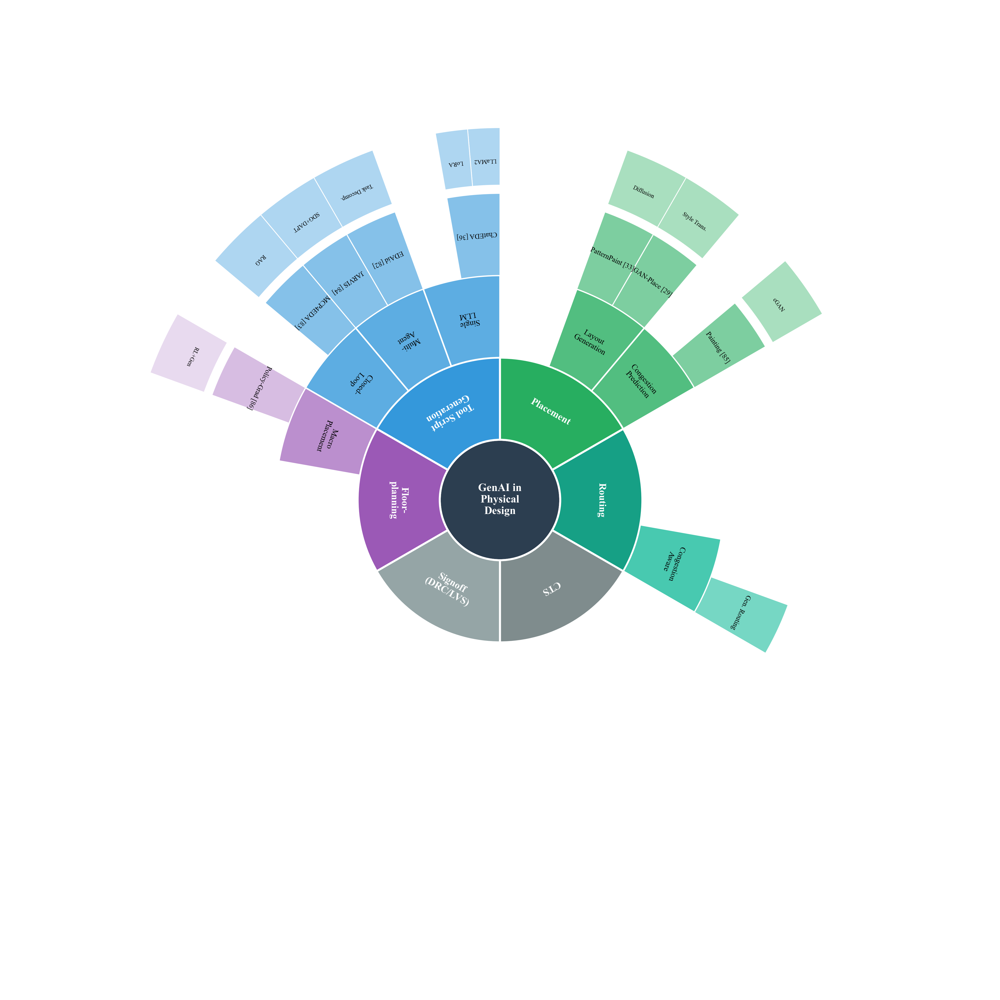


2. B&W version...
Saved: fig_sunburst_grid_bw.pdf/.png


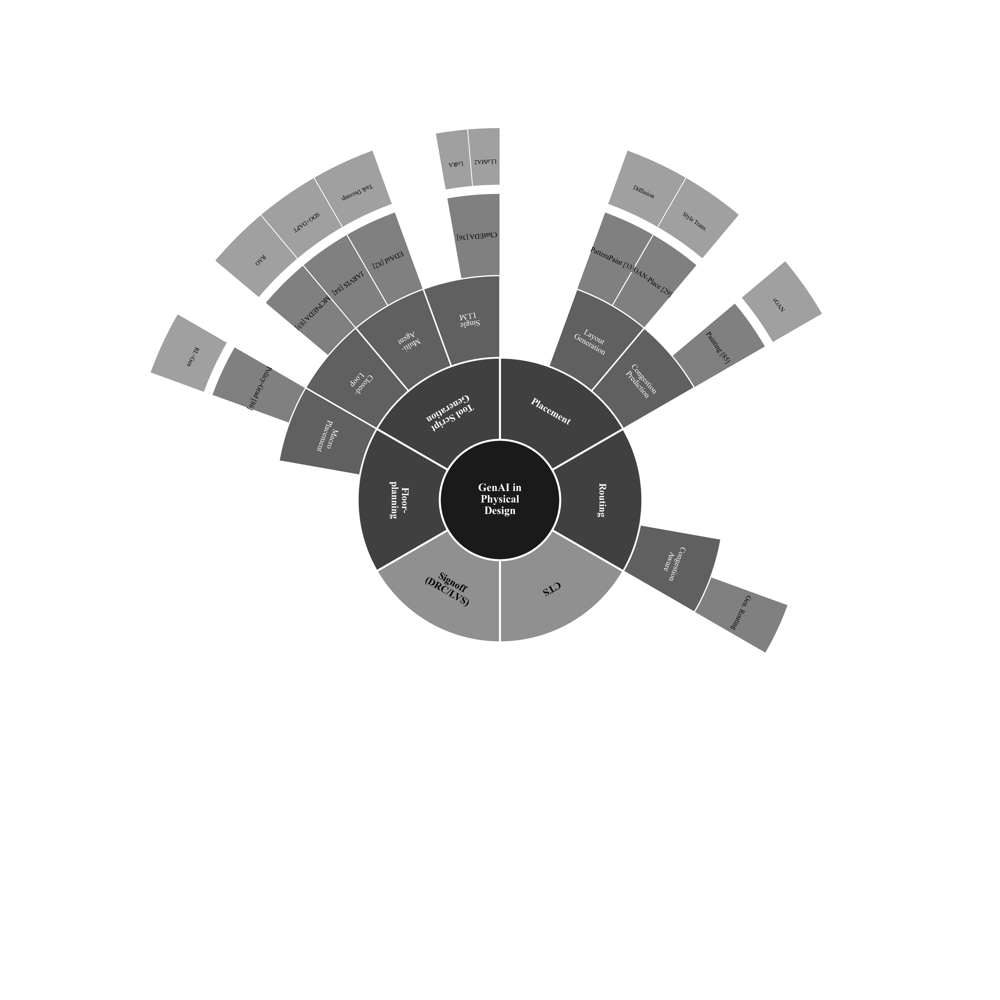


Done!


In [12]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Fixed-grid Sunburst:
- Layer 1: 6 stages, EQUAL 60° each
- Layer 2: Each stage has MAX 3 slots, fill only what exists, leave rest BLANK
- Layer 3: Each subcategory has MAX N slots, same logic
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_fixed_grid_sunburst():
    fig, ax = plt.subplots(figsize=(14, 14))
    ax.set_xlim(-1.8, 1.8)
    ax.set_ylim(-1.8, 1.8)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII
    # =========================================================================
    r_center = 0.22
    ring_width = 0.30
    
    r0 = r_center
    r1 = r0 + ring_width          # Layer 1: Main stages
    r2 = r1 + ring_width          # Layer 2: Subcategories (max 3 slots)
    r3 = r2 + ring_width          # Layer 3: Methods (max 2-3 slots)
    r4 = r3 + ring_width * 0.8    # Layer 4: Details
    
    # =========================================================================
    # GRID SETTINGS
    # =========================================================================
    n_stages = 6                   # 6 stages in layer 1
    stage_angle = 360 / n_stages   # 60° per stage
    max_subcats = 3                # Max 3 subcategories per stage
    subcat_angle = stage_angle / max_subcats  # 20° per subcategory slot
    max_methods = 2                # Max 2 methods per subcategory
    
    # =========================================================================
    # COLORS
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        'script': ['#3498DB', '#5DADE2', '#85C1E9', '#AED6F1'],
        'floorplan': ['#9B59B6', '#BB8FCE', '#D7BDE2', '#E8DAEF'],
        'signoff': ['#95A5A6', '#B0B0B0', '#C8C8C8'],
        'cts': ['#7F8C8D', '#A0A0A0', '#B8B8B8'],
        'routing': ['#16A085', '#48C9B0', '#76D7C4', '#A3E4D7'],
        'place': ['#27AE60', '#52BE80', '#7DCEA0', '#A9DFBF'],
    }
    
    # =========================================================================
    # DATA STRUCTURE
    # subcats list: up to 3 items, each with up to 2 methods
    # =========================================================================
    start_angle = 90  # Start from top
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'key': 'script',
            'subcats': [
                {'name': 'Single\nLLM', 'methods': [
                    {'name': 'ChatEDA [36]', 'details': ['LLaMA2', 'LoRA']}
                ]},
                {'name': 'Multi-\nAgent', 'methods': [
                    {'name': 'EDAid [82]', 'details': ['Task Decomp.']},
                    {'name': 'JARVIS [84]', 'details': ['SDG+DAPT']}
                ]},
                {'name': 'Closed-\nLoop', 'methods': [
                    {'name': 'MCP4EDA [83]', 'details': ['RAG']}
                ]},
            ]
        },
        {
            'name': 'Floor-\nplanning',
            'key': 'floorplan',
            'subcats': [
                {'name': 'Macro\nPlacement', 'methods': [
                    {'name': 'Policy-Grad [86]', 'details': ['RL+Gen']}
                ]},
                # Only 1 subcategory → 2 slots will be BLANK
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'key': 'signoff',
            'subcats': []  # No subcategories → ALL slots BLANK
        },
        {
            'name': 'CTS',
            'key': 'cts',
            'subcats': []  # No subcategories → ALL slots BLANK
        },
        {
            'name': 'Routing',
            'key': 'routing',
            'subcats': [
                {'name': 'Congestion\nAware', 'methods': [
                    {'name': 'Gen. Routing', 'details': []}
                ]},
                # Only 1 subcategory → 2 slots will be BLANK
            ]
        },
        {
            'name': 'Placement',
            'key': 'place',
            'subcats': [
                {'name': 'Congestion\nPrediction', 'methods': [
                    {'name': 'Painting [85]', 'details': ['cGAN']}
                ]},
                {'name': 'Layout\nGeneration', 'methods': [
                    {'name': 'GAN-Place [29]', 'details': ['Style Trans.']},
                    {'name': 'PatternPaint [33]', 'details': ['Diffusion']}
                ]},
                # 2 subcategories → 1 slot will be BLANK
            ]
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=11, fontweight='bold', color='white')
    
    # =========================================================================
    # HELPER FUNCTIONS
    # =========================================================================
    def get_text_rotation(angle):
        if 90 < angle % 360 < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    for stage_idx, stage in enumerate(stages):
        stage_start = start_angle + stage_idx * stage_angle
        stage_end = stage_start + stage_angle
        stage_colors = colors[stage['key']]
        
        # ----- LAYER 1: Stage (always filled) -----
        wedge1 = patches.Wedge(
            (0, 0), r1, stage_start, stage_end,
            width=ring_width,
            facecolor=stage_colors[0],
            edgecolor='white', linewidth=2
        )
        ax.add_patch(wedge1)
        
        mid_angle = stage_start + stage_angle / 2
        draw_label(ax, mid_angle, r0, r1, stage['name'], 
                   fontsize=10, color='white', bold=True)
        
        # ----- LAYER 2: Subcategory slots (max 3) -----
        n_actual_subcats = len(stage['subcats'])
        
        for slot_idx in range(max_subcats):
            slot_start = stage_start + slot_idx * subcat_angle
            slot_end = slot_start + subcat_angle
            
            if slot_idx < n_actual_subcats:
                # FILLED slot
                subcat = stage['subcats'][slot_idx]
                
                wedge2 = patches.Wedge(
                    (0, 0), r2, slot_start, slot_end,
                    width=ring_width,
                    facecolor=stage_colors[1] if len(stage_colors) > 1 else stage_colors[0],
                    edgecolor='white', linewidth=1.5
                )
                ax.add_patch(wedge2)
                
                mid_angle = slot_start + subcat_angle / 2
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=8)
                
                # ----- LAYER 3: Method slots (max 2) -----
                n_actual_methods = len(subcat['methods'])
                method_angle = subcat_angle / max_methods
                
                for method_idx in range(max_methods):
                    method_start = slot_start + method_idx * method_angle
                    method_end = method_start + method_angle
                    
                    if method_idx < n_actual_methods:
                        # FILLED method slot
                        method = subcat['methods'][method_idx]
                        
                        wedge3 = patches.Wedge(
                            (0, 0), r3, method_start, method_end,
                            width=ring_width,
                            facecolor=stage_colors[2] if len(stage_colors) > 2 else stage_colors[-1],
                            edgecolor='white', linewidth=1
                        )
                        ax.add_patch(wedge3)
                        
                        mid_angle = method_start + method_angle / 2
                        draw_label(ax, mid_angle, r2, r3, method['name'], fontsize=7)
                        
                        # ----- LAYER 4: Details -----
                        n_details = len(method['details'])
                        if n_details > 0:
                            detail_angle = method_angle / n_details
                            for detail_idx, detail in enumerate(method['details']):
                                detail_start = method_start + detail_idx * detail_angle
                                detail_end = detail_start + detail_angle
                                
                                wedge4 = patches.Wedge(
                                    (0, 0), r4, detail_start, detail_end,
                                    width=ring_width * 0.7,
                                    facecolor=stage_colors[3] if len(stage_colors) > 3 else stage_colors[-1],
                                    edgecolor='white', linewidth=0.8
                                )
                                ax.add_patch(wedge4)
                                
                                mid_angle = detail_start + detail_angle / 2
                                draw_label(ax, mid_angle, r3, r4, detail, fontsize=6)
                    
                    # else: BLANK method slot (no wedge drawn)
            
            # else: BLANK subcategory slot (no wedge drawn)
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_grid.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_grid.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_grid.pdf/.png")
    plt.show()


def draw_fixed_grid_sunburst_bw():
    """Black & white version."""
    fig, ax = plt.subplots(figsize=(14, 14))
    ax.set_xlim(-1.8, 1.8)
    ax.set_ylim(-1.8, 1.8)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.22
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    r4 = r3 + ring_width * 0.8
    
    n_stages = 6
    stage_angle = 360 / n_stages
    max_subcats = 3
    subcat_angle = stage_angle / max_subcats
    max_methods = 2
    
    # Grayscale colors
    grays_used = ['#404040', '#606060', '#808080', '#A0A0A0']
    grays_unused = ['#909090', '#A8A8A8', '#C0C0C0']
    
    start_angle = 90
    
    stages = [
        {'name': 'Tool Script\nGeneration', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Single\nLLM', 'methods': [{'name': 'ChatEDA [36]', 'details': ['LLaMA2', 'LoRA']}]},
            {'name': 'Multi-\nAgent', 'methods': [{'name': 'EDAid [82]', 'details': ['Task Decomp.']},
                                                   {'name': 'JARVIS [84]', 'details': ['SDG+DAPT']}]},
            {'name': 'Closed-\nLoop', 'methods': [{'name': 'MCP4EDA [83]', 'details': ['RAG']}]},
        ]},
        {'name': 'Floor-\nplanning', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Macro\nPlacement', 'methods': [{'name': 'Policy-Grad [86]', 'details': ['RL+Gen']}]},
        ]},
        {'name': 'Signoff\n(DRC/LVS)', 'has_data': False, 'colors': grays_unused, 'subcats': []},
        {'name': 'CTS', 'has_data': False, 'colors': grays_unused, 'subcats': []},
        {'name': 'Routing', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Congestion\nAware', 'methods': [{'name': 'Gen. Routing', 'details': []}]},
        ]},
        {'name': 'Placement', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Congestion\nPrediction', 'methods': [{'name': 'Painting [85]', 'details': ['cGAN']}]},
            {'name': 'Layout\nGeneration', 'methods': [{'name': 'GAN-Place [29]', 'details': ['Style Trans.']},
                                                        {'name': 'PatternPaint [33]', 'details': ['Diffusion']}]},
        ]},
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor='#1a1a1a', edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=11, fontweight='bold', color='white')
    
    def get_text_rotation(angle):
        if 90 < angle % 360 < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    for stage_idx, stage in enumerate(stages):
        stage_start = start_angle + stage_idx * stage_angle
        stage_end = stage_start + stage_angle
        stage_colors = stage['colors']
        
        # Layer 1
        wedge1 = patches.Wedge((0, 0), r1, stage_start, stage_end,
                                width=ring_width, facecolor=stage_colors[0],
                                edgecolor='white', linewidth=2)
        ax.add_patch(wedge1)
        
        mid_angle = stage_start + stage_angle / 2
        text_color = 'white' if stage['has_data'] else 'black'
        draw_label(ax, mid_angle, r0, r1, stage['name'], fontsize=10, color=text_color, bold=True)
        
        n_actual_subcats = len(stage['subcats'])
        
        for slot_idx in range(max_subcats):
            slot_start = stage_start + slot_idx * subcat_angle
            slot_end = slot_start + subcat_angle
            
            if slot_idx < n_actual_subcats:
                subcat = stage['subcats'][slot_idx]
                
                wedge2 = patches.Wedge((0, 0), r2, slot_start, slot_end,
                                        width=ring_width, facecolor=stage_colors[1],
                                        edgecolor='white', linewidth=1.5)
                ax.add_patch(wedge2)
                
                mid_angle = slot_start + subcat_angle / 2
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=8, color='white')
                
                n_actual_methods = len(subcat['methods'])
                method_angle = subcat_angle / max_methods
                
                for method_idx in range(max_methods):
                    method_start = slot_start + method_idx * method_angle
                    method_end = method_start + method_angle
                    
                    if method_idx < n_actual_methods:
                        method = subcat['methods'][method_idx]
                        
                        wedge3 = patches.Wedge((0, 0), r3, method_start, method_end,
                                                width=ring_width, facecolor=stage_colors[2],
                                                edgecolor='white', linewidth=1)
                        ax.add_patch(wedge3)
                        
                        mid_angle = method_start + method_angle / 2
                        draw_label(ax, mid_angle, r2, r3, method['name'], fontsize=7)
                        
                        n_details = len(method['details'])
                        if n_details > 0:
                            detail_angle = method_angle / n_details
                            for detail_idx, detail in enumerate(method['details']):
                                detail_start = method_start + detail_idx * detail_angle
                                detail_end = detail_start + detail_angle
                                
                                wedge4 = patches.Wedge((0, 0), r4, detail_start, detail_end,
                                                        width=ring_width * 0.7, facecolor=stage_colors[3],
                                                        edgecolor='white', linewidth=0.8)
                                ax.add_patch(wedge4)
                                
                                mid_angle = detail_start + detail_angle / 2
                                draw_label(ax, mid_angle, r3, r4, detail, fontsize=6)
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_grid_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_grid_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_grid_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*60)
    print("Fixed-Grid Sunburst: Blanks show missing data")
    print("="*60)
    print("\nGrid structure:")
    print("  Layer 1: 6 stages × 60° each")
    print("  Layer 2: 3 slots × 20° each per stage")
    print("  Layer 3: 2 slots × 10° each per subcategory")
    print("  Unfilled slots = BLANK (white space)")
    
    print("\n1. Color version...")
    draw_fixed_grid_sunburst()
    
    print("\n2. B&W version...")
    draw_fixed_grid_sunburst_bw()
    
    print("\nDone!")

3-Layer Sunburst (details merged into methods)

Structure:
  Layer 1: 6 stages × 60° each
  Layer 2: 3 slots × 20° each
  Layer 3: 2 slots × 10° each (citation + technique)

1. Color version...
Saved: fig_sunburst_3layer.pdf/.png


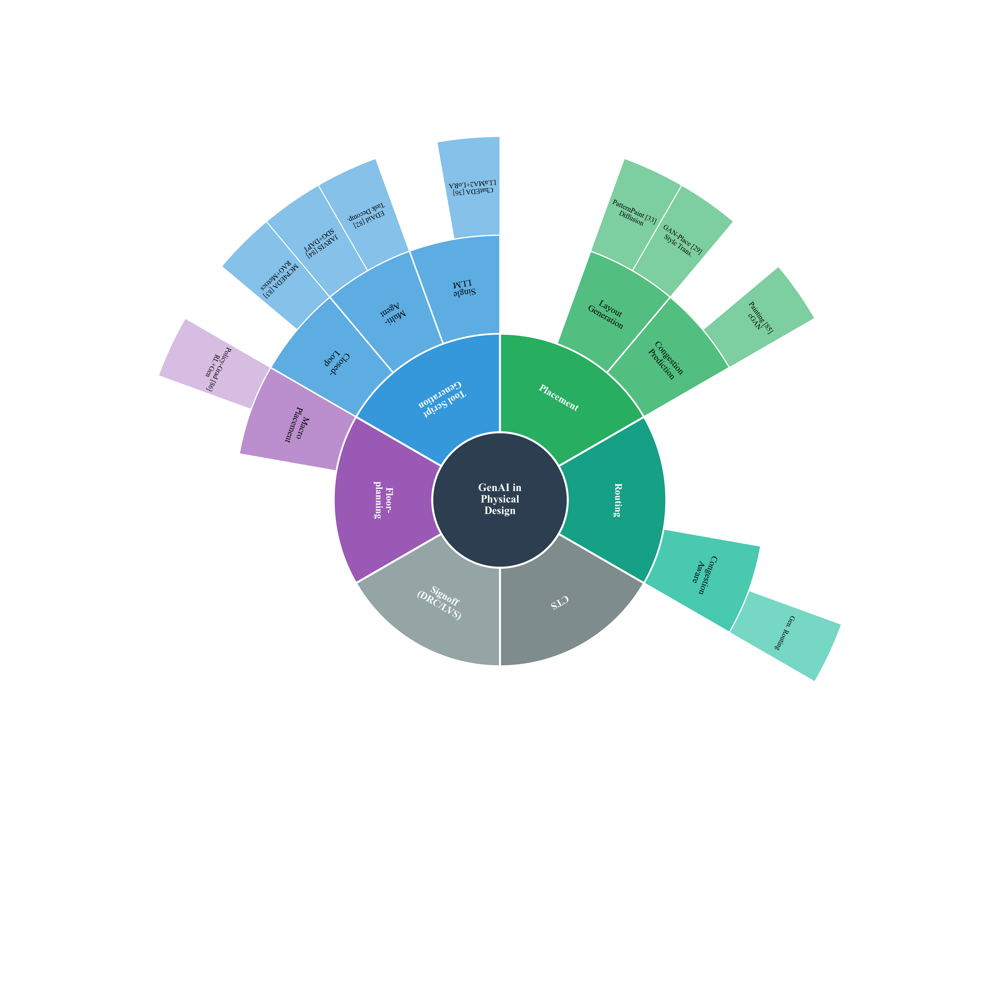


2. B&W version...
Saved: fig_sunburst_3layer_bw.pdf/.png


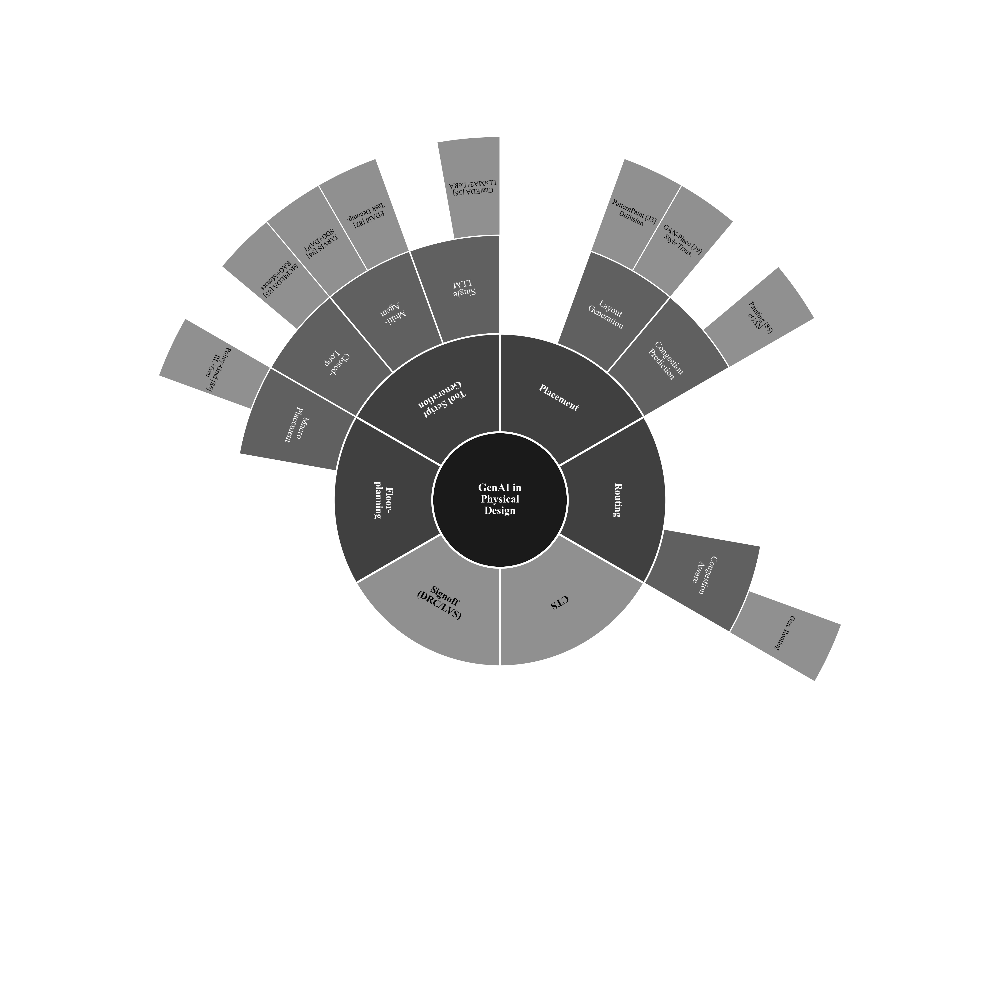


Done!


In [13]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Fixed-grid Sunburst (3 layers only):
- Layer 1: 6 stages, EQUAL 60° each
- Layer 2: Max 3 subcategory slots
- Layer 3: Max 2 method slots (with details merged into name)
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_fixed_grid_sunburst():
    fig, ax = plt.subplots(figsize=(14, 14))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII (only 3 layers now)
    # =========================================================================
    r_center = 0.22
    ring_width = 0.32
    
    r0 = r_center
    r1 = r0 + ring_width          # Layer 1: Main stages
    r2 = r1 + ring_width          # Layer 2: Subcategories (max 3 slots)
    r3 = r2 + ring_width          # Layer 3: Methods with details (max 2 slots)
    
    # =========================================================================
    # GRID SETTINGS
    # =========================================================================
    n_stages = 6
    stage_angle = 360 / n_stages   # 60° per stage
    max_subcats = 3
    subcat_angle = stage_angle / max_subcats  # 20° per subcategory slot
    max_methods = 2
    
    # =========================================================================
    # COLORS
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        'script': ['#3498DB', '#5DADE2', '#85C1E9'],
        'floorplan': ['#9B59B6', '#BB8FCE', '#D7BDE2'],
        'signoff': ['#95A5A6', '#B0B0B0', '#C8C8C8'],
        'cts': ['#7F8C8D', '#A0A0A0', '#B8B8B8'],
        'routing': ['#16A085', '#48C9B0', '#76D7C4'],
        'place': ['#27AE60', '#52BE80', '#7DCEA0'],
    }
    
    # =========================================================================
    # DATA STRUCTURE - Details merged into method names
    # =========================================================================
    start_angle = 90
    
    stages = [
        {
            'name': 'Tool Script\nGeneration',
            'key': 'script',
            'subcats': [
                {'name': 'Single\nLLM', 'methods': [
                    'ChatEDA [36]\nLLaMA2+LoRA'
                ]},
                {'name': 'Multi-\nAgent', 'methods': [
                    'EDAid [82]\nTask Decomp.',
                    'JARVIS [84]\nSDG+DAPT'
                ]},
                {'name': 'Closed-\nLoop', 'methods': [
                    'MCP4EDA [83]\nRAG+Metrics'
                ]},
            ]
        },
        {
            'name': 'Floor-\nplanning',
            'key': 'floorplan',
            'subcats': [
                {'name': 'Macro\nPlacement', 'methods': [
                    'Policy-Grad [86]\nRL+Gen'
                ]},
            ]
        },
        {
            'name': 'Signoff\n(DRC/LVS)',
            'key': 'signoff',
            'subcats': []
        },
        {
            'name': 'CTS',
            'key': 'cts',
            'subcats': []
        },
        {
            'name': 'Routing',
            'key': 'routing',
            'subcats': [
                {'name': 'Congestion\nAware', 'methods': [
                    'Gen. Routing'
                ]},
            ]
        },
        {
            'name': 'Placement',
            'key': 'place',
            'subcats': [
                {'name': 'Congestion\nPrediction', 'methods': [
                    'Painting [85]\ncGAN'
                ]},
                {'name': 'Layout\nGeneration', 'methods': [
                    'GAN-Place [29]\nStyle Trans.',
                    'PatternPaint [33]\nDiffusion'
                ]},
            ]
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=11, fontweight='bold', color='white')
    
    # =========================================================================
    # HELPER FUNCTIONS
    # =========================================================================
    def get_text_rotation(angle):
        if 90 < angle % 360 < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    for stage_idx, stage in enumerate(stages):
        stage_start = start_angle + stage_idx * stage_angle
        stage_end = stage_start + stage_angle
        stage_colors = colors[stage['key']]
        
        # ----- LAYER 1: Stage -----
        wedge1 = patches.Wedge(
            (0, 0), r1, stage_start, stage_end,
            width=ring_width,
            facecolor=stage_colors[0],
            edgecolor='white', linewidth=2
        )
        ax.add_patch(wedge1)
        
        mid_angle = stage_start + stage_angle / 2
        draw_label(ax, mid_angle, r0, r1, stage['name'], 
                   fontsize=10, color='white', bold=True)
        
        # ----- LAYER 2: Subcategory slots -----
        n_actual_subcats = len(stage['subcats'])
        
        for slot_idx in range(max_subcats):
            slot_start = stage_start + slot_idx * subcat_angle
            slot_end = slot_start + subcat_angle
            
            if slot_idx < n_actual_subcats:
                subcat = stage['subcats'][slot_idx]
                
                wedge2 = patches.Wedge(
                    (0, 0), r2, slot_start, slot_end,
                    width=ring_width,
                    facecolor=stage_colors[1],
                    edgecolor='white', linewidth=1.5
                )
                ax.add_patch(wedge2)
                
                mid_angle = slot_start + subcat_angle / 2
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=9)
                
                # ----- LAYER 3: Method slots (with details in name) -----
                n_actual_methods = len(subcat['methods'])
                method_angle = subcat_angle / max_methods
                
                for method_idx in range(max_methods):
                    method_start = slot_start + method_idx * method_angle
                    method_end = method_start + method_angle
                    
                    if method_idx < n_actual_methods:
                        method_name = subcat['methods'][method_idx]
                        
                        wedge3 = patches.Wedge(
                            (0, 0), r3, method_start, method_end,
                            width=ring_width,
                            facecolor=stage_colors[2],
                            edgecolor='white', linewidth=1
                        )
                        ax.add_patch(wedge3)
                        
                        mid_angle = method_start + method_angle / 2
                        draw_label(ax, mid_angle, r2, r3, method_name, fontsize=7)
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_3layer.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_3layer.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_3layer.pdf/.png")
    plt.show()


def draw_fixed_grid_sunburst_bw():
    """Black & white version."""
    fig, ax = plt.subplots(figsize=(14, 14))
    ax.set_xlim(-1.6, 1.6)
    ax.set_ylim(-1.6, 1.6)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.22
    ring_width = 0.32
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    n_stages = 6
    stage_angle = 360 / n_stages
    max_subcats = 3
    subcat_angle = stage_angle / max_subcats
    max_methods = 2
    
    grays_used = ['#404040', '#606060', '#909090']
    grays_unused = ['#909090', '#A8A8A8', '#C0C0C0']
    
    start_angle = 90
    
    stages = [
        {'name': 'Tool Script\nGeneration', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Single\nLLM', 'methods': ['ChatEDA [36]\nLLaMA2+LoRA']},
            {'name': 'Multi-\nAgent', 'methods': ['EDAid [82]\nTask Decomp.', 'JARVIS [84]\nSDG+DAPT']},
            {'name': 'Closed-\nLoop', 'methods': ['MCP4EDA [83]\nRAG+Metrics']},
        ]},
        {'name': 'Floor-\nplanning', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Macro\nPlacement', 'methods': ['Policy-Grad [86]\nRL+Gen']},
        ]},
        {'name': 'Signoff\n(DRC/LVS)', 'has_data': False, 'colors': grays_unused, 'subcats': []},
        {'name': 'CTS', 'has_data': False, 'colors': grays_unused, 'subcats': []},
        {'name': 'Routing', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Congestion\nAware', 'methods': ['Gen. Routing']},
        ]},
        {'name': 'Placement', 'has_data': True, 'colors': grays_used,
         'subcats': [
            {'name': 'Congestion\nPrediction', 'methods': ['Painting [85]\ncGAN']},
            {'name': 'Layout\nGeneration', 'methods': ['GAN-Place [29]\nStyle Trans.', 'PatternPaint [33]\nDiffusion']},
        ]},
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor='#1a1a1a', edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nPhysical\nDesign', ha='center', va='center',
            fontsize=11, fontweight='bold', color='white')
    
    def get_text_rotation(angle):
        if 90 < angle % 360 < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    for stage_idx, stage in enumerate(stages):
        stage_start = start_angle + stage_idx * stage_angle
        stage_end = stage_start + stage_angle
        stage_colors = stage['colors']
        
        # Layer 1
        wedge1 = patches.Wedge((0, 0), r1, stage_start, stage_end,
                                width=ring_width, facecolor=stage_colors[0],
                                edgecolor='white', linewidth=2)
        ax.add_patch(wedge1)
        
        mid_angle = stage_start + stage_angle / 2
        text_color = 'white' if stage['has_data'] else 'black'
        draw_label(ax, mid_angle, r0, r1, stage['name'], fontsize=10, color=text_color, bold=True)
        
        n_actual_subcats = len(stage['subcats'])
        
        for slot_idx in range(max_subcats):
            slot_start = stage_start + slot_idx * subcat_angle
            slot_end = slot_start + subcat_angle
            
            if slot_idx < n_actual_subcats:
                subcat = stage['subcats'][slot_idx]
                
                wedge2 = patches.Wedge((0, 0), r2, slot_start, slot_end,
                                        width=ring_width, facecolor=stage_colors[1],
                                        edgecolor='white', linewidth=1.5)
                ax.add_patch(wedge2)
                
                mid_angle = slot_start + subcat_angle / 2
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=9, color='white')
                
                n_actual_methods = len(subcat['methods'])
                method_angle = subcat_angle / max_methods
                
                for method_idx in range(max_methods):
                    method_start = slot_start + method_idx * method_angle
                    method_end = method_start + method_angle
                    
                    if method_idx < n_actual_methods:
                        method_name = subcat['methods'][method_idx]
                        
                        wedge3 = patches.Wedge((0, 0), r3, method_start, method_end,
                                                width=ring_width, facecolor=stage_colors[2],
                                                edgecolor='white', linewidth=1)
                        ax.add_patch(wedge3)
                        
                        mid_angle = method_start + method_angle / 2
                        draw_label(ax, mid_angle, r2, r3, method_name, fontsize=7)
    
    plt.tight_layout()
    plt.savefig('fig_sunburst_3layer_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_sunburst_3layer_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_sunburst_3layer_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*60)
    print("3-Layer Sunburst (details merged into methods)")
    print("="*60)
    print("\nStructure:")
    print("  Layer 1: 6 stages × 60° each")
    print("  Layer 2: 3 slots × 20° each")
    print("  Layer 3: 2 slots × 10° each (citation + technique)")
    
    print("\n1. Color version...")
    draw_fixed_grid_sunburst()
    
    print("\n2. B&W version...")
    draw_fixed_grid_sunburst_bw()
    
    print("\nDone!")

GenAI in IC Design - Full Survey Sunburst (Parts III-VI)

Structure:
  Layer 1: 4 Main Sections (AMS, Logic, PD, Yield)
  Layer 2: 4 Subsections per section (max)
  Layer 3: 4 Methods per subsection (max)
  Empty slots = Blank (research gaps)

1. Color version...
Saved: fig_genai_ic_full.pdf/.png


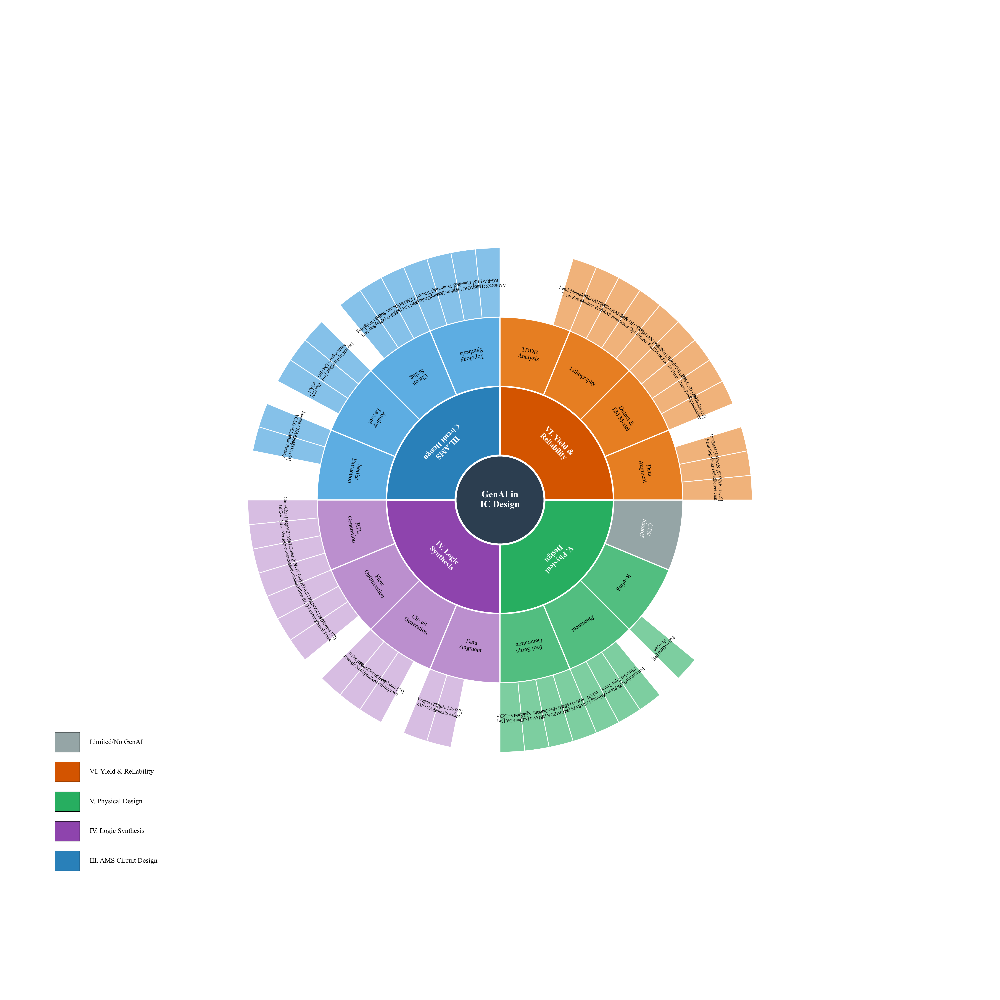


2. B&W version...
Saved: fig_genai_ic_full_bw.pdf/.png


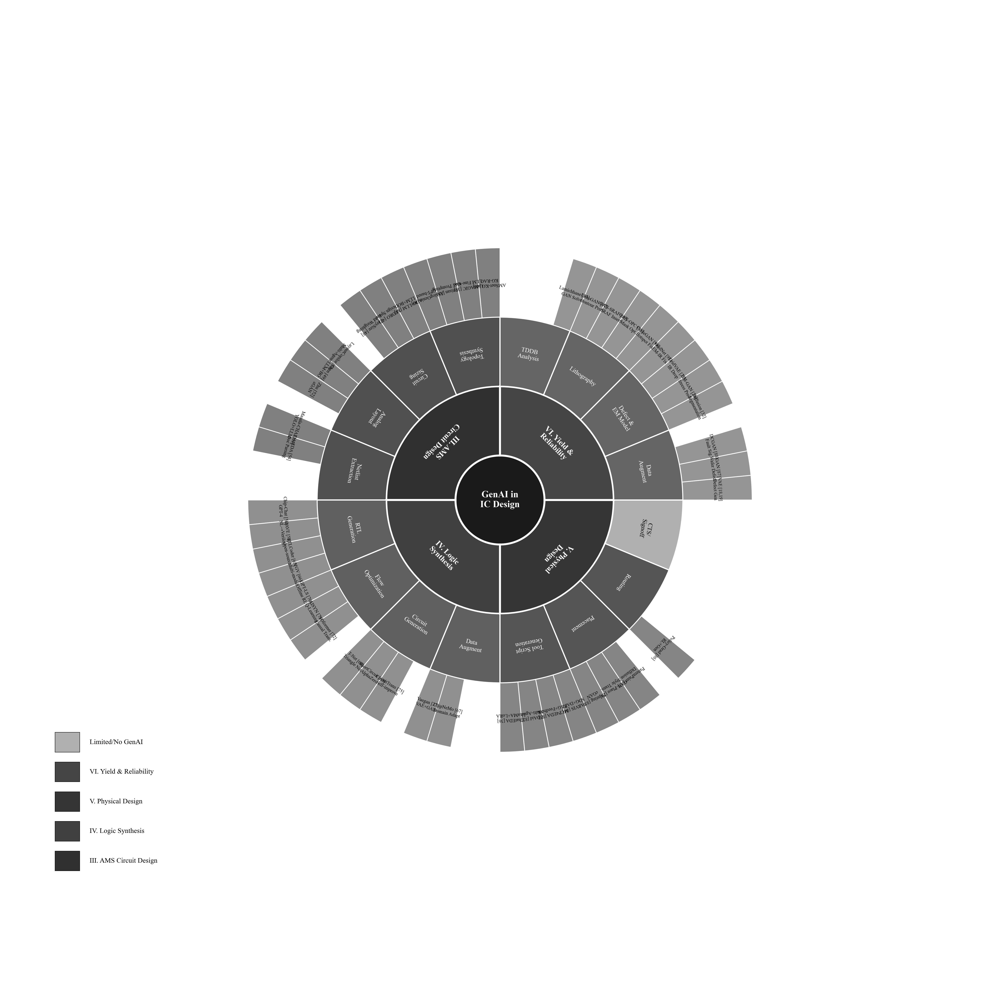


Done!


In [14]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Comprehensive Sunburst for GenAI in IC Design Survey (Parts III-VI)
Structure:
- Layer 1: Main Sections (4 sections: AMS, Logic, Physical Design, Yield/Reliability)
- Layer 2: Subsections within each section
- Layer 3: Specific methods/papers
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_full_sunburst():
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-2.0, 2.0)
    ax.set_ylim(-2.0, 2.0)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # =========================================================================
    # RING RADII
    # =========================================================================
    r_center = 0.18
    ring_width = 0.28
    
    r0 = r_center
    r1 = r0 + ring_width          # Layer 1: Main sections (4)
    r2 = r1 + ring_width          # Layer 2: Subsections
    r3 = r2 + ring_width          # Layer 3: Methods/Papers
    
    # =========================================================================
    # COLORS for each main section
    # =========================================================================
    colors = {
        'center': '#2C3E50',
        # III. AMS Design - Blue
        'ams': ['#2980B9', '#5DADE2', '#85C1E9'],
        # IV. Logic Synthesis - Purple
        'logic': ['#8E44AD', '#BB8FCE', '#D7BDE2'],
        # V. Physical Design - Green
        'pd': ['#27AE60', '#52BE80', '#7DCEA0'],
        # VI. Yield & Reliability - Orange
        'yield': ['#D35400', '#E67E22', '#F0B27A'],
        # Empty/No data - Gray
        'empty': ['#95A5A6', '#BDC3C7', '#D5DBDB'],
    }
    
    # =========================================================================
    # DATA STRUCTURE
    # 4 main sections, each with subsections and methods
    # =========================================================================
    
    # Grid settings
    n_sections = 4
    section_angle = 360 / n_sections  # 90° per section
    max_subcats = 4  # Max 4 subsections per section
    subcat_angle = section_angle / max_subcats  # 22.5° per subsection
    max_methods = 4  # Max 4 methods per subsection
    
    start_angle = 90  # Start from top
    
    sections = [
        # =====================================================================
        # III. AMS Circuit Design
        # =====================================================================
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'subcats': [
                {
                    'name': 'Topology\nSynthesis',
                    'methods': [
                        'AMSnet-KG [40]\nKG-RAG',
                        'LaMAGIC [37]\nLLM Fine-tune',
                        'Artisan [35]\nCoT Prompting',
                        'AnalogGenie [46]\nGPT-based',
                    ]
                },
                {
                    'name': 'Circuit\nSizing',
                    'methods': [
                        'ADO-LLM [34]\nLLM+BO',
                        'LEDRO [47]\nDesign Space',
                        'EasySize [48]\nFoM Weighting',
                    ]
                },
                {
                    'name': 'Analog\nLayout',
                    'methods': [
                        'LayoutCopilot [50]\nMulti-Agent',
                        'Chen [49]\nLLM+BO',
                        'Zhu [52]\ncGAN',
                    ]
                },
                {
                    'name': 'Netlist\nExtraction',
                    'methods': [
                        'Masala-CHAI [53]\nYOLO+LLM',
                        'DocEDA [54]\nDoc Parsing',
                    ]
                },
            ]
        },
        # =====================================================================
        # IV. Logic Synthesis
        # =====================================================================
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'subcats': [
                {
                    'name': 'RTL\nGeneration',
                    'methods': [
                        'Chip-Chat [56]\nGPT-4',
                        'DAVE [58]\nNL→Verilog',
                        'RTLCoder [65]\nOpen-source',
                        'VGV [66]\nMulti-modal',
                    ]
                },
                {
                    'name': 'Flow\nOptimization',
                    'methods': [
                        'GPT-LS [70]\nOffline RL',
                        'AISYN [71]\nQ-Learning',
                        'SOformer [72]\nCausal Trans.',
                    ]
                },
                {
                    'name': 'Circuit\nGeneration',
                    'methods': [
                        'T-Net [68]\nTriangle Net',
                        'ShortCircuit [69]\nAlphaZero',
                        'CircuitTrans [75]\nSelf-improve',
                    ]
                },
                {
                    'name': 'Data\nAugment',
                    'methods': [
                        'Vaegan [27]\nVAE+GAN',
                        'ChipNeMo [67]\nDomain Adapt',
                    ]
                },
            ]
        },
        # =====================================================================
        # V. Physical Design
        # =====================================================================
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'subcats': [
                {
                    'name': 'Tool Script\nGeneration',
                    'methods': [
                        'ChatEDA [36]\nLLaMA+LoRA',
                        'EDAid [82]\nMulti-Agent',
                        'MCP4EDA [83]\nRAG+Feedback',
                        'JARVIS [84]\nSDG+DAPT',
                    ]
                },
                {
                    'name': 'Placement',
                    'methods': [
                        'Painting [85]\ncGAN',
                        'GAN-Place [29]\nStyle Trans.',
                        'PatternPaint [33]\nDiffusion',
                    ]
                },
                {
                    'name': 'Routing',
                    'methods': [
                        'Policy-Grad [86]\nRL+Gen',
                    ]
                },
                {
                    'name': 'CTS/\nSignoff',
                    'methods': []  # No GenAI - empty
                },
            ]
        },
        # =====================================================================
        # VI. Yield & Reliability
        # =====================================================================
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'subcats': [
                {
                    'name': 'Data\nAugment',
                    'methods': [
                        'VAE [18,19]\nDefect Gen',
                        'GAN [87]\nWafer Defect',
                        'DCGAN [88]\nFault Sig.',
                    ]
                },
                {
                    'name': 'Defect &\nEM Model',
                    'methods': [
                        'Diffusion [32]\nSegmentation',
                        'EM-GAN [26]\nStress Pred.',
                        'GridVAE [21]\nIR Drop',
                        'GridNet [92]\nEM-IR Fix',
                    ]
                },
                {
                    'name': 'Lithography',
                    'methods': [
                        'CycleGAN [94]\nHotspot Fix',
                        'GAN-OPC [95]\nMask Opt.',
                        'GAN-SRAF [96]\nSRAF Insert',
                        'LithoGAN [97]\nContour Pred.',
                    ]
                },
                {
                    'name': 'TDDB\nAnalysis',
                    'methods': [
                        'Lamichhane [93]\nGAN Solver',
                    ]
                },
            ]
        },
    ]
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=12, fontweight='bold', color='white')
    
    # =========================================================================
    # HELPER FUNCTIONS
    # =========================================================================
    def get_text_rotation(angle):
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    for sec_idx, section in enumerate(sections):
        sec_start = start_angle + sec_idx * section_angle
        sec_end = sec_start + section_angle
        sec_colors = colors[section['key']]
        
        # ----- LAYER 1: Main Section -----
        wedge1 = patches.Wedge(
            (0, 0), r1, sec_start, sec_end,
            width=ring_width,
            facecolor=sec_colors[0],
            edgecolor='white', linewidth=2.5
        )
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_angle / 2
        draw_label(ax, mid_angle, r0, r1, section['name'], 
                   fontsize=10, color='white', bold=True)
        
        # ----- LAYER 2: Subsections -----
        n_subcats = len(section['subcats'])
        
        for sub_idx in range(max_subcats):
            sub_start = sec_start + sub_idx * subcat_angle
            sub_end = sub_start + subcat_angle
            
            if sub_idx < n_subcats:
                subcat = section['subcats'][sub_idx]
                has_methods = len(subcat['methods']) > 0
                
                # Subsection wedge
                sub_color = sec_colors[1] if has_methods else colors['empty'][0]
                wedge2 = patches.Wedge(
                    (0, 0), r2, sub_start, sub_end,
                    width=ring_width,
                    facecolor=sub_color,
                    edgecolor='white', linewidth=1.5
                )
                ax.add_patch(wedge2)
                
                mid_angle = sub_start + subcat_angle / 2
                text_color = 'black' if has_methods else 'white'
                draw_label(ax, mid_angle, r1, r2, subcat['name'], 
                           fontsize=8, color=text_color)
                
                # ----- LAYER 3: Methods -----
                if has_methods:
                    n_methods = len(subcat['methods'])
                    method_angle = subcat_angle / max_methods
                    
                    for m_idx in range(max_methods):
                        m_start = sub_start + m_idx * method_angle
                        m_end = m_start + method_angle
                        
                        if m_idx < n_methods:
                            method_name = subcat['methods'][m_idx]
                            
                            wedge3 = patches.Wedge(
                                (0, 0), r3, m_start, m_end,
                                width=ring_width,
                                facecolor=sec_colors[2],
                                edgecolor='white', linewidth=1
                            )
                            ax.add_patch(wedge3)
                            
                            mid_angle = m_start + method_angle / 2
                            draw_label(ax, mid_angle, r2, r3, method_name, fontsize=6)
    
    # =========================================================================
    # LEGEND
    # =========================================================================
    legend_items = [
        (colors['ams'][0], 'III. AMS Circuit Design'),
        (colors['logic'][0], 'IV. Logic Synthesis'),
        (colors['pd'][0], 'V. Physical Design'),
        (colors['yield'][0], 'VI. Yield & Reliability'),
        (colors['empty'][0], 'Limited/No GenAI'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.8
        y = -1.5 + i * 0.12
        rect = patches.Rectangle((x, y), 0.1, 0.08,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.14, y + 0.04, label, ha='left', va='center', fontsize=9)
    
    plt.tight_layout()
    plt.savefig('fig_genai_ic_full.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_ic_full.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_genai_ic_full.pdf/.png")
    plt.show()


def draw_full_sunburst_bw():
    """Black & white version."""
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-2.0, 2.0)
    ax.set_ylim(-2.0, 2.0)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.18
    ring_width = 0.28
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    n_sections = 4
    section_angle = 360 / n_sections
    max_subcats = 4
    subcat_angle = section_angle / max_subcats
    max_methods = 4
    start_angle = 90
    
    # Grayscale with different patterns for each section
    grays = {
        'center': '#1a1a1a',
        'ams': ['#303030', '#505050', '#808080'],
        'logic': ['#404040', '#606060', '#909090'],
        'pd': ['#353535', '#555555', '#858585'],
        'yield': ['#454545', '#656565', '#959595'],
        'empty': ['#B0B0B0', '#C8C8C8', '#E0E0E0'],
    }
    
    sections = [
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'subcats': [
                {'name': 'Topology\nSynthesis', 'methods': [
                    'AMSnet-KG [40]\nKG-RAG', 'LaMAGIC [37]\nLLM Fine-tune',
                    'Artisan [35]\nCoT Prompting', 'AnalogGenie [46]\nGPT-based']},
                {'name': 'Circuit\nSizing', 'methods': [
                    'ADO-LLM [34]\nLLM+BO', 'LEDRO [47]\nDesign Space', 'EasySize [48]\nFoM Weighting']},
                {'name': 'Analog\nLayout', 'methods': [
                    'LayoutCopilot [50]\nMulti-Agent', 'Chen [49]\nLLM+BO', 'Zhu [52]\ncGAN']},
                {'name': 'Netlist\nExtraction', 'methods': [
                    'Masala-CHAI [53]\nYOLO+LLM', 'DocEDA [54]\nDoc Parsing']},
            ]
        },
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'subcats': [
                {'name': 'RTL\nGeneration', 'methods': [
                    'Chip-Chat [56]\nGPT-4', 'DAVE [58]\nNL→Verilog',
                    'RTLCoder [65]\nOpen-source', 'VGV [66]\nMulti-modal']},
                {'name': 'Flow\nOptimization', 'methods': [
                    'GPT-LS [70]\nOffline RL', 'AISYN [71]\nQ-Learning', 'SOformer [72]\nCausal Trans.']},
                {'name': 'Circuit\nGeneration', 'methods': [
                    'T-Net [68]\nTriangle Net', 'ShortCircuit [69]\nAlphaZero', 'CircuitTrans [75]\nSelf-improve']},
                {'name': 'Data\nAugment', 'methods': [
                    'Vaegan [27]\nVAE+GAN', 'ChipNeMo [67]\nDomain Adapt']},
            ]
        },
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'subcats': [
                {'name': 'Tool Script\nGeneration', 'methods': [
                    'ChatEDA [36]\nLLaMA+LoRA', 'EDAid [82]\nMulti-Agent',
                    'MCP4EDA [83]\nRAG+Feedback', 'JARVIS [84]\nSDG+DAPT']},
                {'name': 'Placement', 'methods': [
                    'Painting [85]\ncGAN', 'GAN-Place [29]\nStyle Trans.', 'PatternPaint [33]\nDiffusion']},
                {'name': 'Routing', 'methods': ['Policy-Grad [86]\nRL+Gen']},
                {'name': 'CTS/\nSignoff', 'methods': []},
            ]
        },
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'subcats': [
                {'name': 'Data\nAugment', 'methods': [
                    'VAE [18,19]\nDefect Gen', 'GAN [87]\nWafer Defect', 'DCGAN [88]\nFault Sig.']},
                {'name': 'Defect &\nEM Model', 'methods': [
                    'Diffusion [32]\nSegmentation', 'EM-GAN [26]\nStress Pred.',
                    'GridVAE [21]\nIR Drop', 'GridNet [92]\nEM-IR Fix']},
                {'name': 'Lithography', 'methods': [
                    'CycleGAN [94]\nHotspot Fix', 'GAN-OPC [95]\nMask Opt.',
                    'GAN-SRAF [96]\nSRAF Insert', 'LithoGAN [97]\nContour Pred.']},
                {'name': 'TDDB\nAnalysis', 'methods': ['Lamichhane [93]\nGAN Solver']},
            ]
        },
    ]
    
    # Center
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=12, fontweight='bold', color='white')
    
    def get_text_rotation(angle):
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    for sec_idx, section in enumerate(sections):
        sec_start = start_angle + sec_idx * section_angle
        sec_end = sec_start + section_angle
        sec_colors = grays[section['key']]
        
        # Layer 1
        wedge1 = patches.Wedge((0, 0), r1, sec_start, sec_end,
                                width=ring_width, facecolor=sec_colors[0],
                                edgecolor='white', linewidth=2.5)
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_angle / 2
        draw_label(ax, mid_angle, r0, r1, section['name'], fontsize=10, color='white', bold=True)
        
        n_subcats = len(section['subcats'])
        
        for sub_idx in range(max_subcats):
            sub_start = sec_start + sub_idx * subcat_angle
            sub_end = sub_start + subcat_angle
            
            if sub_idx < n_subcats:
                subcat = section['subcats'][sub_idx]
                has_methods = len(subcat['methods']) > 0
                
                sub_color = sec_colors[1] if has_methods else grays['empty'][0]
                wedge2 = patches.Wedge((0, 0), r2, sub_start, sub_end,
                                        width=ring_width, facecolor=sub_color,
                                        edgecolor='white', linewidth=1.5)
                ax.add_patch(wedge2)
                
                mid_angle = sub_start + subcat_angle / 2
                text_color = 'white' if has_methods else 'black'
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=8, color=text_color)
                
                if has_methods:
                    n_methods = len(subcat['methods'])
                    method_angle = subcat_angle / max_methods
                    
                    for m_idx in range(max_methods):
                        m_start = sub_start + m_idx * method_angle
                        m_end = m_start + method_angle
                        
                        if m_idx < n_methods:
                            method_name = subcat['methods'][m_idx]
                            
                            wedge3 = patches.Wedge((0, 0), r3, m_start, m_end,
                                                    width=ring_width, facecolor=sec_colors[2],
                                                    edgecolor='white', linewidth=1)
                            ax.add_patch(wedge3)
                            
                            mid_angle = m_start + method_angle / 2
                            draw_label(ax, mid_angle, r2, r3, method_name, fontsize=6)
    
    # Legend
    legend_items = [
        (grays['ams'][0], 'III. AMS Circuit Design'),
        (grays['logic'][0], 'IV. Logic Synthesis'),
        (grays['pd'][0], 'V. Physical Design'),
        (grays['yield'][0], 'VI. Yield & Reliability'),
        (grays['empty'][0], 'Limited/No GenAI'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.8
        y = -1.5 + i * 0.12
        rect = patches.Rectangle((x, y), 0.1, 0.08,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.14, y + 0.04, label, ha='left', va='center', fontsize=9)
    
    plt.tight_layout()
    plt.savefig('fig_genai_ic_full_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_ic_full_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_genai_ic_full_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("="*70)
    print("GenAI in IC Design - Full Survey Sunburst (Parts III-VI)")
    print("="*70)
    print("\nStructure:")
    print("  Layer 1: 4 Main Sections (AMS, Logic, PD, Yield)")
    print("  Layer 2: 4 Subsections per section (max)")
    print("  Layer 3: 4 Methods per subsection (max)")
    print("  Empty slots = Blank (research gaps)")
    
    print("\n1. Color version...")
    draw_full_sunburst()
    
    print("\n2. B&W version...")
    draw_full_sunburst_bw()
    
    print("\nDone!")


FINAL GenAI in IC Design Sunburst

1. Color version...

📊 FINAL PAPER DISTRIBUTION
  III. AMS Circuit Design: 17 papers, 2 gaps
  IV. Logic Synthesis: 13 papers, 2 gaps
  V. Physical Design: 10 papers, 4 gaps
  VI. Yield & Reliability: 17 papers, 1 gaps
------------------------------------------------------------
  TOTAL: 57 papers, 9 gaps


C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:467: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.tight_layout()
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:468: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:468: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:469: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final.png', bbox_inches='tight', dpi=300, facecolor='white')



Saved: fig_genai_final.pdf/.png


C:\Users\12272\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  fig.canvas.print_figure(bytes_io, **kw)


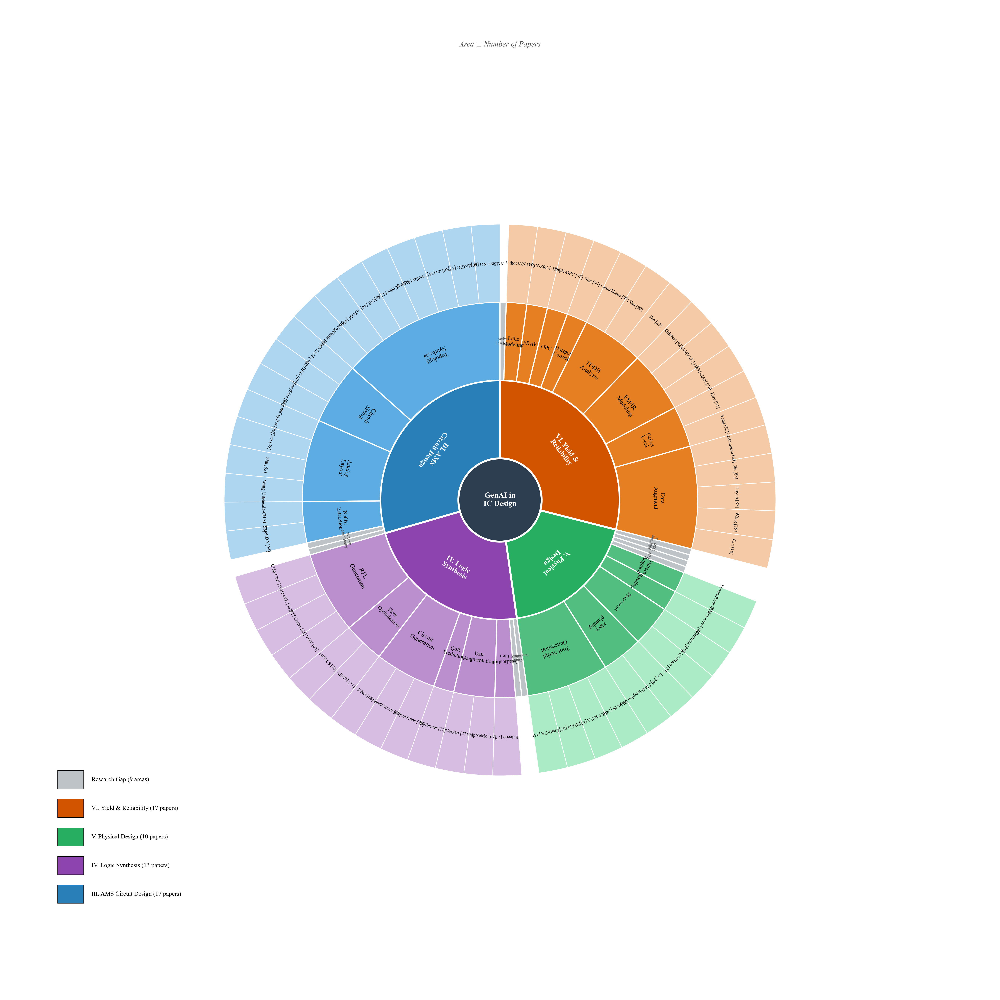


2. B&W version...


C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:685: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.tight_layout()
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:686: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final_bw.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:686: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final_bw.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3874809672.py:687: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_final_bw.png', bbox_inches='tight', dpi=300, facecolor='white')


Saved: fig_genai_final_bw.pdf/.png


C:\Users\12272\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  fig.canvas.print_figure(bytes_io, **kw)


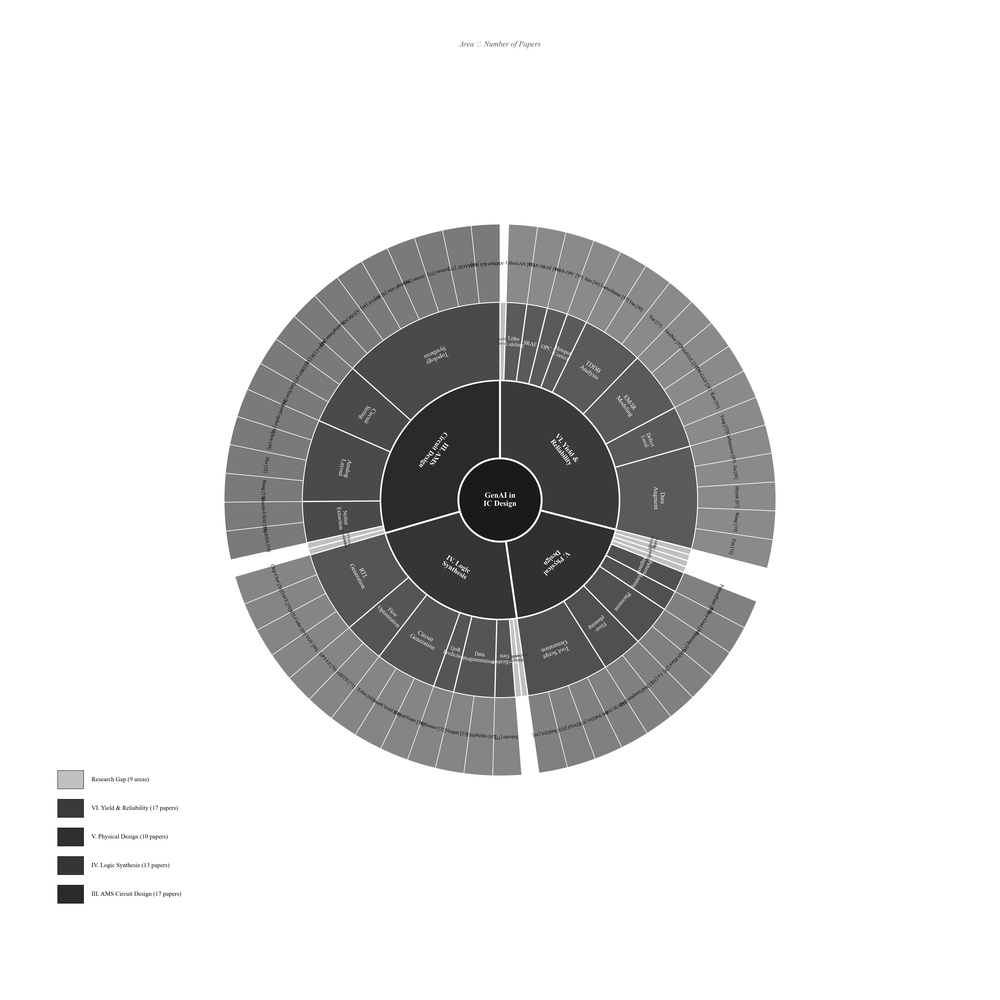


Done!


In [15]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Final Proportional Sunburst - Matching Paper Structure
- Area proportional to paper count
- Empty areas shown for research gaps
- Paper names only (no method abbreviations)
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_proportional_sunburst():
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-1.9, 1.9)
    ax.set_ylim(-1.9, 1.9)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.16
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    colors = {
        'center': '#2C3E50',
        'ams': ['#2980B9', '#5DADE2', '#AED6F1'],
        'logic': ['#8E44AD', '#BB8FCE', '#D7BDE2'],
        'pd': ['#27AE60', '#52BE80', '#ABEBC6'],
        'yield': ['#D35400', '#E67E22', '#F5CBA7'],
        'empty': '#BDC3C7',
    }
    
    EMPTY_SIZE = 0.3
    
    sections = [
        # =====================================================================
        # Part III: AMS Circuit Design (18 papers, 2 gaps)
        # =====================================================================
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'subcats': [
                {
                    'name': 'Topology\nSynthesis',
                    'methods': [
                        'AMSnet-KG [40]',
                        'LaMAGIC [37]',
                        'Artisan [35]',
                        'Atelier [41]',
                        'AnalogCoder [42,43]',
                        'G-VAE [44]',
                        'ATOM [45]',
                        'AnalogGenie [46]',
                    ]
                },
                {
                    'name': 'Circuit\nSizing',
                    'methods': [
                        'ADO-LLM [34]',
                        'LEDRO [47]',
                        'EasySize [48]',
                    ]
                },
                {
                    'name': 'Analog\nLayout',
                    'methods': [
                        'LayoutCopilot [50]',
                        'Chen [49]',
                        'Zhu [52]',
                        'Wang [51]',
                    ]
                },
                {
                    'name': 'Netlist\nExtraction',
                    'methods': [
                        'Masala-CHAI [53]',
                        'DocEDA [54]',
                    ]
                },
                {
                    'name': 'PVT/\nMismatch',
                    'methods': [],
                    'is_empty': True
                },
                {
                    'name': 'Loop\nClosing',
                    'methods': [],
                    'is_empty': True
                },
            ]
        },
        # =====================================================================
        # Part IV: Logic Synthesis (13 papers, 2 gaps)
        # =====================================================================
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'subcats': [
                {
                    'name': 'RTL\nGeneration',
                    'methods': [
                        'Chip-Chat [56]',
                        'DAVE [58]',
                        'RTLCoder [65]',
                        'VGV [66]',
                    ]
                },
                {
                    'name': 'Flow\nOptimization',
                    'methods': [
                        'GPT-LS [70]',
                        'AISYN [71]',
                    ]
                },
                {
                    'name': 'Circuit\nGeneration',
                    'methods': [
                        'T-Net [68]',
                        'ShortCircuit [69]',
                        'CircuitTrans [75]',
                    ]
                },
                {
                    'name': 'QoR\nPrediction',
                    'methods': [
                        'SOformer [72]',
                    ]
                },
                {
                    'name': 'Data\nAugmentation',
                    'methods': [
                        'Vaegan [27]',
                        'ChipNeMo [67]',
                    ]
                },
                {
                    'name': 'Verification\nGen',
                    'methods': [
                        'Salcedo [77]',
                    ]
                },
                {
                    'name': 'Complex\nVertic.',
                    'methods': [],
                    'is_empty': True
                },
                {
                    'name': 'Std\nBenchmark',
                    'methods': [],
                    'is_empty': True
                },
            ]
        },
        # =====================================================================
        # Part V: Physical Design (10 papers, 4 gaps)
        # =====================================================================
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'subcats': [
                {
                    'name': 'Tool Script\nGeneration',
                    'methods': [
                        'ChatEDA [36]',
                        'EDAid [82]',
                        'MCP4EDA [83]',
                        'JARVIS [84]',
                    ]
                },
                {
                    'name': 'Floor-\nplanning',
                    'methods': [
                        'LLM4Floorplan [38]',
                        'Lu [39]',
                    ]
                },
                {
                    'name': 'Placement',
                    'methods': [
                        'GAN-Place [29]',
                        'Painting [85]',
                    ]
                },
                {
                    'name': 'Routing',
                    'methods': [
                        'Policy-Grad [86]',
                    ]
                },
                {
                    'name': 'Pattern\nAugment',
                    'methods': [
                        'PatternPaint [33]',
                    ]
                },
                {
                    'name': 'CTS',
                    'methods': [],
                    'is_empty': True
                },
                {
                    'name': 'Signoff',
                    'methods': [],
                    'is_empty': True
                },
                {
                    'name': 'DRC/\nLVS',
                    'methods': [],
                    'is_empty': True
                },
                {
                    'name': 'Power\nIntegrity',
                    'methods': [],
                    'is_empty': True
                },
            ]
        },
        # =====================================================================
        # Part VI: Yield & Reliability (17 papers, 1 gap)
        # =====================================================================
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'subcats': [
                {
                    'name': 'Data\nAugment',
                    'methods': [
                        'Fan [18]',
                        'Wang [19]',
                        'Huynh [87]',
                        'Jia [88]',
                        'Carbunescu [89]',
                    ]
                },
                {
                    'name': 'Defect\nLocal.',
                    'methods': [
                        'Yang [32]',
                        'Kim [91]',
                    ]
                },
                {
                    'name': 'EM/IR\nModeling',
                    'methods': [
                        'EM-GAN [26]',
                        'GridVAE [21]',
                        'GridNet [92]',
                    ]
                },
                {
                    'name': 'TDDB\nAnalysis',
                    'methods': [
                        'Yan [23]',
                        'Yan [90]',
                        'Lamichhane [93]',
                    ]
                },
                {
                    'name': 'Hotspot\nCorrect',
                    'methods': [
                        'Sim [94]',
                    ]
                },
                {
                    'name': 'OPC',
                    'methods': [
                        'GAN-OPC [95]',
                    ]
                },
                {
                    'name': 'SRAF',
                    'methods': [
                        'GAN-SRAF [96]',
                    ]
                },
                {
                    'name': 'Litho\nModeling',
                    'methods': [
                        'LithoGAN [97]',
                    ]
                },
                {
                    'name': 'Active\nLearning',
                    'methods': [],
                    'is_empty': True
                },
            ]
        },
    ]
    
    # =========================================================================
    # Calculate counts
    # =========================================================================
    def count_papers(section):
        total = 0
        for subcat in section['subcats']:
            if subcat.get('is_empty', False):
                total += EMPTY_SIZE
            else:
                total += len(subcat['methods'])
        return total
    
    def count_actual(section):
        return sum(len(s['methods']) for s in section['subcats'] if not s.get('is_empty', False))
    
    def count_empty(section):
        return sum(1 for s in section['subcats'] if s.get('is_empty', False))
    
    section_counts = [count_papers(s) for s in sections]
    total_papers = sum(section_counts)
    
    print("\n" + "="*60)
    print("📊 FINAL PAPER DISTRIBUTION")
    print("="*60)
    for s in sections:
        actual = count_actual(s)
        empty = count_empty(s)
        name = s['name'].replace('\n', ' ')
        print(f"  {name}: {actual} papers, {empty} gaps")
    print("-"*60)
    print(f"  TOTAL: {sum(count_actual(s) for s in sections)} papers, {sum(count_empty(s) for s in sections)} gaps")
    print("="*60)
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # =========================================================================
    # HELPER FUNCTIONS
    # =========================================================================
    def get_text_rotation(angle):
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    start_angle = 90
    current_section_angle = start_angle
    
    for sec_idx, section in enumerate(sections):
        sec_paper_count = section_counts[sec_idx]
        section_span = (sec_paper_count / total_papers) * 360
        
        sec_start = current_section_angle
        sec_end = sec_start + section_span
        sec_colors = colors[section['key']]
        
        # Layer 1: Section
        wedge1 = patches.Wedge(
            (0, 0), r1, sec_start, sec_end,
            width=ring_width,
            facecolor=sec_colors[0],
            edgecolor='white', linewidth=2.5
        )
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_span / 2
        draw_label(ax, mid_angle, r0, r1, section['name'], 
                   fontsize=9, color='white', bold=True)
        
        # Layer 2: Subsections
        current_subcat_angle = sec_start
        
        for subcat in section['subcats']:
            is_empty = subcat.get('is_empty', False)
            n_methods = len(subcat['methods']) if not is_empty else EMPTY_SIZE
            
            subcat_span = (n_methods / sec_paper_count) * section_span
            sub_start = current_subcat_angle
            sub_end = sub_start + subcat_span
            
            sub_color = colors['empty'] if is_empty else sec_colors[1]
            
            wedge2 = patches.Wedge(
                (0, 0), r2, sub_start, sub_end,
                width=ring_width,
                facecolor=sub_color,
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            mid_angle = sub_start + subcat_span / 2
            
            if is_empty:
                fontsize = 5 if subcat_span < 5 else 6
                draw_label(ax, mid_angle, r1, r2, subcat['name'], 
                           fontsize=fontsize, color='#555555')
            else:
                fontsize = 7 if subcat_span < 15 else 8
                draw_label(ax, mid_angle, r1, r2, subcat['name'], 
                           fontsize=fontsize, color='black')
            
            # Layer 3: Papers
            if not is_empty and len(subcat['methods']) > 0:
                method_span = subcat_span / len(subcat['methods'])
                current_method_angle = sub_start
                
                for method_name in subcat['methods']:
                    m_start = current_method_angle
                    m_end = m_start + method_span
                    
                    wedge3 = patches.Wedge(
                        (0, 0), r3, m_start, m_end,
                        width=ring_width,
                        facecolor=sec_colors[2],
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge3)
                    
                    mid_angle = m_start + method_span / 2
                    fontsize = 5 if method_span < 5 else (6 if method_span < 8 else 7)
                    draw_label(ax, mid_angle, r2, r3, method_name, fontsize=fontsize)
                    
                    current_method_angle = m_end
            
            current_subcat_angle = sub_end
        
        current_section_angle = sec_end
    
    # =========================================================================
    # LEGEND
    # =========================================================================
    legend_items = [
        (colors['ams'][0], f'III. AMS Circuit Design ({count_actual(sections[0])} papers)'),
        (colors['logic'][0], f'IV. Logic Synthesis ({count_actual(sections[1])} papers)'),
        (colors['pd'][0], f'V. Physical Design ({count_actual(sections[2])} papers)'),
        (colors['yield'][0], f'VI. Yield & Reliability ({count_actual(sections[3])} papers)'),
        (colors['empty'], f'Research Gap ({sum(count_empty(s) for s in sections)} areas)'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.7
        y = -1.55 + i * 0.11
        rect = patches.Rectangle((x, y), 0.1, 0.07,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.13, y + 0.035, label, ha='left', va='center', fontsize=8)
    
    ax.text(0, 1.75, 'Area ∝ Number of Papers', ha='center', va='center', 
            fontsize=10, style='italic', color='#555555')
    
    plt.tight_layout()
    plt.savefig('fig_genai_final.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_final.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("\nSaved: fig_genai_final.pdf/.png")
    plt.show()


def draw_proportional_sunburst_bw():
    """Grayscale version"""
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-1.9, 1.9)
    ax.set_ylim(-1.9, 1.9)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.16
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    grays = {
        'center': '#1a1a1a',
        'ams': ['#2a2a2a', '#4a4a4a', '#7a7a7a'],
        'logic': ['#353535', '#555555', '#858585'],
        'pd': ['#303030', '#505050', '#808080'],
        'yield': ['#3a3a3a', '#5a5a5a', '#8a8a8a'],
        'empty': '#C0C0C0',
    }
    
    EMPTY_SIZE = 0.3
    
    sections = [
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'subcats': [
                {'name': 'Topology\nSynthesis', 'methods': ['AMSnet-KG [40]', 'LaMAGIC [37]', 'Artisan [35]', 'Atelier [41]', 'AnalogCoder [42,43]', 'G-VAE [44]', 'ATOM [45]', 'AnalogGenie [46]']},
                {'name': 'Circuit\nSizing', 'methods': ['ADO-LLM [34]', 'LEDRO [47]', 'EasySize [48]']},
                {'name': 'Analog\nLayout', 'methods': ['LayoutCopilot [50]', 'Chen [49]', 'Zhu [52]', 'Wang [51]']},
                {'name': 'Netlist\nExtraction', 'methods': ['Masala-CHAI [53]', 'DocEDA [54]']},
                {'name': 'PVT/\nMismatch', 'methods': [], 'is_empty': True},
                {'name': 'Loop\nClosing', 'methods': [], 'is_empty': True},
            ]
        },
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'subcats': [
                {'name': 'RTL\nGeneration', 'methods': ['Chip-Chat [56]', 'DAVE [58]', 'RTLCoder [65]', 'VGV [66]']},
                {'name': 'Flow\nOptimization', 'methods': ['GPT-LS [70]', 'AISYN [71]']},
                {'name': 'Circuit\nGeneration', 'methods': ['T-Net [68]', 'ShortCircuit [69]', 'CircuitTrans [75]']},
                {'name': 'QoR\nPrediction', 'methods': ['SOformer [72]']},
                {'name': 'Data\nAugmentation', 'methods': ['Vaegan [27]', 'ChipNeMo [67]']},
                {'name': 'Verification\nGen', 'methods': ['Salcedo [77]']},
                {'name': 'Complex\nVerific.', 'methods': [], 'is_empty': True},
                {'name': 'Std\nBenchmark', 'methods': [], 'is_empty': True},
            ]
        },
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'subcats': [
                {'name': 'Tool Script\nGeneration', 'methods': ['ChatEDA [36]', 'EDAid [82]', 'MCP4EDA [83]', 'JARVIS [84]']},
                {'name': 'Floor-\nplanning', 'methods': ['LLM4Floorplan [38]', 'Lu [39]']},
                {'name': 'Placement', 'methods': ['GAN-Place [29]', 'Painting [85]']},
                {'name': 'Routing', 'methods': ['Policy-Grad [86]']},
                {'name': 'Pattern\nAugment', 'methods': ['PatternPaint [33]']},
                {'name': 'CTS', 'methods': [], 'is_empty': True},
                {'name': 'Signoff', 'methods': [], 'is_empty': True},
                {'name': 'DRC/\nLVS', 'methods': [], 'is_empty': True},
                {'name': 'Power\nIntegrity', 'methods': [], 'is_empty': True},
            ]
        },
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'subcats': [
                {'name': 'Data\nAugment', 'methods': ['Fan [18]', 'Wang [19]', 'Huynh [87]', 'Jia [88]', 'Carbunescu [89]']},
                {'name': 'Defect\nLocal.', 'methods': ['Yang [32]', 'Kim [91]']},
                {'name': 'EM/IR\nModeling', 'methods': ['EM-GAN [26]', 'GridVAE [21]', 'GridNet [92]']},
                {'name': 'TDDB\nAnalysis', 'methods': ['Yan [23]', 'Yan [90]', 'Lamichhane [93]']},
                {'name': 'Hotspot\nCorrect', 'methods': ['Sim [94]']},
                {'name': 'OPC', 'methods': ['GAN-OPC [95]']},
                {'name': 'SRAF', 'methods': ['GAN-SRAF [96]']},
                {'name': 'Litho\nModeling', 'methods': ['LithoGAN [97]']},
                {'name': 'Active\nLearning', 'methods': [], 'is_empty': True},
            ]
        },
    ]
    
    def count_papers(section):
        total = 0
        for subcat in section['subcats']:
            if subcat.get('is_empty', False):
                total += EMPTY_SIZE
            else:
                total += len(subcat['methods'])
        return total
    
    def count_actual(section):
        return sum(len(s['methods']) for s in section['subcats'] if not s.get('is_empty', False))
    
    def count_empty(section):
        return sum(1 for s in section['subcats'] if s.get('is_empty', False))
    
    section_counts = [count_papers(s) for s in sections]
    total_papers = sum(section_counts)
    
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    def get_text_rotation(angle):
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 180 - 90
        return angle - 90
    
    def draw_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_text_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    start_angle = 90
    current_section_angle = start_angle
    
    for sec_idx, section in enumerate(sections):
        sec_paper_count = section_counts[sec_idx]
        section_span = (sec_paper_count / total_papers) * 360
        
        sec_start = current_section_angle
        sec_end = sec_start + section_span
        sec_colors = grays[section['key']]
        
        wedge1 = patches.Wedge((0, 0), r1, sec_start, sec_end,
                                width=ring_width, facecolor=sec_colors[0],
                                edgecolor='white', linewidth=2.5)
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_span / 2
        draw_label(ax, mid_angle, r0, r1, section['name'], fontsize=9, color='white', bold=True)
        
        current_subcat_angle = sec_start
        
        for subcat in section['subcats']:
            is_empty = subcat.get('is_empty', False)
            n_methods = len(subcat['methods']) if not is_empty else EMPTY_SIZE
            
            subcat_span = (n_methods / sec_paper_count) * section_span
            sub_start = current_subcat_angle
            sub_end = sub_start + subcat_span
            
            sub_color = grays['empty'] if is_empty else sec_colors[1]
            
            wedge2 = patches.Wedge((0, 0), r2, sub_start, sub_end,
                                    width=ring_width, facecolor=sub_color,
                                    edgecolor='white', linewidth=1.5)
            ax.add_patch(wedge2)
            
            mid_angle = sub_start + subcat_span / 2
            
            if is_empty:
                fontsize = 5 if subcat_span < 5 else 6
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=fontsize, color='#333333')
            else:
                fontsize = 7 if subcat_span < 15 else 8
                draw_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=fontsize, color='white')
            
            if not is_empty and len(subcat['methods']) > 0:
                method_span = subcat_span / len(subcat['methods'])
                current_method_angle = sub_start
                
                for method_name in subcat['methods']:
                    m_start = current_method_angle
                    m_end = m_start + method_span
                    
                    wedge3 = patches.Wedge((0, 0), r3, m_start, m_end,
                                            width=ring_width, facecolor=sec_colors[2],
                                            edgecolor='white', linewidth=0.8)
                    ax.add_patch(wedge3)
                    
                    mid_angle = m_start + method_span / 2
                    fontsize = 5 if method_span < 5 else (6 if method_span < 8 else 7)
                    draw_label(ax, mid_angle, r2, r3, method_name, fontsize=fontsize)
                    
                    current_method_angle = m_end
            
            current_subcat_angle = sub_end
        
        current_section_angle = sec_end
    
    legend_items = [
        (grays['ams'][0], f'III. AMS Circuit Design ({count_actual(sections[0])} papers)'),
        (grays['logic'][0], f'IV. Logic Synthesis ({count_actual(sections[1])} papers)'),
        (grays['pd'][0], f'V. Physical Design ({count_actual(sections[2])} papers)'),
        (grays['yield'][0], f'VI. Yield & Reliability ({count_actual(sections[3])} papers)'),
        (grays['empty'], f'Research Gap ({sum(count_empty(s) for s in sections)} areas)'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.7
        y = -1.55 + i * 0.11
        rect = patches.Rectangle((x, y), 0.1, 0.07,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.13, y + 0.035, label, ha='left', va='center', fontsize=8)
    
    ax.text(0, 1.75, 'Area ∝ Number of Papers', ha='center', va='center', 
            fontsize=10, style='italic', color='#555555')
    
    plt.tight_layout()
    plt.savefig('fig_genai_final_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_final_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_genai_final_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("\n" + "="*60)
    print("FINAL GenAI in IC Design Sunburst")
    print("="*60)
    
    print("\n1. Color version...")
    draw_proportional_sunburst()
    
    print("\n2. B&W version...")
    draw_proportional_sunburst_bw()
    
    print("\nDone!")


GenAI Sunburst with RADIAL text orientation
- Layer 1: Tangential (follows arc)
- Layer 2 & 3: Radial (perpendicular to arc)

1. Color version...


C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:291: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.tight_layout()
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:292: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:292: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:293: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial.png', bbox_inches='tight', dpi=300, facecolor='white')



Saved: fig_genai_radial.pdf/.png


C:\Users\12272\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  fig.canvas.print_figure(bytes_io, **kw)


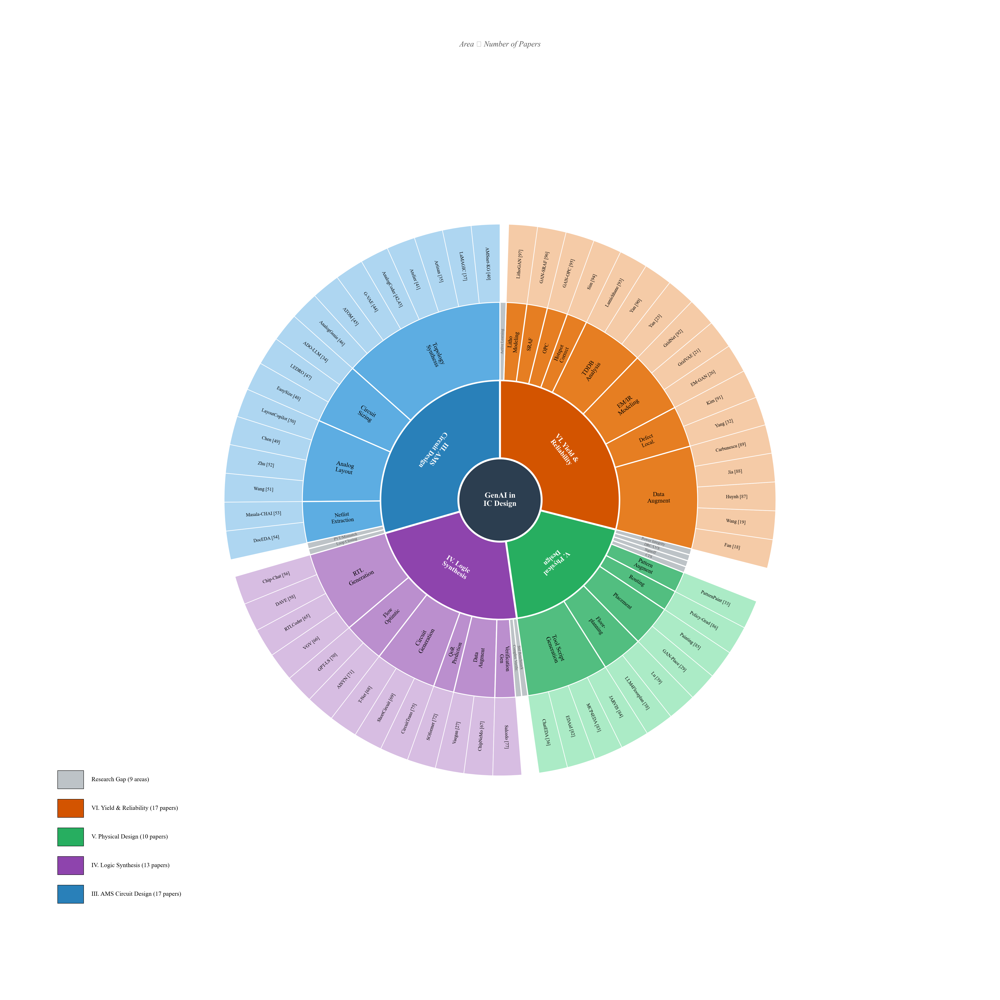


2. B&W version...


C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:510: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.tight_layout()
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:511: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial_bw.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:511: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial_bw.pdf', bbox_inches='tight', dpi=300)
C:\Users\12272\AppData\Local\Temp\ipykernel_3192\3558755051.py:512: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  plt.savefig('fig_genai_radial_bw.png', bbox_inches='tight', dpi=300, facecolor='white')


Saved: fig_genai_radial_bw.pdf/.png


C:\Users\12272\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8733 (\N{PROPORTIONAL TO}) missing from font(s) Times New Roman.
  fig.canvas.print_figure(bytes_io, **kw)


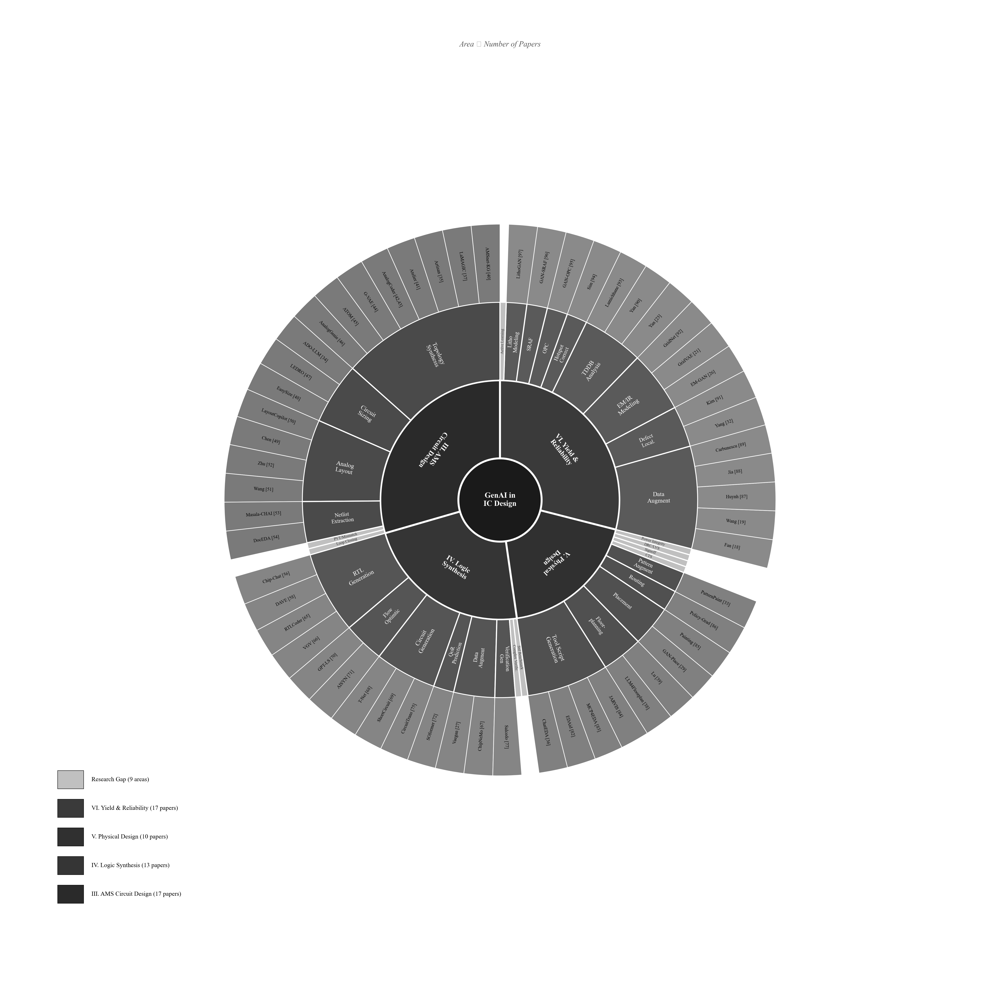


Done!


In [18]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Final Sunburst with improved readability:
- Layer 1 (sections): Keep tangential text (follows the arc)
- Layer 2 & 3: Radial text (perpendicular to arc, pointing outward)
- Left side: heads face toward top Y-axis, counter-clockwise rotation
- Right side: heads face toward top Y-axis, clockwise rotation
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_proportional_sunburst():
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-1.9, 1.9)
    ax.set_ylim(-1.9, 1.9)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.16
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    colors = {
        'center': '#2C3E50',
        'ams': ['#2980B9', '#5DADE2', '#AED6F1'],
        'logic': ['#8E44AD', '#BB8FCE', '#D7BDE2'],
        'pd': ['#27AE60', '#52BE80', '#ABEBC6'],
        'yield': ['#D35400', '#E67E22', '#F5CBA7'],
        'empty': '#BDC3C7',
    }
    
    EMPTY_SIZE = 0.3
    
    sections = [
        # Part III: AMS Circuit Design
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'subcats': [
                {'name': 'Topology\nSynthesis', 'methods': ['AMSnet-KG [40]', 'LaMAGIC [37]', 'Artisan [35]', 'Atelier [41]', 'AnalogCoder [42,43]', 'G-VAE [44]', 'ATOM [45]', 'AnalogGenie [46]']},
                {'name': 'Circuit\nSizing', 'methods': ['ADO-LLM [34]', 'LEDRO [47]', 'EasySize [48]']},
                {'name': 'Analog\nLayout', 'methods': ['LayoutCopilot [50]', 'Chen [49]', 'Zhu [52]', 'Wang [51]']},
                {'name': 'Netlist\nExtraction', 'methods': ['Masala-CHAI [53]', 'DocEDA [54]']},
                {'name': 'PVT/Mismatch', 'methods': [], 'is_empty': True},
                {'name': 'Loop Closing', 'methods': [], 'is_empty': True},
            ]
        },
        # Part IV: Logic Synthesis
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'subcats': [
                {'name': 'RTL\nGeneration', 'methods': ['Chip-Chat [56]', 'DAVE [58]', 'RTLCoder [65]', 'VGV [66]']},
                {'name': 'Flow\nOptimtic', 'methods': ['GPT-LS [70]', 'AISYN [71]']},
                {'name': 'Circuit\nGeneration', 'methods': ['T-Net [68]', 'ShortCircuit [69]', 'CircuitTrans [75]']},
                {'name': 'QoR\nPrediction', 'methods': ['SOformer [72]']},
                {'name': 'Data\nAugment', 'methods': ['Vaegan [27]', 'ChipNeMo [67]']},
                {'name': 'Verification\nGen', 'methods': ['Salcedo [77]']},
                {'name': 'Complex Verific.', 'methods': [], 'is_empty': True},
                {'name': 'Std Benchmark', 'methods': [], 'is_empty': True},
            ]
        },
        # Part V: Physical Design
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'subcats': [
                {'name': 'Tool Script\nGeneration', 'methods': ['ChatEDA [36]', 'EDAid [82]', 'MCP4EDA [83]', 'JARVIS [84]']},
                {'name': 'Floor-\nplanning', 'methods': ['LLM4Floorplan [38]', 'Lu [39]']},
                {'name': 'Placement', 'methods': ['GAN-Place [29]', 'Painting [85]']},
                {'name': 'Routing', 'methods': ['Policy-Grad [86]']},
                {'name': 'Pattern\nAugment', 'methods': ['PatternPaint [33]']},
                {'name': 'CTS', 'methods': [], 'is_empty': True},
                {'name': 'Signoff', 'methods': [], 'is_empty': True},
                {'name': 'DRC/LVS', 'methods': [], 'is_empty': True},
                {'name': 'Power Integrity', 'methods': [], 'is_empty': True},
            ]
        },
        # Part VI: Yield & Reliability
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'subcats': [
                {'name': 'Data\nAugment', 'methods': ['Fan [18]', 'Wang [19]', 'Huynh [87]', 'Jia [88]', 'Carbunescu [89]']},
                {'name': 'Defect\nLocal.', 'methods': ['Yang [32]', 'Kim [91]']},
                {'name': 'EM/IR\nModeling', 'methods': ['EM-GAN [26]', 'GridVAE [21]', 'GridNet [92]']},
                {'name': 'TDDB\nAnalysis', 'methods': ['Yan [23]', 'Yan [90]', 'Lamichhane [93]']},
                {'name': 'Hotspot\nCorrect', 'methods': ['Sim [94]']},
                {'name': 'OPC', 'methods': ['GAN-OPC [95]']},
                {'name': 'SRAF', 'methods': ['GAN-SRAF [96]']},
                {'name': 'Litho\nModeling', 'methods': ['LithoGAN [97]']},
                {'name': 'Active Learning', 'methods': [], 'is_empty': True},
            ]
        },
    ]
    
    def count_papers(section):
        total = 0
        for subcat in section['subcats']:
            if subcat.get('is_empty', False):
                total += EMPTY_SIZE
            else:
                total += len(subcat['methods'])
        return total
    
    def count_actual(section):
        return sum(len(s['methods']) for s in section['subcats'] if not s.get('is_empty', False))
    
    def count_empty(section):
        return sum(1 for s in section['subcats'] if s.get('is_empty', False))
    
    section_counts = [count_papers(s) for s in sections]
    total_papers = sum(section_counts)
    
    # =========================================================================
    # TEXT ROTATION FUNCTIONS
    # =========================================================================
    def get_tangential_rotation(angle):
        """Layer 1: Tangential text (follows the arc) - KEEP SAME"""
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 180 - 90  # = angle + 90
        return angle - 90
    
    def get_radial_rotation(angle):
        """Layer 2 & 3: Radial text (perpendicular to arc, pointing outward)
        - Left side (90° < angle <= 270°): head faces toward top, counter-clockwise feel
        - Right side: head faces toward top, clockwise feel
        """
        angle = angle % 360
        if 90 < angle <= 270:
            # Left side - text reads from outside toward center
            # Head of letters should point toward right (toward top Y-axis)
            return angle - 180
        else:
            # Right side - text reads from center toward outside
            # Head of letters should point toward left (toward top Y-axis)
            return angle
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    # =========================================================================
    # LABEL DRAWING FUNCTIONS
    # =========================================================================
    def draw_tangential_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        """For Layer 1 - tangential orientation"""
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_tangential_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    def draw_radial_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        """For Layer 2 & 3 - radial orientation (perpendicular to arc)"""
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_radial_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    start_angle = 90
    current_section_angle = start_angle
    
    for sec_idx, section in enumerate(sections):
        sec_paper_count = section_counts[sec_idx]
        section_span = (sec_paper_count / total_papers) * 360
        
        sec_start = current_section_angle
        sec_end = sec_start + section_span
        sec_colors = colors[section['key']]
        
        # ===== Layer 1: Section (TANGENTIAL - same as before) =====
        wedge1 = patches.Wedge(
            (0, 0), r1, sec_start, sec_end,
            width=ring_width,
            facecolor=sec_colors[0],
            edgecolor='white', linewidth=2.5
        )
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_span / 2
        draw_tangential_label(ax, mid_angle, r0, r1, section['name'], 
                              fontsize=9, color='white', bold=True)
        
        # ===== Layer 2: Subsections (RADIAL) =====
        current_subcat_angle = sec_start
        
        for subcat in section['subcats']:
            is_empty = subcat.get('is_empty', False)
            n_methods = len(subcat['methods']) if not is_empty else EMPTY_SIZE
            
            subcat_span = (n_methods / sec_paper_count) * section_span
            sub_start = current_subcat_angle
            sub_end = sub_start + subcat_span
            
            sub_color = colors['empty'] if is_empty else sec_colors[1]
            
            wedge2 = patches.Wedge(
                (0, 0), r2, sub_start, sub_end,
                width=ring_width,
                facecolor=sub_color,
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            mid_angle = sub_start + subcat_span / 2
            
            if is_empty:
                fontsize = 5 if subcat_span < 5 else 6
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], 
                                  fontsize=fontsize, color='#555555')
            else:
                fontsize = 7 if subcat_span < 15 else 8
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], 
                                  fontsize=fontsize, color='black')
            
            # ===== Layer 3: Papers (RADIAL) =====
            if not is_empty and len(subcat['methods']) > 0:
                method_span = subcat_span / len(subcat['methods'])
                current_method_angle = sub_start
                
                for method_name in subcat['methods']:
                    m_start = current_method_angle
                    m_end = m_start + method_span
                    
                    wedge3 = patches.Wedge(
                        (0, 0), r3, m_start, m_end,
                        width=ring_width,
                        facecolor=sec_colors[2],
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge3)
                    
                    mid_angle = m_start + method_span / 2
                    fontsize = 5 if method_span < 5 else (6 if method_span < 8 else 7)
                    draw_radial_label(ax, mid_angle, r2, r3, method_name, fontsize=fontsize)
                    
                    current_method_angle = m_end
            
            current_subcat_angle = sub_end
        
        current_section_angle = sec_end
    
    # =========================================================================
    # LEGEND
    # =========================================================================
    legend_items = [
        (colors['ams'][0], f'III. AMS Circuit Design ({count_actual(sections[0])} papers)'),
        (colors['logic'][0], f'IV. Logic Synthesis ({count_actual(sections[1])} papers)'),
        (colors['pd'][0], f'V. Physical Design ({count_actual(sections[2])} papers)'),
        (colors['yield'][0], f'VI. Yield & Reliability ({count_actual(sections[3])} papers)'),
        (colors['empty'], f'Research Gap ({sum(count_empty(s) for s in sections)} areas)'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.7
        y = -1.55 + i * 0.11
        rect = patches.Rectangle((x, y), 0.1, 0.07,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.13, y + 0.035, label, ha='left', va='center', fontsize=8)
    
    ax.text(0, 1.75, 'Area ∝ Number of Papers', ha='center', va='center', 
            fontsize=10, style='italic', color='#555555')
    
    plt.tight_layout()
    plt.savefig('fig_genai_radial.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_radial.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("\nSaved: fig_genai_radial.pdf/.png")
    plt.show()


def draw_proportional_sunburst_bw():
    """Grayscale version with radial text"""
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-1.9, 1.9)
    ax.set_ylim(-1.9, 1.9)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.16
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    grays = {
        'center': '#1a1a1a',
        'ams': ['#2a2a2a', '#4a4a4a', '#7a7a7a'],
        'logic': ['#353535', '#555555', '#858585'],
        'pd': ['#303030', '#505050', '#808080'],
        'yield': ['#3a3a3a', '#5a5a5a', '#8a8a8a'],
        'empty': '#C0C0C0',
    }
    
    EMPTY_SIZE = 0.3
    
    sections = [
        {'name': 'III. AMS\nCircuit Design', 'key': 'ams', 'subcats': [
            {'name': 'Topology\nSynthesis', 'methods': ['AMSnet-KG [40]', 'LaMAGIC [37]', 'Artisan [35]', 'Atelier [41]', 'AnalogCoder [42,43]', 'G-VAE [44]', 'ATOM [45]', 'AnalogGenie [46]']},
            {'name': 'Circuit\nSizing', 'methods': ['ADO-LLM [34]', 'LEDRO [47]', 'EasySize [48]']},
            {'name': 'Analog\nLayout', 'methods': ['LayoutCopilot [50]', 'Chen [49]', 'Zhu [52]', 'Wang [51]']},
            {'name': 'Netlist\nExtraction', 'methods': ['Masala-CHAI [53]', 'DocEDA [54]']},
            {'name': 'PVT/Mismatch', 'methods': [], 'is_empty': True},
            {'name': 'Loop Closing', 'methods': [], 'is_empty': True},
        ]},
        {'name': 'IV. Logic\nSynthesis', 'key': 'logic', 'subcats': [
            {'name': 'RTL\nGeneration', 'methods': ['Chip-Chat [56]', 'DAVE [58]', 'RTLCoder [65]', 'VGV [66]']},
            {'name': 'Flow\nOptimtic', 'methods': ['GPT-LS [70]', 'AISYN [71]']},
            {'name': 'Circuit\nGeneration', 'methods': ['T-Net [68]', 'ShortCircuit [69]', 'CircuitTrans [75]']},
            {'name': 'QoR\nPrediction', 'methods': ['SOformer [72]']},
            {'name': 'Data\nAugment', 'methods': ['Vaegan [27]', 'ChipNeMo [67]']},
            {'name': 'Verification\nGen', 'methods': ['Salcedo [77]']},
            {'name': 'Complex Verific.', 'methods': [], 'is_empty': True},
            {'name': 'Std Benchmark', 'methods': [], 'is_empty': True},
        ]},
        {'name': 'V. Physical\nDesign', 'key': 'pd', 'subcats': [
            {'name': 'Tool Script\nGeneration', 'methods': ['ChatEDA [36]', 'EDAid [82]', 'MCP4EDA [83]', 'JARVIS [84]']},
            {'name': 'Floor-\nplanning', 'methods': ['LLM4Floorplan [38]', 'Lu [39]']},
            {'name': 'Placement', 'methods': ['GAN-Place [29]', 'Painting [85]']},
            {'name': 'Routing', 'methods': ['Policy-Grad [86]']},
            {'name': 'Pattern\nAugment', 'methods': ['PatternPaint [33]']},
            {'name': 'CTS', 'methods': [], 'is_empty': True},
            {'name': 'Signoff', 'methods': [], 'is_empty': True},
            {'name': 'DRC/LVS', 'methods': [], 'is_empty': True},
            {'name': 'Power Integrity', 'methods': [], 'is_empty': True},
        ]},
        {'name': 'VI. Yield &\nReliability', 'key': 'yield', 'subcats': [
            {'name': 'Data\nAugment', 'methods': ['Fan [18]', 'Wang [19]', 'Huynh [87]', 'Jia [88]', 'Carbunescu [89]']},
            {'name': 'Defect\nLocal.', 'methods': ['Yang [32]', 'Kim [91]']},
            {'name': 'EM/IR\nModeling', 'methods': ['EM-GAN [26]', 'GridVAE [21]', 'GridNet [92]']},
            {'name': 'TDDB\nAnalysis', 'methods': ['Yan [23]', 'Yan [90]', 'Lamichhane [93]']},
            {'name': 'Hotspot\nCorrect', 'methods': ['Sim [94]']},
            {'name': 'OPC', 'methods': ['GAN-OPC [95]']},
            {'name': 'SRAF', 'methods': ['GAN-SRAF [96]']},
            {'name': 'Litho\nModeling', 'methods': ['LithoGAN [97]']},
            {'name': 'Active Learning', 'methods': [], 'is_empty': True},
        ]},
    ]
    
    def count_papers(section):
        total = 0
        for subcat in section['subcats']:
            if subcat.get('is_empty', False):
                total += EMPTY_SIZE
            else:
                total += len(subcat['methods'])
        return total
    
    def count_actual(section):
        return sum(len(s['methods']) for s in section['subcats'] if not s.get('is_empty', False))
    
    def count_empty(section):
        return sum(1 for s in section['subcats'] if s.get('is_empty', False))
    
    section_counts = [count_papers(s) for s in sections]
    total_papers = sum(section_counts)
    
    def get_tangential_rotation(angle):
        angle = angle % 360
        if 90 < angle < 270:
            return angle + 90
        return angle - 90
    
    def get_radial_rotation(angle):
        angle = angle % 360
        if 90 < angle <= 270:
            return angle - 180
        else:
            return angle
    
    center = plt.Circle((0, 0), r_center, facecolor=grays['center'], edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=10, fontweight='bold', color='white')
    
    def draw_tangential_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_tangential_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    def draw_radial_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_radial_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    start_angle = 90
    current_section_angle = start_angle
    
    for sec_idx, section in enumerate(sections):
        sec_paper_count = section_counts[sec_idx]
        section_span = (sec_paper_count / total_papers) * 360
        
        sec_start = current_section_angle
        sec_end = sec_start + section_span
        sec_colors = grays[section['key']]
        
        wedge1 = patches.Wedge((0, 0), r1, sec_start, sec_end,
                                width=ring_width, facecolor=sec_colors[0],
                                edgecolor='white', linewidth=2.5)
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_span / 2
        draw_tangential_label(ax, mid_angle, r0, r1, section['name'], fontsize=9, color='white', bold=True)
        
        current_subcat_angle = sec_start
        
        for subcat in section['subcats']:
            is_empty = subcat.get('is_empty', False)
            n_methods = len(subcat['methods']) if not is_empty else EMPTY_SIZE
            
            subcat_span = (n_methods / sec_paper_count) * section_span
            sub_start = current_subcat_angle
            sub_end = sub_start + subcat_span
            
            sub_color = grays['empty'] if is_empty else sec_colors[1]
            
            wedge2 = patches.Wedge((0, 0), r2, sub_start, sub_end,
                                    width=ring_width, facecolor=sub_color,
                                    edgecolor='white', linewidth=1.5)
            ax.add_patch(wedge2)
            
            mid_angle = sub_start + subcat_span / 2
            
            if is_empty:
                fontsize = 5 if subcat_span < 5 else 6
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=fontsize, color='#333333')
            else:
                fontsize = 7 if subcat_span < 15 else 8
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], fontsize=fontsize, color='white')
            
            if not is_empty and len(subcat['methods']) > 0:
                method_span = subcat_span / len(subcat['methods'])
                current_method_angle = sub_start
                
                for method_name in subcat['methods']:
                    m_start = current_method_angle
                    m_end = m_start + method_span
                    
                    wedge3 = patches.Wedge((0, 0), r3, m_start, m_end,
                                            width=ring_width, facecolor=sec_colors[2],
                                            edgecolor='white', linewidth=0.8)
                    ax.add_patch(wedge3)
                    
                    mid_angle = m_start + method_span / 2
                    fontsize = 5 if method_span < 5 else (6 if method_span < 8 else 7)
                    draw_radial_label(ax, mid_angle, r2, r3, method_name, fontsize=fontsize)
                    
                    current_method_angle = m_end
            
            current_subcat_angle = sub_end
        
        current_section_angle = sec_end
    
    legend_items = [
        (grays['ams'][0], f'III. AMS Circuit Design ({count_actual(sections[0])} papers)'),
        (grays['logic'][0], f'IV. Logic Synthesis ({count_actual(sections[1])} papers)'),
        (grays['pd'][0], f'V. Physical Design ({count_actual(sections[2])} papers)'),
        (grays['yield'][0], f'VI. Yield & Reliability ({count_actual(sections[3])} papers)'),
        (grays['empty'], f'Research Gap ({sum(count_empty(s) for s in sections)} areas)'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.7
        y = -1.55 + i * 0.11
        rect = patches.Rectangle((x, y), 0.1, 0.07,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.13, y + 0.035, label, ha='left', va='center', fontsize=8)
    
    ax.text(0, 1.75, 'Area ∝ Number of Papers', ha='center', va='center', 
            fontsize=10, style='italic', color='#555555')
    
    plt.tight_layout()
    plt.savefig('fig_genai_radial_bw.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_radial_bw.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("Saved: fig_genai_radial_bw.pdf/.png")
    plt.show()


if __name__ == "__main__":
    print("\n" + "="*60)
    print("GenAI Sunburst with RADIAL text orientation")
    print("- Layer 1: Tangential (follows arc)")
    print("- Layer 2 & 3: Radial (perpendicular to arc)")
    print("="*60)
    
    print("\n1. Color version...")
    draw_proportional_sunburst()
    
    print("\n2. B&W version...")
    draw_proportional_sunburst_bw()
    
    print("\nDone!")


GenAI Sunburst with RADIAL text orientation
- Layer 1: Tangential (follows arc) - REVERSED for III and V
- Layer 2 & 3: Radial (perpendicular to arc)

1. Color version...

Saved: fig_genai_radial.pdf/.png


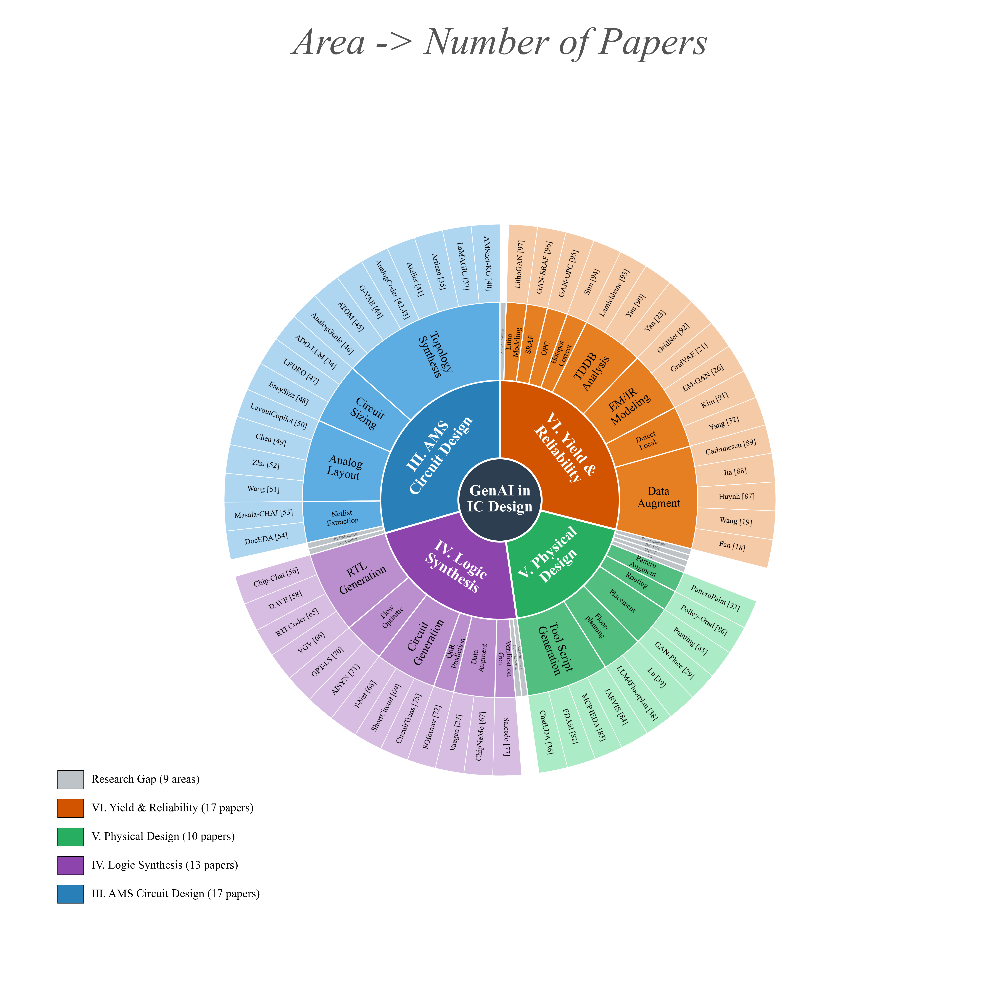


Done!


In [27]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

"""
Final Sunburst with improved readability:
- Layer 1 (sections): Keep tangential text (follows the arc)
- Layer 2 & 3: Radial text (perpendicular to arc, pointing outward)
- Left side: heads face toward top Y-axis, counter-clockwise rotation
- Right side: heads face toward top Y-axis, clockwise rotation
- MODIFIED: Reversed text orientation for Section III and Section V headers only.
"""

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman', 'DejaVu Serif']
plt.rcParams['font.size'] = 9


def draw_proportional_sunburst():
    fig, ax = plt.subplots(figsize=(18, 18))
    ax.set_xlim(-1.9, 1.9)
    ax.set_ylim(-1.9, 1.9)
    ax.set_aspect('equal')
    ax.axis('off')
    
    r_center = 0.16
    ring_width = 0.30
    r0 = r_center
    r1 = r0 + ring_width
    r2 = r1 + ring_width
    r3 = r2 + ring_width
    
    colors = {
        'center': '#2C3E50',
        'ams': ['#2980B9', '#5DADE2', '#AED6F1'],
        'logic': ['#8E44AD', '#BB8FCE', '#D7BDE2'],
        'pd': ['#27AE60', '#52BE80', '#ABEBC6'],
        'yield': ['#D35400', '#E67E22', '#F5CBA7'],
        'empty': '#BDC3C7',
    }
    
    EMPTY_SIZE = 0.3
    
    sections = [
        # Part III: AMS Circuit Design
        {
            'name': 'III. AMS\nCircuit Design',
            'key': 'ams',
            'reverse_lbl': True,  # <--- REVERSE FLAG ADDED
            'subcats': [
                {'name': 'Topology\nSynthesis', 'methods': ['AMSnet-KG [40]', 'LaMAGIC [37]', 'Artisan [35]', 'Atelier [41]', 'AnalogCoder [42,43]', 'G-VAE [44]', 'ATOM [45]', 'AnalogGenie [46]']},
                {'name': 'Circuit\nSizing', 'methods': ['ADO-LLM [34]', 'LEDRO [47]', 'EasySize [48]']},
                {'name': 'Analog\nLayout', 'methods': ['LayoutCopilot [50]', 'Chen [49]', 'Zhu [52]', 'Wang [51]']},
                {'name': 'Netlist\nExtraction', 'methods': ['Masala-CHAI [53]', 'DocEDA [54]']},
                {'name': 'PVT/Mismatch', 'methods': [], 'is_empty': True},
                {'name': 'Loop Closing', 'methods': [], 'is_empty': True},
            ]
        },
        # Part IV: Logic Synthesis
        {
            'name': 'IV. Logic\nSynthesis',
            'key': 'logic',
            'reverse_lbl': False,
            'subcats': [
                {'name': 'RTL\nGeneration', 'methods': ['Chip-Chat [56]', 'DAVE [58]', 'RTLCoder [65]', 'VGV [66]']},
                {'name': 'Flow\nOptimtic', 'methods': ['GPT-LS [70]', 'AISYN [71]']},
                {'name': 'Circuit\nGeneration', 'methods': ['T-Net [68]', 'ShortCircuit [69]', 'CircuitTrans [75]']},
                {'name': 'QoR\nPrediction', 'methods': ['SOformer [72]']},
                {'name': 'Data\nAugment', 'methods': ['Vaegan [27]', 'ChipNeMo [67]']},
                {'name': 'Verification\nGen', 'methods': ['Salcedo [77]']},
                {'name': 'Complex Verific.', 'methods': [], 'is_empty': True},
                {'name': 'Std Benchmark', 'methods': [], 'is_empty': True},
            ]
        },
        # Part V: Physical Design
        {
            'name': 'V. Physical\nDesign',
            'key': 'pd',
            'reverse_lbl': True,  # <--- REVERSE FLAG ADDED
            'subcats': [
                {'name': 'Tool Script\nGeneration', 'methods': ['ChatEDA [36]', 'EDAid [82]', 'MCP4EDA [83]', 'JARVIS [84]']},
                {'name': 'Floor-\nplanning', 'methods': ['LLM4Floorplan [38]', 'Lu [39]']},
                {'name': 'Placement', 'methods': ['GAN-Place [29]', 'Painting [85]']},
                {'name': 'Routing', 'methods': ['Policy-Grad [86]']},
                {'name': 'Pattern\nAugment', 'methods': ['PatternPaint [33]']},
                {'name': 'CTS', 'methods': [], 'is_empty': True},
                {'name': 'Signoff', 'methods': [], 'is_empty': True},
                {'name': 'DRC/LVS', 'methods': [], 'is_empty': True},
                {'name': 'Power Integrity', 'methods': [], 'is_empty': True},
            ]
        },
        # Part VI: Yield & Reliability
        {
            'name': 'VI. Yield &\nReliability',
            'key': 'yield',
            'reverse_lbl': False,
            'subcats': [
                {'name': 'Data\nAugment', 'methods': ['Fan [18]', 'Wang [19]', 'Huynh [87]', 'Jia [88]', 'Carbunescu [89]']},
                {'name': 'Defect\nLocal.', 'methods': ['Yang [32]', 'Kim [91]']},
                {'name': 'EM/IR\nModeling', 'methods': ['EM-GAN [26]', 'GridVAE [21]', 'GridNet [92]']},
                {'name': 'TDDB\nAnalysis', 'methods': ['Yan [23]', 'Yan [90]', 'Lamichhane [93]']},
                {'name': 'Hotspot\nCorrect', 'methods': ['Sim [94]']},
                {'name': 'OPC', 'methods': ['GAN-OPC [95]']},
                {'name': 'SRAF', 'methods': ['GAN-SRAF [96]']},
                {'name': 'Litho\nModeling', 'methods': ['LithoGAN [97]']},
                {'name': 'Active Learning', 'methods': [], 'is_empty': True},
            ]
        },
    ]
    
    def count_papers(section):
        total = 0
        for subcat in section['subcats']:
            if subcat.get('is_empty', False):
                total += EMPTY_SIZE
            else:
                total += len(subcat['methods'])
        return total
    
    def count_actual(section):
        return sum(len(s['methods']) for s in section['subcats'] if not s.get('is_empty', False))
    
    def count_empty(section):
        return sum(1 for s in section['subcats'] if s.get('is_empty', False))
    
    section_counts = [count_papers(s) for s in sections]
    total_papers = sum(section_counts)
    
    # =========================================================================
    # TEXT ROTATION FUNCTIONS (UPDATED)
    # =========================================================================
    def get_tangential_rotation(angle, reverse=False):
        """Layer 1: Tangential text (follows the arc) - supports Reversal"""
        angle = angle % 360
        rotation = 0
        if 90 < angle < 270:
            rotation = angle + 180 - 90  # = angle + 90
        else:
            rotation = angle - 90
            
        if reverse:
            rotation += 180
            
        return rotation
    
    def get_radial_rotation(angle):
        """Layer 2 & 3: Radial text (perpendicular to arc) - Unchanged"""
        angle = angle % 360
        if 90 < angle <= 270:
            return angle - 180
        else:
            return angle
    
    # =========================================================================
    # DRAW CENTER
    # =========================================================================
    center = plt.Circle((0, 0), r_center, facecolor=colors['center'], 
                          edgecolor='white', linewidth=2)
    ax.add_patch(center)
    ax.text(0, 0, 'GenAI in\nIC Design', ha='center', va='center',
            fontsize=20, fontweight='bold', color='white')
    
    # =========================================================================
    # LABEL DRAWING FUNCTIONS (UPDATED)
    # =========================================================================
    def draw_tangential_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False, reverse=False):
        """For Layer 1 - tangential orientation"""
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_tangential_rotation(angle, reverse)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    def draw_radial_label(ax, angle, r_inner, r_outer, text, fontsize=8, color='black', bold=False):
        """For Layer 2 & 3 - radial orientation"""
        mid_r = (r_inner + r_outer) / 2
        angle_rad = np.radians(angle)
        x = mid_r * np.cos(angle_rad)
        y = mid_r * np.sin(angle_rad)
        rotation = get_radial_rotation(angle)
        weight = 'bold' if bold else 'normal'
        ax.text(x, y, text, ha='center', va='center', fontsize=fontsize,
                color=color, rotation=rotation, fontweight=weight)
    
    # =========================================================================
    # DRAW LAYERS
    # =========================================================================
    start_angle = 90
    current_section_angle = start_angle
    
    for sec_idx, section in enumerate(sections):
        sec_paper_count = section_counts[sec_idx]
        section_span = (sec_paper_count / total_papers) * 360
        
        sec_start = current_section_angle
        sec_end = sec_start + section_span
        sec_colors = colors[section['key']]
        
        # Check reverse flag
        should_reverse = section.get('reverse_lbl', False)
        
        # ===== Layer 1: Section (TANGENTIAL) =====
        wedge1 = patches.Wedge(
            (0, 0), r1, sec_start, sec_end,
            width=ring_width,
            facecolor=sec_colors[0],
            edgecolor='white', linewidth=2.5
        )
        ax.add_patch(wedge1)
        
        mid_angle = sec_start + section_span / 2
        draw_tangential_label(ax, mid_angle, r0, r1, section['name'], 
                              fontsize=20, color='white', bold=True, reverse=should_reverse)
        
        # ===== Layer 2: Subsections (RADIAL) =====
        current_subcat_angle = sec_start
        
        for subcat in section['subcats']:
            is_empty = subcat.get('is_empty', False)
            n_methods = len(subcat['methods']) if not is_empty else EMPTY_SIZE
            
            subcat_span = (n_methods / sec_paper_count) * section_span
            sub_start = current_subcat_angle
            sub_end = sub_start + subcat_span
            
            sub_color = colors['empty'] if is_empty else sec_colors[1]
            
            wedge2 = patches.Wedge(
                (0, 0), r2, sub_start, sub_end,
                width=ring_width,
                facecolor=sub_color,
                edgecolor='white', linewidth=1.5
            )
            ax.add_patch(wedge2)
            
            mid_angle = sub_start + subcat_span / 2
            
            if is_empty:
                fontsize = 5 if subcat_span < 5 else 6
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], 
                                  fontsize=fontsize, color='#555555')
            else:
                fontsize = 10 if subcat_span < 15 else 15
                draw_radial_label(ax, mid_angle, r1, r2, subcat['name'], 
                                  fontsize=fontsize, color='black')
            
            # ===== Layer 3: Papers (RADIAL) =====
            if not is_empty and len(subcat['methods']) > 0:
                method_span = subcat_span / len(subcat['methods'])
                current_method_angle = sub_start
                
                for method_name in subcat['methods']:
                    m_start = current_method_angle
                    m_end = m_start + method_span
                    
                    wedge3 = patches.Wedge(
                        (0, 0), r3, m_start, m_end,
                        width=ring_width,
                        facecolor=sec_colors[2],
                        edgecolor='white', linewidth=0.8
                    )
                    ax.add_patch(wedge3)
                    
                    mid_angle = m_start + method_span / 2
                    fontsize = 10 if method_span < 11 else (11 if method_span < 12 else 12)
                    draw_radial_label(ax, mid_angle, r2, r3, method_name, fontsize=fontsize)
                    
                    current_method_angle = m_end
            
            current_subcat_angle = sub_end
        
        current_section_angle = sec_end
    
    # =========================================================================
    # LEGEND
    # =========================================================================
    legend_items = [
        (colors['ams'][0], f'III. AMS Circuit Design ({count_actual(sections[0])} papers)'),
        (colors['logic'][0], f'IV. Logic Synthesis ({count_actual(sections[1])} papers)'),
        (colors['pd'][0], f'V. Physical Design ({count_actual(sections[2])} papers)'),
        (colors['yield'][0], f'VI. Yield & Reliability ({count_actual(sections[3])} papers)'),
        (colors['empty'], f'Research Gap ({sum(count_empty(s) for s in sections)} areas)'),
    ]
    
    for i, (color, label) in enumerate(legend_items):
        x = -1.7
        y = -1.55 + i * 0.11
        rect = patches.Rectangle((x, y), 0.1, 0.07,
                                   facecolor=color, edgecolor='black', linewidth=0.5)
        ax.add_patch(rect)
        ax.text(x + 0.13, y + 0.035, label, ha='left', va='center', fontsize=15)
    
    ax.text(0, 1.75, 'Area -> Number of Papers', ha='center', va='center', 
            fontsize=50, style='italic', color='#555555')
    
    plt.tight_layout()
    plt.savefig('fig_genai_radial.pdf', bbox_inches='tight', dpi=300)
    plt.savefig('fig_genai_radial.png', bbox_inches='tight', dpi=300, facecolor='white')
    print("\nSaved: fig_genai_radial.pdf/.png")
    plt.show()




if __name__ == "__main__":
    print("\n" + "="*60)
    print("GenAI Sunburst with RADIAL text orientation")
    print("- Layer 1: Tangential (follows arc) - REVERSED for III and V")
    print("- Layer 2 & 3: Radial (perpendicular to arc)")
    print("="*60)
    
    print("\n1. Color version...")
    draw_proportional_sunburst()

    print("\nDone!")